In [1]:
import os
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn as nn
import torch
import torch.optim as optimizer
from torch.optim.lr_scheduler import StepLR
import torch.nn.functional as F
from tqdm.notebook import tqdm
from glob import glob
from os import path
from torchvision.utils import save_image
import torch.nn as nn
from torch.nn import init
from PIL import Image
from torchvision import transforms
# from tqdm.auto import tqdm
import cv2
from IPython.display import clear_output
from matplotlib.colors import LinearSegmentedColormap
from torchvision.transforms.functional import pad
from torchvision.utils import save_image
import seaborn as sns

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') 

```python

dataset shape -> [modality, h, d, w]
dataset  -> data[0] : MR_Flair
dataset  -> data[1] : MR_T1
dataset  -> data[2] : MR_T1c
dataset  -> data[3] : MR_T2
[1] label necrosis
[2] label edema
[3] label non-enhancing tumor
[4] label enhancing tumor
[0] label everything else
one-hot: 
    [0] label normal
    [1] label necrosis
    [2] label edema
    [3] label non-enhancing tumor
    [4] label enhancing tumor
```

In [2]:
# seed 고정 
np.random.seed(42)

In [3]:
class Classification_Dataset(Dataset):
    '''
    input : index list 0 ~ 3724
    '''
    def __init__(self, index_list):
        self.index_list = index_list

    def __len__(self):        
        return len(self.index_list)


    def __getitem__(self, index):   
        MR_Flair = Image.open("./BRATS_Padding/image/MR_Flair/{}.png".format(self.index_list[index])).convert('L')#흑백으로 convert
        MR_T1    = Image.open("./BRATS_Padding/image/MR_T1/{}.png".format(self.index_list[index])).convert('L')
        MR_T1c   = Image.open("./BRATS_Padding/image/MR_T1c/{}.png".format(self.index_list[index])).convert('L')
        MR_T2    = Image.open("./BRATS_Padding/image/MR_T2/{}.png".format(self.index_list[index])).convert('L')
        
        target0 = Image.open("./BRATS_Padding/label/0/{}.png".format(self.index_list[index])).convert('L')
        target1 = Image.open("./BRATS_Padding/label/1/{}.png".format(self.index_list[index])).convert('L')
        target2 = Image.open("./BRATS_Padding/label/2/{}.png".format(self.index_list[index])).convert('L')
        target3 = Image.open("./BRATS_Padding/label/3/{}.png".format(self.index_list[index])).convert('L')
        target4 = Image.open("./BRATS_Padding/label/4/{}.png".format(self.index_list[index])).convert('L')
        
        trans = transforms.Compose([transforms.ToTensor()])
        MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
        target0, target1, target2, target3, target4 = trans(target0), trans(target1), trans(target2), trans(target3), trans(target4)
        image = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1)
        target = torch.stack((target0, target1, target2, target3, target4)).squeeze(1)
        
        return image, target

In [4]:
class Classification_Dataset_ver2(Dataset):
    '''
    input : index list 0 ~ 3724
    '''
    def __init__(self, index_list):
        self.index_list = index_list

    def __len__(self):        
        return len(self.index_list)


    def __getitem__(self, index):   
        MR_Flair = Image.open("./BRATS_Padding/image/MR_Flair/{}.png".format(self.index_list[index])).convert('L')#흑백으로 convert
        MR_T1    = Image.open("./BRATS_Padding/image/MR_T1/{}.png".format(self.index_list[index])).convert('L')
        MR_T1c   = Image.open("./BRATS_Padding/image/MR_T1c/{}.png".format(self.index_list[index])).convert('L')
        MR_T2    = Image.open("./BRATS_Padding/image/MR_T2/{}.png".format(self.index_list[index])).convert('L')
        
        target0 = Image.open("./BRATS_Padding/label/1/{}.png".format(self.index_list[index])).convert('L')
        target1 = Image.open("./BRATS_Padding/label/2/{}.png".format(self.index_list[index])).convert('L')
        target2 = Image.open("./BRATS_Padding/label/3/{}.png".format(self.index_list[index])).convert('L')
        target3 = Image.open("./BRATS_Padding/label/4/{}.png".format(self.index_list[index])).convert('L')
        
        trans = transforms.Compose([transforms.ToTensor()])
        MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
        target0, target1, target2, target3  = trans(target0), trans(target1), trans(target2), trans(target3) 
        image = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1)
        target = torch.stack((target0, target1, target2, target3,)).squeeze(1)
        
        return image, target

In [5]:
def dice(prediction, GT):
    # 2*(예측병변과 실제 병변의 교집합)/예측 병변 크기+실제 병변 크기
    pred_seg=np.sum(prediction*GT, axis=(2,3))*2
    real_seg=np.sum(prediction, axis=(2,3)) + np.sum(GT, axis=(2,3))
    
    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])
    
    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg

def sensitivity(prediction, GT): 
    # 잘 예측된 병변/실제 병변
    pred_seg=np.sum(prediction*GT, axis=(2,3))
    real_seg=np.sum(GT, axis=(2,3))
    
    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])
    
    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg

def specificity(prediction, GT): 
    # 잘 예측된 정상/실제 정상
    pred_seg=np.sum((prediction==0)*(GT==0), axis=(2,3))
    real_seg=np.sum(GT==0, axis=(2,3))

    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])

    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg
        

In [6]:
indx = np.arange(3725)
np.random.shuffle(indx)
print(3725*0.2, 3725*0.2, 3725*0.2+3725*0.2)

test_index = indx[:745]
valid_index = indx[746:1490]
train_index = indx[1490:]

test_index.shape, valid_index.shape, train_index.shape

train_dataset = Classification_Dataset(train_index)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=10, shuffle=True)

valid_dataset = Classification_Dataset(valid_index)
valid_loader = torch.utils.data.DataLoader(valid_dataset, batch_size=5, shuffle=True)

test_dataset = Classification_Dataset(test_index)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=5, shuffle=True)

return_label = transforms.ToPILImage()
img,label = train_dataset[np.random.randint(train_dataset.__len__())]
# img,label = train_dataset[200]


# get colormap
ncolors = 256
color_array = plt.get_cmap('magma')(range(ncolors))

# change alpha values
# color_array[:,-1] = np.linspace(0.0,1.0,ncolors)

# create a colormap object
map_object = LinearSegmentedColormap.from_list(name='rainbow_alpha',colors=color_array)


745.0 745.0 1490.0


Text(0.5, 1.0, 'MR_T2')

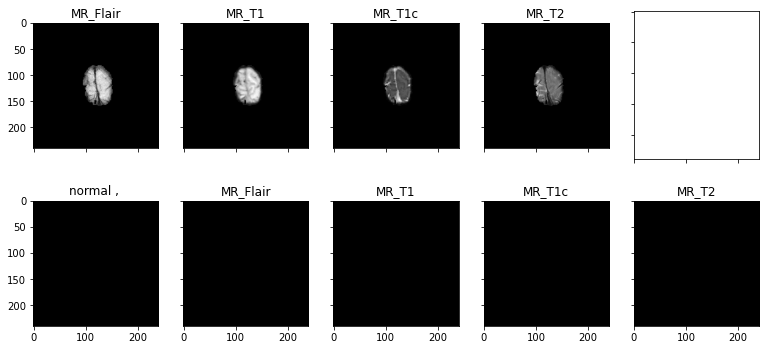

In [7]:
f, axes = plt.subplots(2,5,sharex=True,sharey=True)
f.set_size_inches((13,6))
for i in range(4):
    axes[0][i].imshow(return_label(img[i]),cmap ='gray')
    axes[1][i].imshow(return_label(label[i]),cmap ='gray')    
axes[1][4].imshow(return_label(label[4]),cmap='gray')
axes[0][0].set_title('MR_Flair')
axes[0][1].set_title('MR_T1')
axes[0][2].set_title('MR_T1c')
axes[0][3].set_title('MR_T2')
axes[1][0].set_title("normal , ")# 검은색부분이 0인 부분 
axes[1][1].set_title("MR_Flair")
axes[1][2].set_title("MR_T1")
axes[1][3].set_title("MR_T1c")
axes[1][4].set_title("MR_T2")

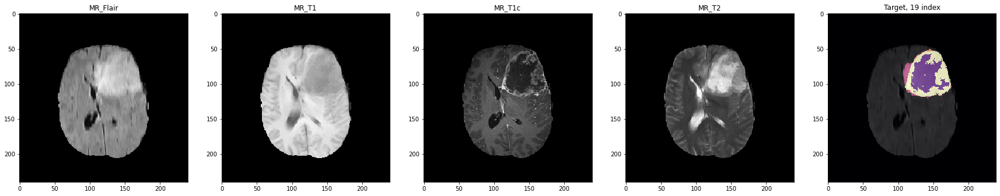

In [8]:
def imshow1(img):
    plt.imshow(img, cmap='gray',  interpolation='none')
def imshow2(mask):
    plt.imshow(mask, cmap=map_object, alpha=0.7,  interpolation='none')#target이 있는 부분을 출력하기 위해서 show하는 부분 

i=0
for img, label in train_loader:
    plt.figure(figsize=(30,30))
    plt.subplot(1,5,1)
    plt.title('MR_Flair')
    imshow1(img[0][0])
    plt.subplot(1,5,2)
    plt.title('MR_T1')
    imshow1(img[0][1])
    plt.subplot(1,5,3)
    plt.title('MR_T1c')
    imshow1(img[0][2])
    plt.subplot(1,5,4)
    plt.title('MR_T2')
    imshow1(img[0][3])
    plt.subplot(1,5,5)
    plt.title('Target, {} index'.format(i))
    imshow1(img[0][0])
    imshow2((label[0][1]+label[0][2]*2+label[0][3]*3+label[0][4]*4))
    
    plt.show()
    i+=1
    if i == 20:
        break
    clear_output(wait=True)

# Attention_Cell

In [9]:
class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()

        # number of input channels is a number of filters in the previous layer
        # number of output channels is a number of filters in the current layer
        # "same" convolutions
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x


class UpConv(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(UpConv, self).__init__()

        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.up(x)
        return x


class AttentionBlock(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(AttentionBlock, self).__init__()

        self.W_gate = nn.Sequential(#
            nn.Conv2d(F_g, n_coefficients, kernel_size=(1), stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )

        self.W_x = nn.Sequential( #
            nn.Conv2d(F_l, n_coefficients, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(n_coefficients, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        g1 = self.W_gate(gate) #gate로 부터 오는 matrix 
        x1 = self.W_x(skip_connection) # skip connection으로 부터 얻은 matrix  
        psi = self.relu(g1 + x1) # activation function use 
        psi = self.psi(psi) # gate value: scalar  
        out = skip_connection * psi
        return out
      
class Attention3D(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(Attention3D, self).__init__()

        self.W_gate = nn.Sequential(#
            nn.Conv3d(1,1, kernel_size=(1,1,1), stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1)
        )

        self.W_x = nn.Sequential( #
            nn.Conv3d(1, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1)
        )

        self.psi = nn.Sequential(
            nn.Conv3d(1, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        # print(gate.shape, skip_connection.shape)
        g1 = self.W_gate(gate.unsqueeze(1)) #gate로 부터 오는 matrix 
        x1 = self.W_x(skip_connection.unsqueeze(1)) # skip connection으로 부터 얻은 matrix  
        psi = self.relu(g1 + x1) # activation function use 
        psi = self.psi(psi) # gate value: scalar  
        out = skip_connection * psi.squeeze(1)
        return out

## Model 1 
### for detect the iamge pixel

In [10]:
class AttentionUNet_1(nn.Module):

    def __init__(self, img_ch=3, output_ch=1):
        super(AttentionUNet_1, self).__init__()

        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.Conv1 = ConvBlock(img_ch, 64)
        self.Conv2 = ConvBlock(64, 128)
        self.Conv3 = ConvBlock(128, 256)
        self.Conv4 = ConvBlock(256, 512)
        self.Conv5 = ConvBlock(512, 1024)

        self.Up5 = UpConv(1024, 512)
        self.Att5 = AttentionBlock(F_g=512, F_l=512, n_coefficients=256)
        # self.Att5 = Attention3D(F_g=512, F_l=512, n_coefficients=256)
        
        
        self.UpConv5 = ConvBlock(1024, 512)

        self.Up4 = UpConv(512, 256)
        self.Att4 = AttentionBlock(F_g=256, F_l=256, n_coefficients=128)
        # self.Att4 = Attention3D(F_g=256, F_l=256, n_coefficients=128)
        
        self.UpConv4 = ConvBlock(512, 256)

        self.Up3 = UpConv(256, 128)
        self.Att3 = AttentionBlock(F_g=128, F_l=128, n_coefficients=64)
        # self.Att3 = Attention3D(F_g=128, F_l=128, n_coefficients=64)
        
        self.UpConv3 = ConvBlock(256, 128)

        self.Up2 = UpConv(128, 64)
        self.Att2 = AttentionBlock(F_g=64, F_l=64, n_coefficients=32)
        # self.Att2 = Attention3D(F_g=64, F_l=64, n_coefficients=32)
        
        self.UpConv2 = ConvBlock(128, 64)

        self.Conv = nn.Conv2d(64, output_ch, kernel_size=1, stride=1, padding=0)
        # self.softmax = nn.Softmax(dim=1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        """
        e : encoder layers
        d : decoder layers
        s : skip-connections from encoder layers to decoder layers
        """
        e1 = self.Conv1(x)
        # print('e1:\t ',e1.shape)
        e2 = self.MaxPool(e1)
        e2 = self.Conv2(e2)
        # print('e2:\t ',e2.shape)

        e3 = self.MaxPool(e2)
        e3 = self.Conv3(e3)
        # print('e3:\t ',e3.shape)

        e4 = self.MaxPool(e3)
        e4 = self.Conv4(e4)
        # print('e4:\t ',e4.shape)

        e5 = self.MaxPool(e4)
        e5 = self.Conv5(e5)
        # print('e5:\t ',e5.shape)

        d5 = self.Up5(e5)
        # print('d5:\t ',d5.shape)
        
        s4 = self.Att5(gate=d5, skip_connection=e4)
        d5 = torch.cat((s4, d5), dim=1) # concatenate attention-weighted skip connection with previous layer output
        # print('d5 2: \t',d5.shape)
        d5 = self.UpConv5(d5)
        # print('s4,d5:\t ',s4.shape,d5.shape)
        d4 = self.Up4(d5)
        # print('d4:\t', d4.shape)
        s3 = self.Att4(gate=d4, skip_connection=e3)
        d4 = torch.cat((s3, d4), dim=1)
        d4 = self.UpConv4(d4)
        # print('s3,d4:\t ',s3.shape,d4.shape)

        d3 = self.Up3(d4)
        # print('d3:\t', d3.shape)
        
        s2 = self.Att3(gate=d3, skip_connection=e2)
        d3 = torch.cat((s2, d3), dim=1)
        d3 = self.UpConv3(d3)
        # print('s2,d3:\t ',s2.shape,d3.shape)

        d2 = self.Up2(d3)
        # print('d2:\t', d2.shape)
        
        s1 = self.Att2(gate=d2, skip_connection=e1)
        d2 = torch.cat((s1, d2), dim=1)
        d2 = self.UpConv2(d2)
        # print('s1,d2:\t ',s1.shape,d2.shape)

        out = self.Conv(d2)
        return self.sigmoid(out)


## Model 2 
### for detect the tumor

In [11]:
class AttentionUNet_2(nn.Module):

    def __init__(self, img_ch=3, output_ch=1):
        super(AttentionUNet_2, self).__init__()

        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.Conv1 = ConvBlock(img_ch, 64)
        self.Conv2 = ConvBlock(64, 128)
        self.Conv3 = ConvBlock(128, 256)
        self.Conv4 = ConvBlock(256, 512)
        self.Conv5 = ConvBlock(512, 1024)

        self.Up5 = UpConv(1024, 512)
        self.Att5 = AttentionBlock(F_g=512, F_l=512, n_coefficients=256)
        # self.Att5 = Attention3D(F_g=512, F_l=512, n_coefficients=256)
        
        
        self.UpConv5 = ConvBlock(1024, 512)

        self.Up4 = UpConv(512, 256)
        self.Att4 = AttentionBlock(F_g=256, F_l=256, n_coefficients=128)
        # self.Att4 = Attention3D(F_g=256, F_l=256, n_coefficients=128)
        
        self.UpConv4 = ConvBlock(512, 256)

        self.Up3 = UpConv(256, 128)
        self.Att3 = AttentionBlock(F_g=128, F_l=128, n_coefficients=64)
        # self.Att3 = Attention3D(F_g=128, F_l=128, n_coefficients=64)
        
        self.UpConv3 = ConvBlock(256, 128)

        self.Up2 = UpConv(128, 64)
        self.Att2 = AttentionBlock(F_g=64, F_l=64, n_coefficients=32)
        # self.Att2 = Attention3D(F_g=64, F_l=64, n_coefficients=32)
        
        self.UpConv2 = ConvBlock(128, 64)

        self.Conv = nn.Conv2d(64, output_ch, kernel_size=1, stride=1, padding=0)
        self.softmax = nn.Softmax(dim=1)
    def forward(self, x):
        """
        e : encoder layers
        d : decoder layers
        s : skip-connections from encoder layers to decoder layers
        """
        e1 = self.Conv1(x)
        # print('e1:\t ',e1.shape)
        e2 = self.MaxPool(e1)
        e2 = self.Conv2(e2)
        # print('e2:\t ',e2.shape)

        e3 = self.MaxPool(e2)
        e3 = self.Conv3(e3)
        # print('e3:\t ',e3.shape)

        e4 = self.MaxPool(e3)
        e4 = self.Conv4(e4)
        # print('e4:\t ',e4.shape)

        e5 = self.MaxPool(e4)
        e5 = self.Conv5(e5)
        # print('e5:\t ',e5.shape)

        d5 = self.Up5(e5)
        # print('d5:\t ',d5.shape)
        
        s4 = self.Att5(gate=d5, skip_connection=e4)
        d5 = torch.cat((s4, d5), dim=1) # concatenate attention-weighted skip connection with previous layer output
        # print('d5 2: \t',d5.shape)
        d5 = self.UpConv5(d5)
        # print('s4,d5:\t ',s4.shape,d5.shape)
        d4 = self.Up4(d5)
        # print('d4:\t', d4.shape)
        s3 = self.Att4(gate=d4, skip_connection=e3)
        d4 = torch.cat((s3, d4), dim=1)
        d4 = self.UpConv4(d4)
        # print('s3,d4:\t ',s3.shape,d4.shape)

        d3 = self.Up3(d4)
        # print('d3:\t', d3.shape)
        
        s2 = self.Att3(gate=d3, skip_connection=e2)
        d3 = torch.cat((s2, d3), dim=1)
        d3 = self.UpConv3(d3)
        # print('s2,d3:\t ',s2.shape,d3.shape)

        d2 = self.Up2(d3)
        # print('d2:\t', d2.shape)
        
        s1 = self.Att2(gate=d2, skip_connection=e1)
        d2 = torch.cat((s1, d2), dim=1)
        d2 = self.UpConv2(d2)
        # print('s1,d2:\t ',s1.shape,d2.shape)

        out = self.Conv(d2)

        return self.softmax(out)
        # return out

In [12]:
# class FocalLoss(nn.modules.loss._WeightedLoss):

#     def __init__(self, gamma=0, size_average=None, ignore_index=-100,
#                  reduce=None, balance_param=1.0):
#         super(FocalLoss, self).__init__(size_average)
#         self.gamma = gamma
#         self.size_average = size_average
#         self.ignore_index = ignore_index
#         self.balance_param = balance_param

#     def forward(self, input, target):
        
#         # inputs and targets are assumed to be BatchxClasses
#         assert len(input.shape) == len(target.shape) #같지 않은경우는 assert처리시킴 
#         assert input.size(0) == target.size(0)
#         assert input.size(1) == target.size(1)
           
#         # compute the negative likelyhood
#         logpt = - F.binary_cross_entropy_with_logits(input, target)
#         pt = torch.exp(logpt)

#         # compute the loss
#         focal_loss = -( (1-pt)**self.gamma ) * logpt
#         balanced_focal_loss = self.balance_param * focal_loss
#         return balanced_focal_losssigmoid

In [12]:
def imshow1(img):
    plt.imshow(img, cmap='gray',  interpolation='none')
    
def imshow2(mask):
    plt.imshow(mask, cmap=map_object, alpha=0.7,  interpolation='none')#target이 있는 부분을 출력하기 위해서 show하는 부분 


def threshold_img(output, threshold =0.5):
    output2 = output.clone()
    output2[output2>=threshold] = 1
    output2[output2<threshold] = 0
    return output2
    
def Bimshow(img,i):
    plt.imshow(img, cmap=map_object, alpha=0.4)  
    plt.axis('off')
    plt.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

def Bimshow_2(original, label,param,i):
    f , (ax1,ax2) = plt.subplots(1,2,figsize = (10,15))
    ax1.imshow(original, cmap='gray',  interpolation='none')
    ax1.imshow(label, cmap=map_object, alpha=0.4)  
    
    ax1.axis('off')
    ax1.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

    ax2.imshow(original, cmap='gray',  interpolation='none')
    ax2.imshow(param, cmap=map_object, alpha=0.4)  

    ax2.axis('off')
   
    ax2.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

### for picture - 1

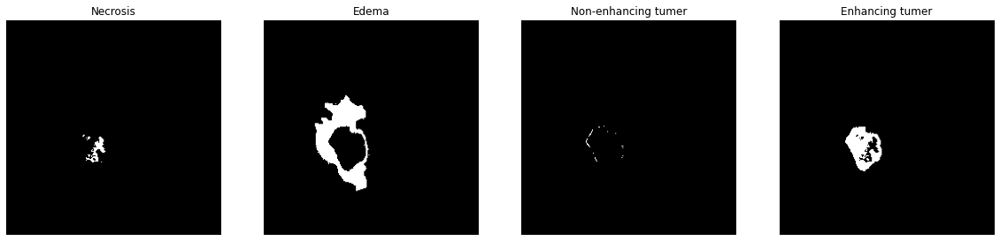

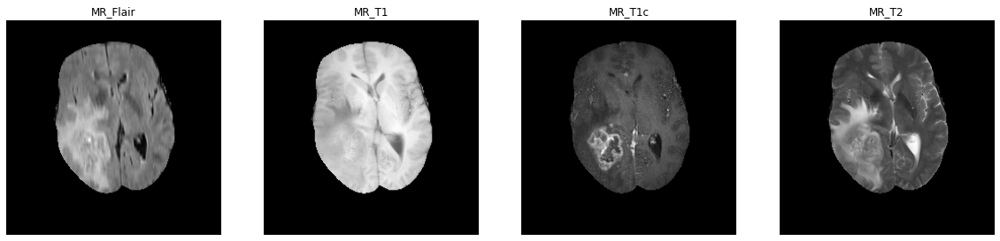

In [13]:


# index= np.random.randint(1,3724)
index= 1324
MR_Flair = Image.open(f"./BRATS_Padding/label/1/{index}.png").convert('L')
MR_T1 = Image.open(f"./BRATS_Padding/label/2/{index}.png").convert('L')
MR_T1c = Image.open(f"./BRATS_Padding/label/3/{index}.png").convert('L')
MR_T2 = Image.open(f"./BRATS_Padding/label/4/{index}.png").convert('L')
trans = transforms.Compose([transforms.ToTensor()])
MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
pltlabel = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1).unsqueeze(0)
pltlabel = pltlabel.to(device)
img = [MR_Flair, MR_T1, MR_T1c, MR_T2]
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,sharex=True,figsize=(20,6))
# img = data[126,:,:]
ax1.imshow(img[0].permute(1,2,0),cmap='gray')

ax2.imshow(img[1].permute(1,2,0),cmap='gray')
ax3.imshow(img[2].permute(1,2,0),cmap='gray')
ax4.imshow(img[3].permute(1,2,0),cmap='gray')
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')
ax1.set_title('Necrosis')
ax2.set_title('Edema')
ax3.set_title('Non-enhancing tumer')
ax4.set_title('Enhancing tumer')

MR_Flair = Image.open(f"./BRATS_Padding/image/MR_Flair/{index}.png").convert('L')
MR_T1 = Image.open(f"./BRATS_Padding/image/MR_T1/{index}.png").convert('L')
MR_T1c = Image.open(f"./BRATS_Padding/image/MR_T1c/{index}.png").convert('L')
MR_T2 = Image.open(f"./BRATS_Padding/image/MR_T2/{index}.png").convert('L')
trans = transforms.Compose([transforms.ToTensor()])
MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
pltimage = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1).unsqueeze(0)
pltimage = pltimage.to(device)
img = [MR_Flair, MR_T1, MR_T1c, MR_T2]

f, (ax5,ax6,ax7,ax8) = plt.subplots(1,4,sharex=True,figsize=(20,6))
# img = data[126,:,:]
ax5.imshow(img[0].permute(1,2,0),cmap='gray')
ax6.imshow(img[1].permute(1,2,0),cmap='gray')
ax7.imshow(img[2].permute(1,2,0),cmap='gray')
ax8.imshow(img[3].permute(1,2,0),cmap='gray')

ax5.set_title('MR_Flair')
ax6.set_title('MR_T1')
ax7.set_title('MR_T1c')
ax8.set_title('MR_T2')

ax5.axis('off')
ax6.axis('off')

ax7.axis('off')

ax8.axis('off')

plt.show()


In [20]:
num_epoch = 200
learning_rate = 1e-2

model_1 = AttentionUNet_1(4, 1).to(device)
optimizer_1 = torch.optim.AdamW(model_1.parameters(), lr=learning_rate)
scheduler_1 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_1,mode='min',patience=20)
save_1 = '2_case_unet_ver_1'


model_2 = AttentionUNet_2(4,5).to(device)
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=20)
save_2 = '2_case_unet_ver_2'

loss_func = torch.nn.BCELoss().to(device)
# loss_func_2 = torch.nn.CrossEntropyLoss().to(device)
model_1,model_2 = model_1.to(device), model_2.to(device)
    
plt2 = pltlabel[0].detach().cpu().numpy()
plt1 = pltimage[0][0].detach().cpu().numpy()
show_label = plt2[0]+plt2[1]*2+plt2[2]*3+plt2[3]*4
# model

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 1 : train_loss : 0.05552206281364231, valid_loss : 0.028362263211195286


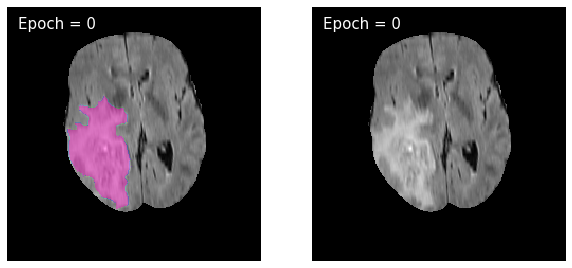

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 1 : train_loss : 0.01669300199950935, valid_loss : 0.018423686686307315


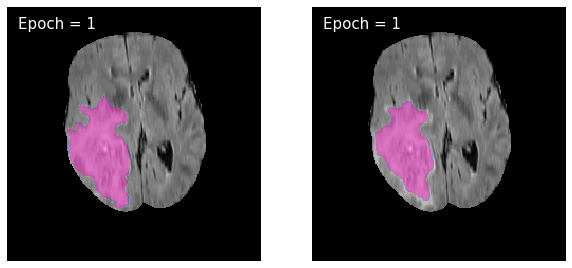

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 1 : train_loss : 0.01356441152836269, valid_loss : 0.010988742449782915


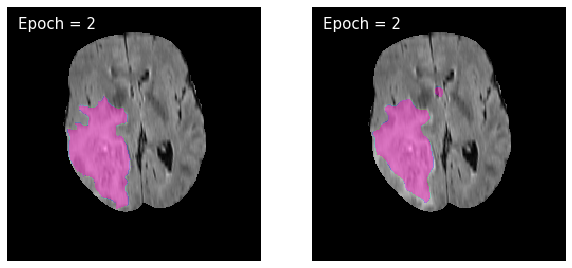

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 1 : train_loss : 0.011646763357397385, valid_loss : 0.015147428110232931


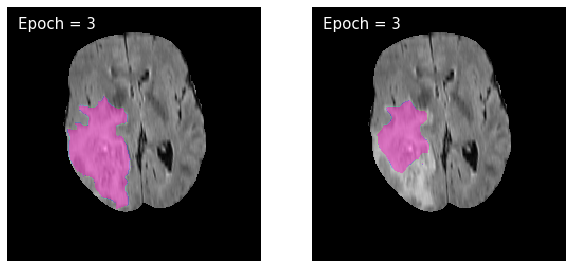

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 1 : train_loss : 0.010665124802854354, valid_loss : 0.0102094461656986


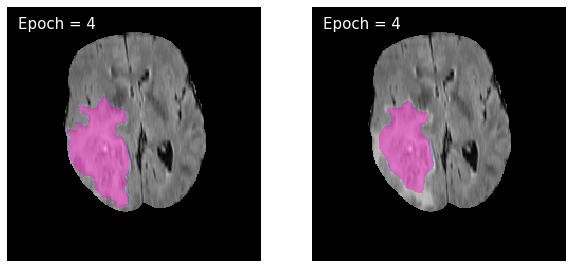

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 1 : train_loss : 0.009769980648925248, valid_loss : 0.009054148913149816


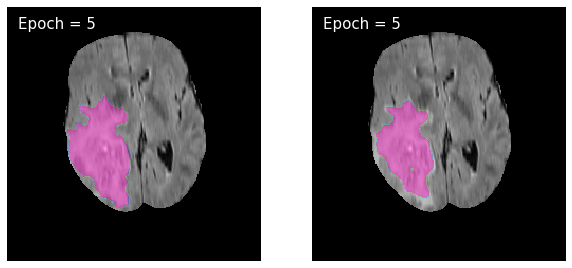

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 1 : train_loss : 0.008902903632167102, valid_loss : 0.00834215719624143


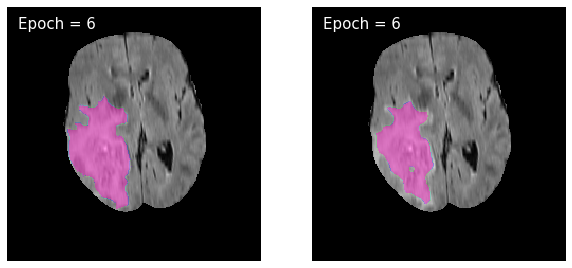

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 1 : train_loss : 0.008035424597232168, valid_loss : 0.007354133043092041


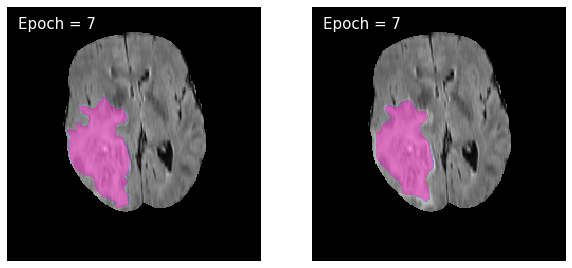

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 1 : train_loss : 0.007452846336766027, valid_loss : 0.009250805715687323


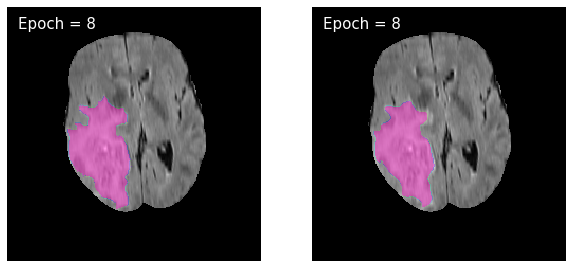

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 1 : train_loss : 0.007901777136733368, valid_loss : 0.021139113553722895


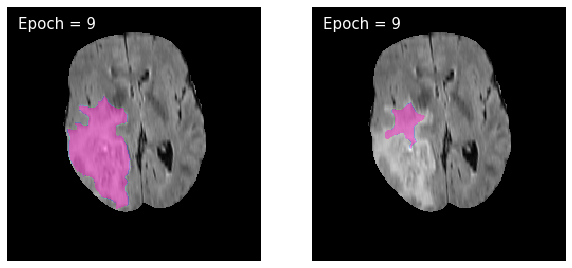

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 1 : train_loss : 0.007488580256407785, valid_loss : 0.006602414382555057


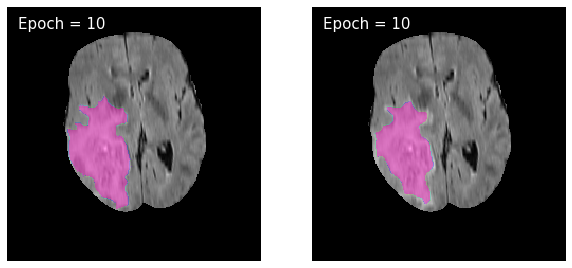

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 1 : train_loss : 0.007361101253092043, valid_loss : 0.008291548363876666


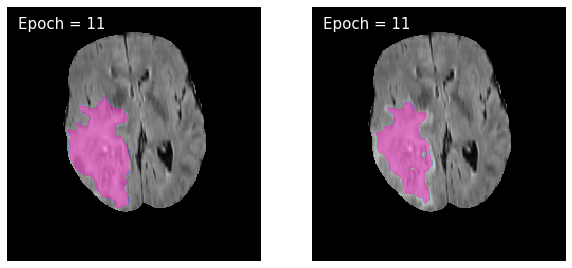

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 1 : train_loss : 0.007055387094406457, valid_loss : 0.006080043763019862


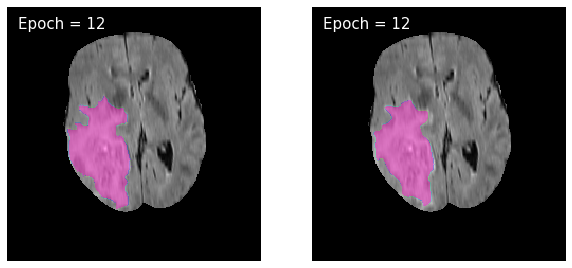

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 1 : train_loss : 0.00585339973436906, valid_loss : 0.0070129385149843935


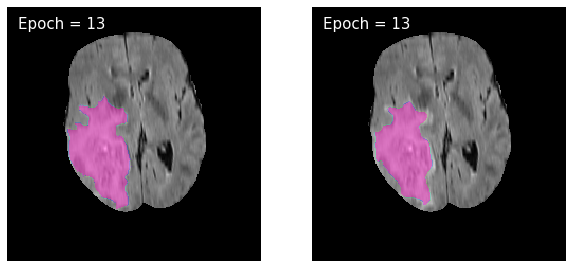

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 1 : train_loss : 0.006829020689969249, valid_loss : 0.006436586256760405


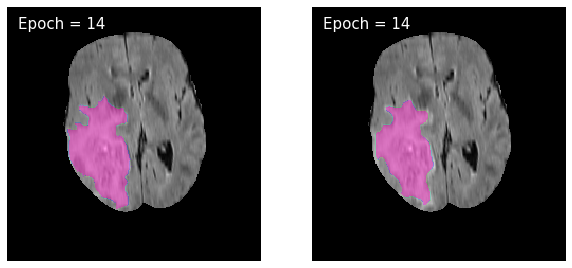

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 1 : train_loss : 0.006966863219366853, valid_loss : 0.005820722179383012


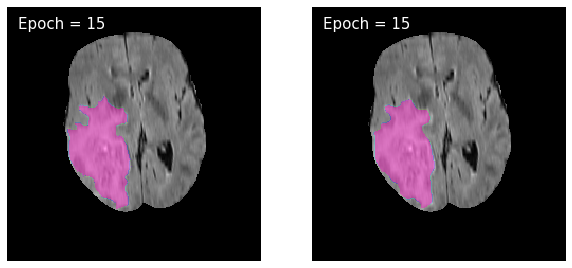

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 1 : train_loss : 0.00558464487865674, valid_loss : 0.006836093313095702


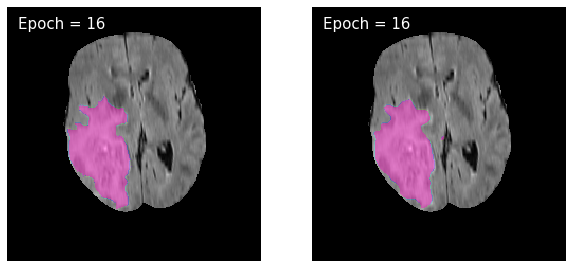

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 1 : train_loss : 0.006179138593806966, valid_loss : 0.0045207561748191105


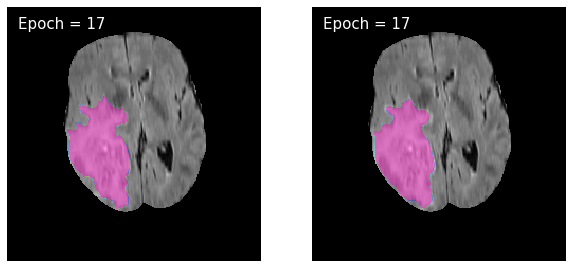

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 1 : train_loss : 0.005173398105097388, valid_loss : 0.004962509720669875


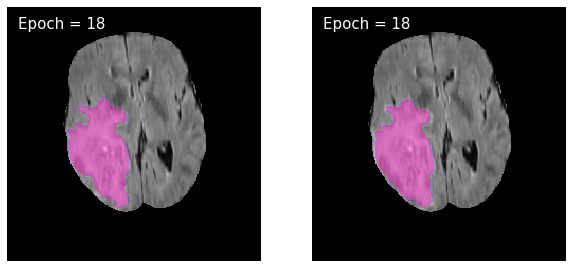

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 1 : train_loss : 0.005029692042408557, valid_loss : 0.004548136169813016


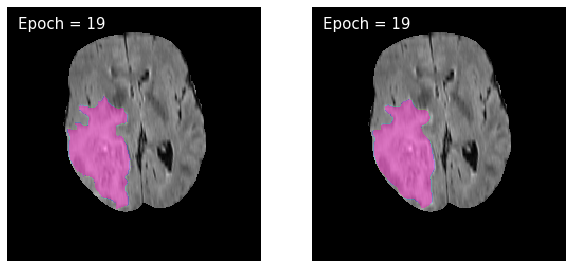

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 1 : train_loss : 0.004967999170061359, valid_loss : 0.0044758147976813965


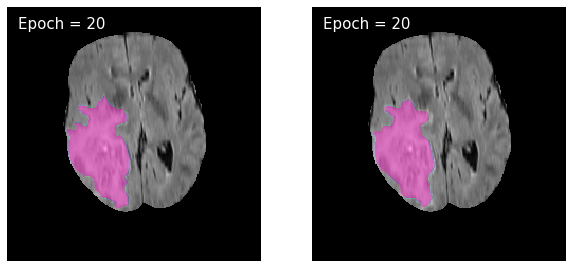

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 1 : train_loss : 0.006862417560891651, valid_loss : 0.007302955008456945


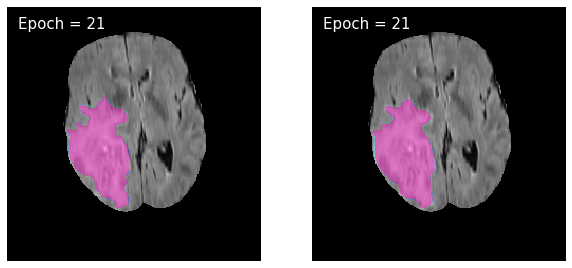

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 1 : train_loss : 0.005424126350868835, valid_loss : 0.006483770044380108


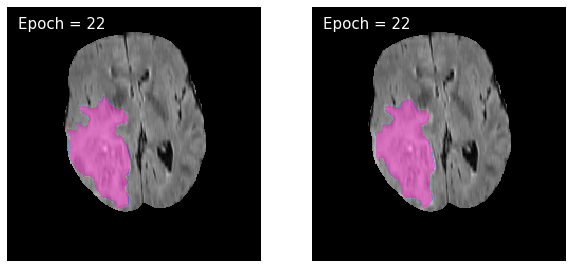

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 1 : train_loss : 0.00504148015775874, valid_loss : 0.004089691739450881


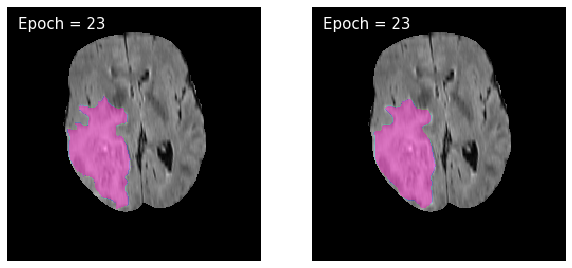

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 1 : train_loss : 0.004769121435207447, valid_loss : 0.008946452729245016


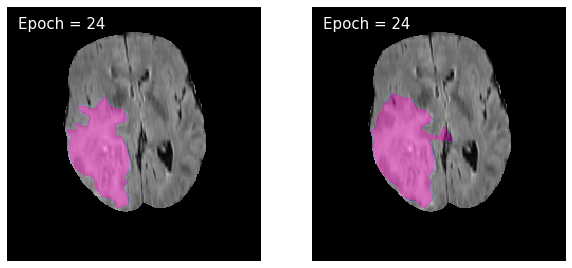

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 1 : train_loss : 0.004936010910908955, valid_loss : 0.0043559519552350285


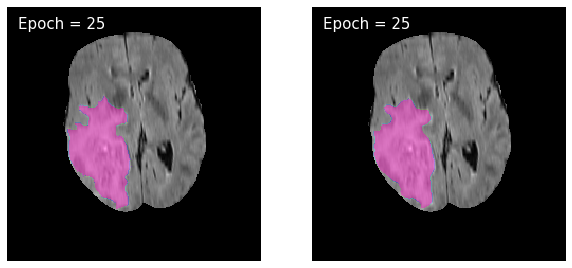

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 1 : train_loss : 0.00405434174006086, valid_loss : 0.00425536338477081


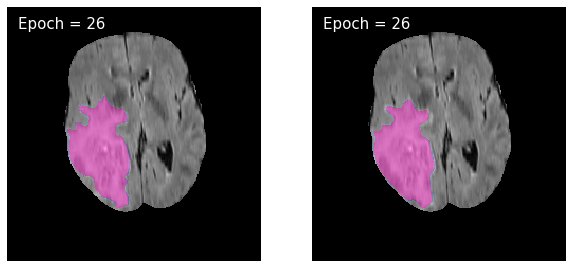

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 1 : train_loss : 0.003947296673529982, valid_loss : 0.00391599393117609


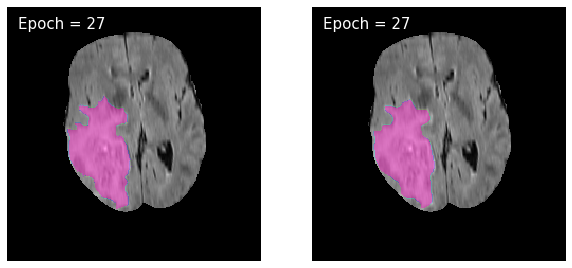

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 1 : train_loss : 0.0038898948243607182, valid_loss : 0.005244479855745552


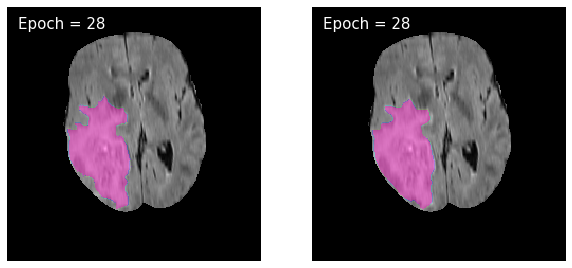

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 1 : train_loss : 0.005555367627296617, valid_loss : 0.0038265919408037685


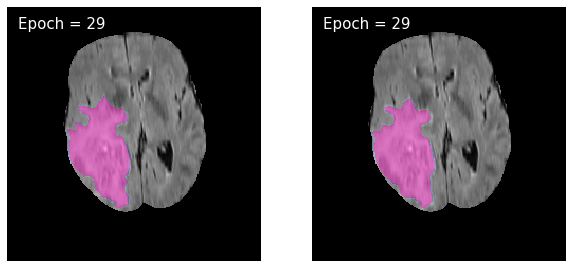

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 1 : train_loss : 0.0038777749620974938, valid_loss : 0.003558181011591673


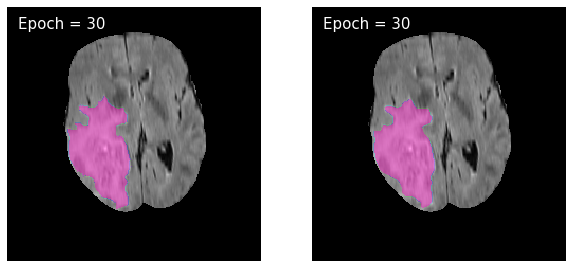

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 1 : train_loss : 0.0035980894822377025, valid_loss : 0.0035513967331234986


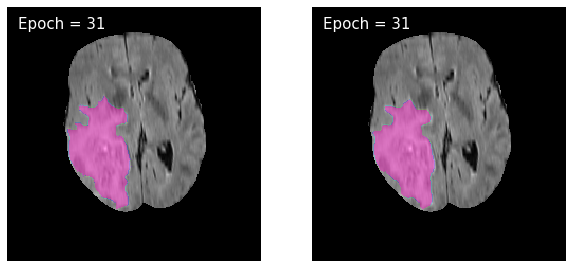

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 1 : train_loss : 0.00400631434699515, valid_loss : 0.0058881140480211164


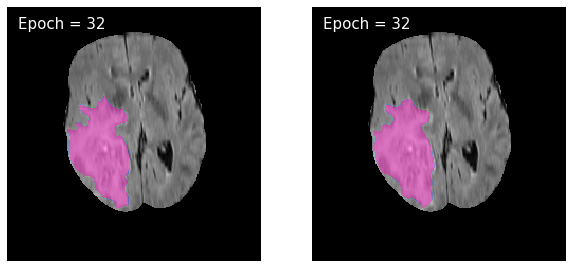

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 1 : train_loss : 0.004025294253854857, valid_loss : 0.005303212578749381


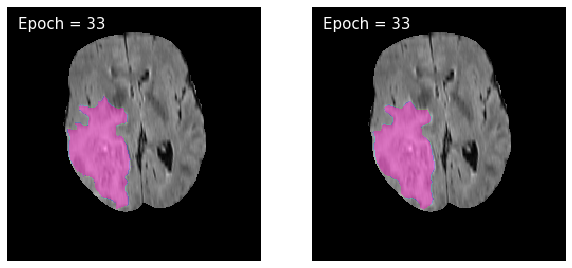

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 1 : train_loss : 0.004194280406036891, valid_loss : 0.004100346689286745


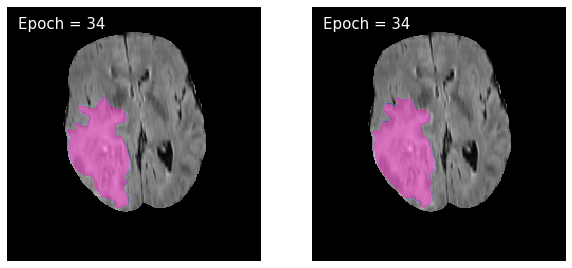

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 1 : train_loss : 0.0034547743294056, valid_loss : 0.003287201409462522


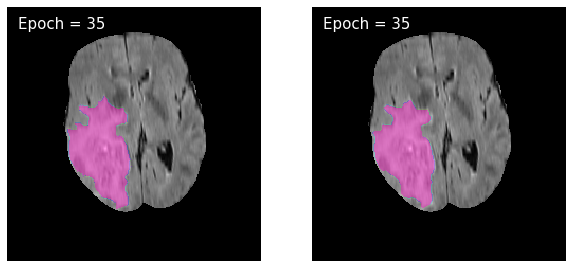

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 1 : train_loss : 0.0036516690735912375, valid_loss : 0.08554757497447336


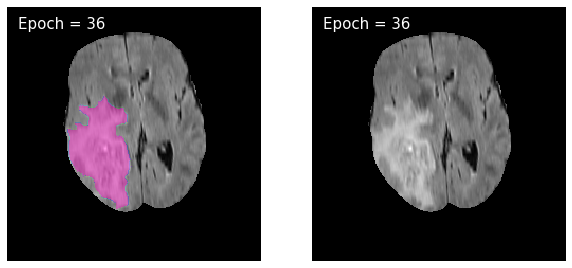

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 1 : train_loss : 0.004214409504774423, valid_loss : 0.00467954398483818


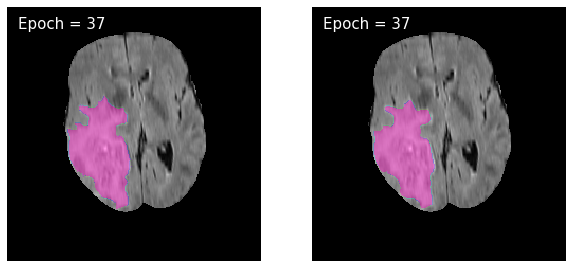

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 1 : train_loss : 0.003145315947816238, valid_loss : 0.0030747147270860312


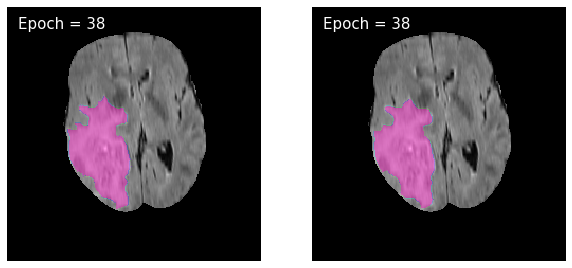

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 1 : train_loss : 0.003936721327190102, valid_loss : 0.003156379850846988


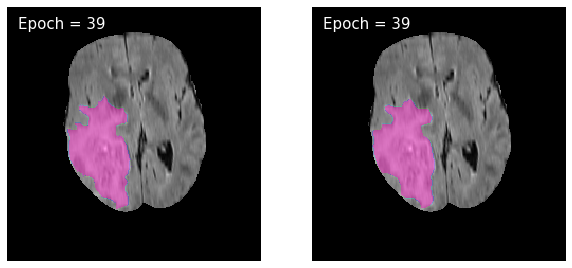

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 1 : train_loss : 0.0031196911902065592, valid_loss : 0.0030581266935363386


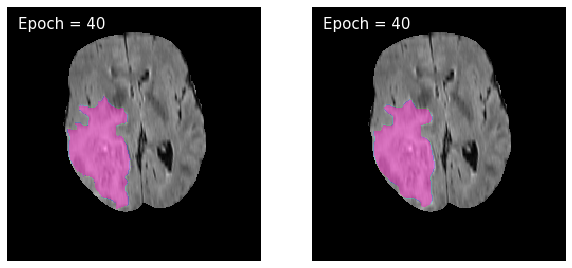

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 1 : train_loss : 0.0030621392170604353, valid_loss : 0.002990963453113128


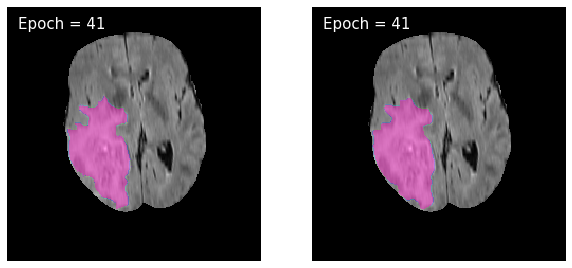

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 1 : train_loss : 0.0030825130086107083, valid_loss : 0.0032272169752177713


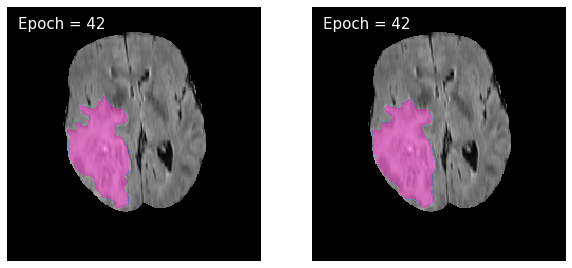

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 1 : train_loss : 0.0029192483209931554, valid_loss : 0.007511701292979604


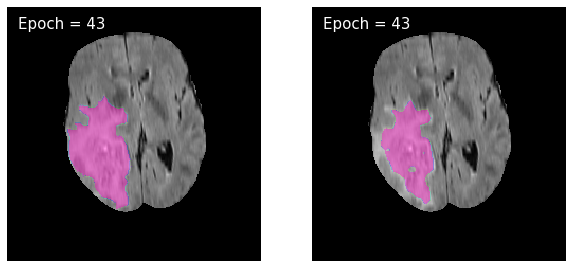

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 1 : train_loss : 0.0030016259684058646, valid_loss : 0.002879707117413225


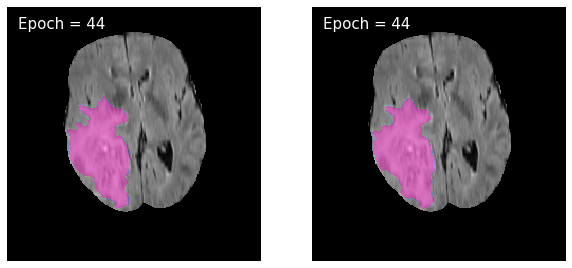

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 1 : train_loss : 0.0028269202219100725, valid_loss : 0.008175438087345287


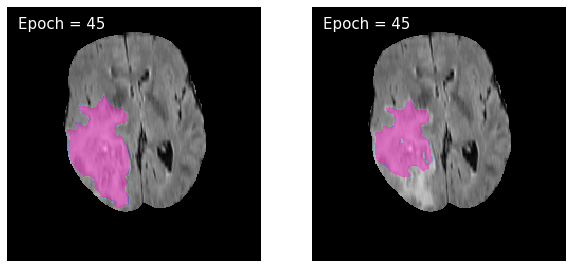

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 1 : train_loss : 0.012421463749666283, valid_loss : 0.00936884941345715


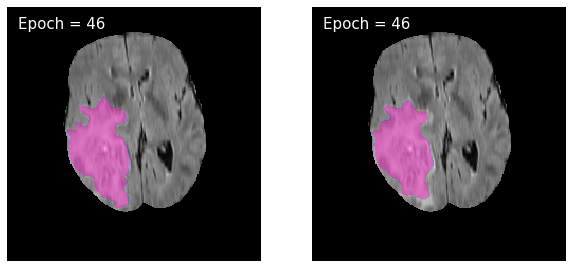

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 1 : train_loss : 0.006406855698616579, valid_loss : 0.004445027837593238


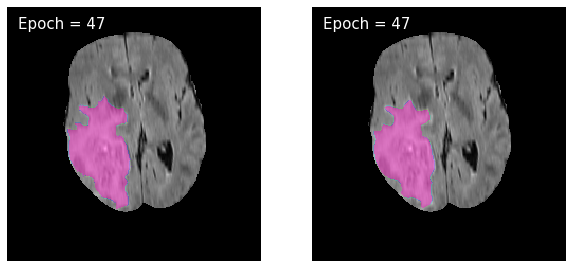

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 1 : train_loss : 0.0040592108859102555, valid_loss : 0.003873237422116243


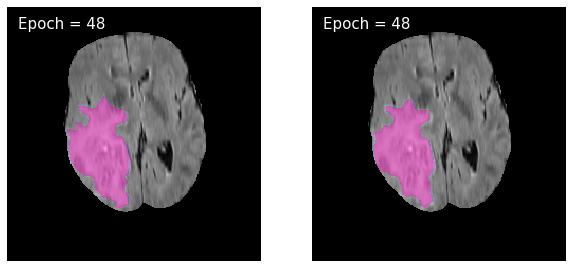

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 1 : train_loss : 0.0032070757726240452, valid_loss : 0.0031771197270489345


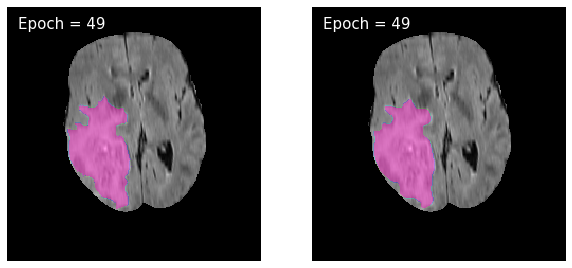

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 1 : train_loss : 0.003105975953558483, valid_loss : 0.003069628524912334


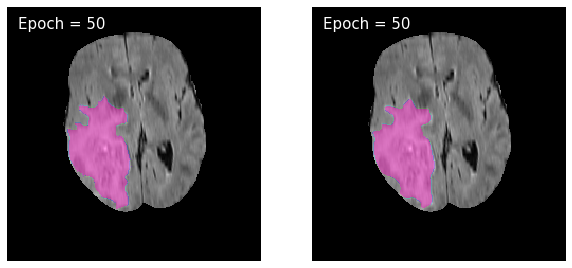

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 1 : train_loss : 0.002822098963034117, valid_loss : 0.0030429401838616087


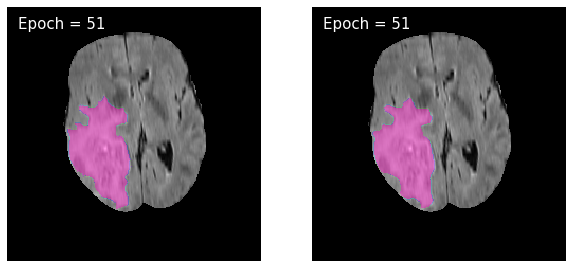

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 1 : train_loss : 0.0025759457910444774, valid_loss : 0.002802311558901058


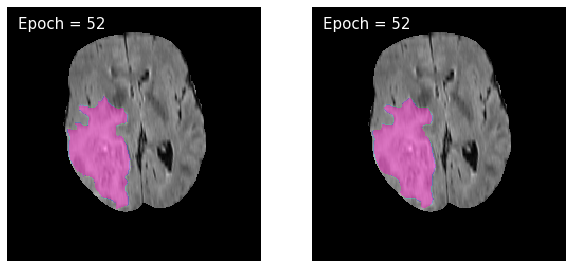

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 1 : train_loss : 0.0025671005098710617, valid_loss : 0.0027831894900666


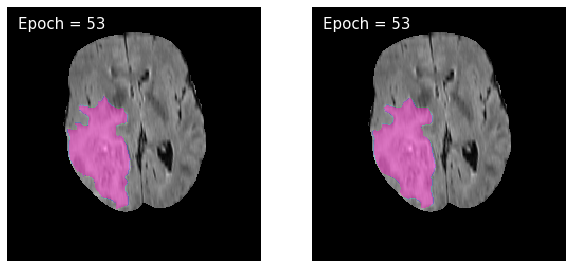

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 1 : train_loss : 0.0036512841423253983, valid_loss : 0.0034401421768111675


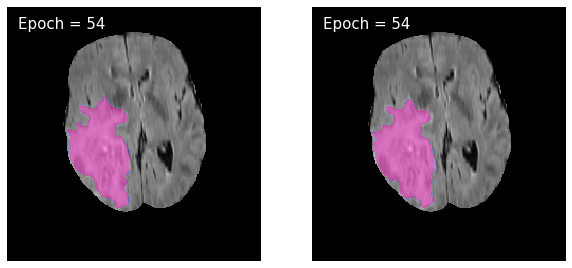

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 1 : train_loss : 0.002718408663201568, valid_loss : 0.0029693334504475757


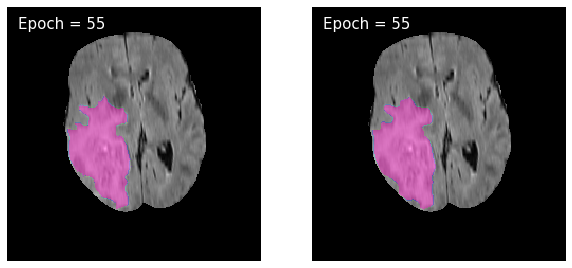

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 1 : train_loss : 0.002561602759710461, valid_loss : 0.005050049276138359


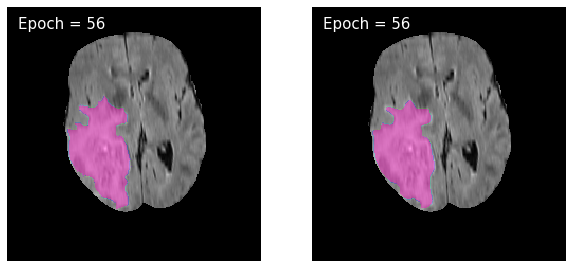

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 1 : train_loss : 0.0027199628665070127, valid_loss : 0.0028612876245121405


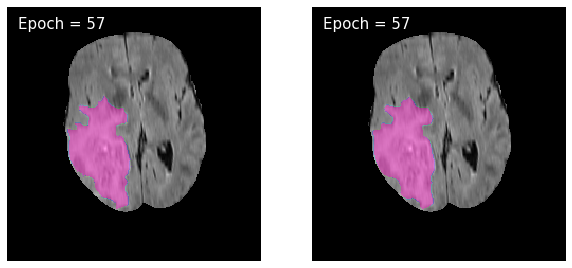

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 1 : train_loss : 0.0054374872366141315, valid_loss : 0.0056058995801921445


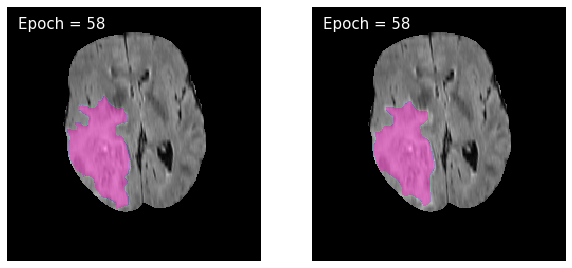

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 1 : train_loss : 0.003215561863227687, valid_loss : 0.0028315285518524117


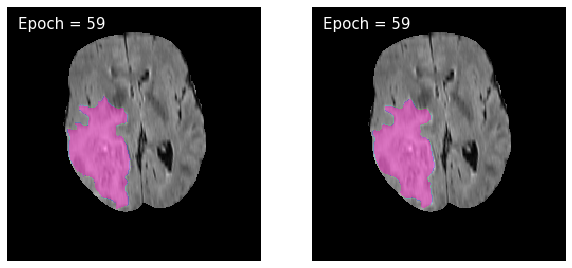

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 1 : train_loss : 0.0025006783664232816, valid_loss : 0.0028331028336570276


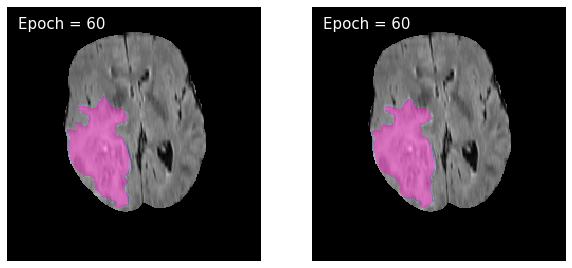

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 1 : train_loss : 0.0023468282334390862, valid_loss : 0.0025568987946292176


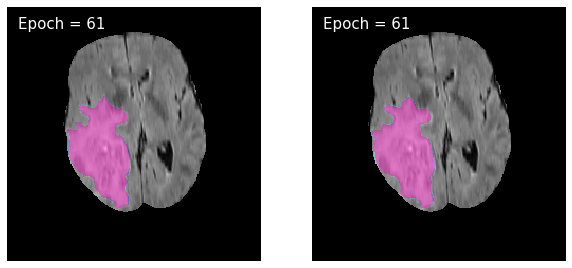

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 1 : train_loss : 0.002720383309096233, valid_loss : 0.0028914706580280836


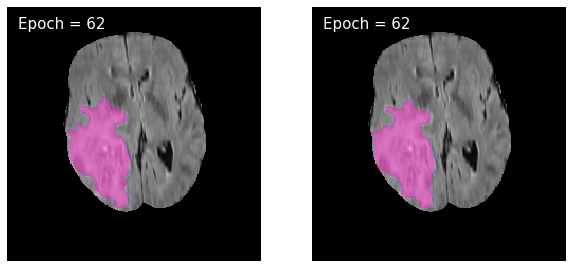

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 1 : train_loss : 0.0025026101177933846, valid_loss : 0.0026278116568915055


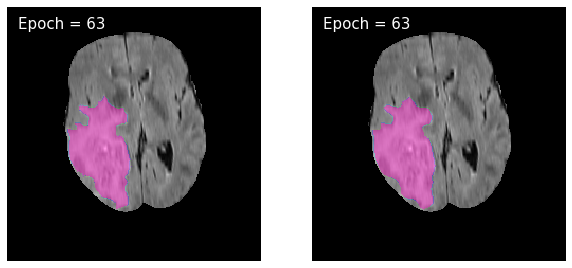

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 1 : train_loss : 0.0024688935509036415, valid_loss : 0.002532689304500048


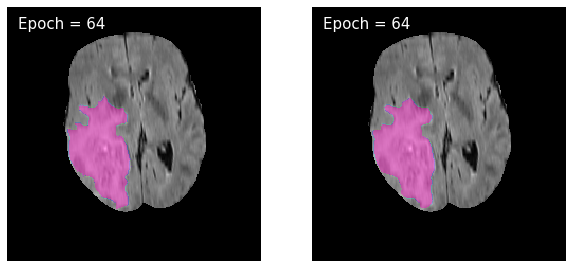

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 1 : train_loss : 0.002203146827997022, valid_loss : 0.0025410454049830085


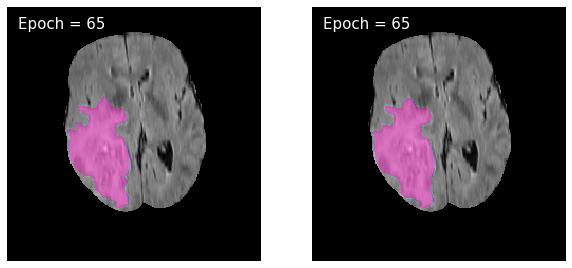

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 1 : train_loss : 0.0022122718061635643, valid_loss : 0.0026961048649065365


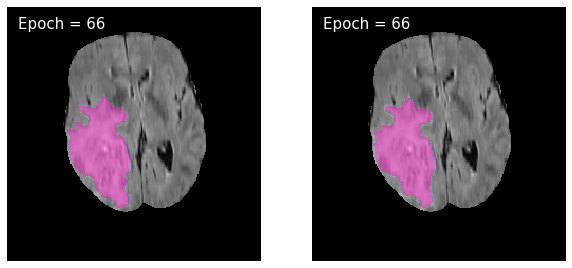

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 1 : train_loss : 0.0025033512292361236, valid_loss : 0.0048577230049091985


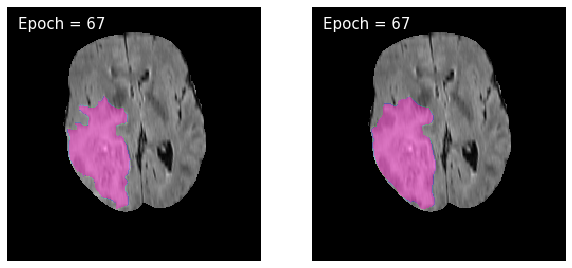

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 1 : train_loss : 0.0030010893761018595, valid_loss : 0.0025791699707549396


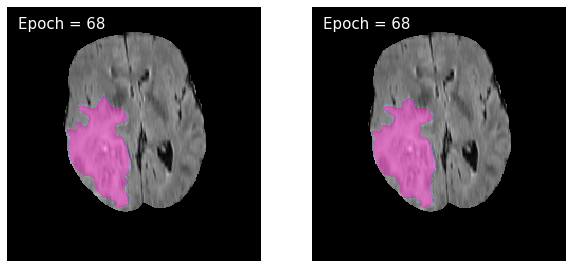

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 1 : train_loss : 0.0023125508865890474, valid_loss : 0.0026960976644124193


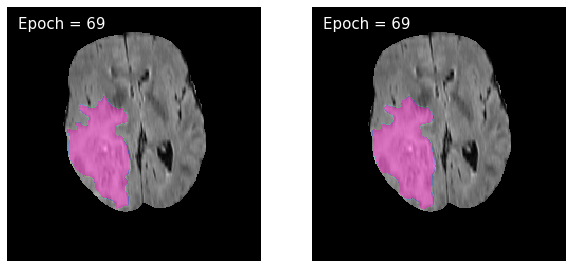

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 1 : train_loss : 0.002543264758066717, valid_loss : 0.0028999746152930978


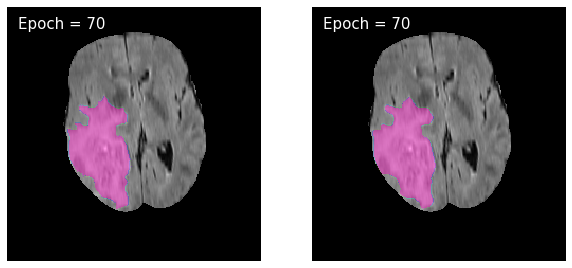

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 1 : train_loss : 0.002262742011463838, valid_loss : 0.0027326792675432163


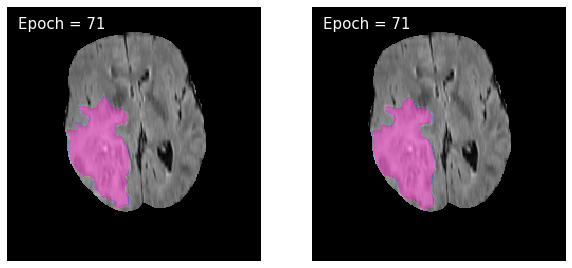

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 1 : train_loss : 0.002235995347484757, valid_loss : 0.002910943945166836


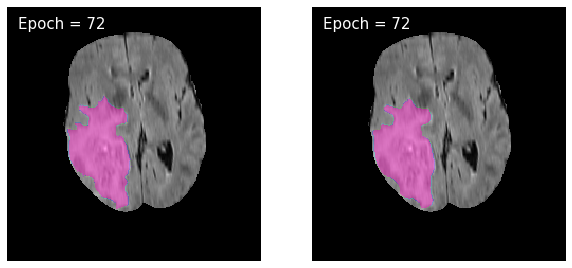

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 1 : train_loss : 0.0021461302291766898, valid_loss : 0.0024308534582801757


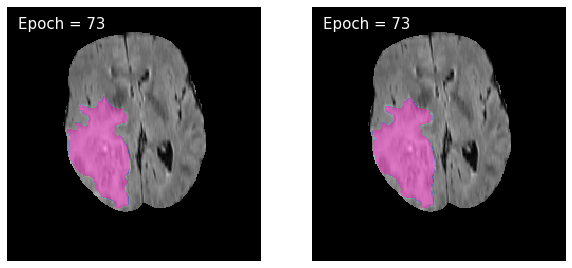

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 1 : train_loss : 0.0021218478314950625, valid_loss : 0.0028391971607700473


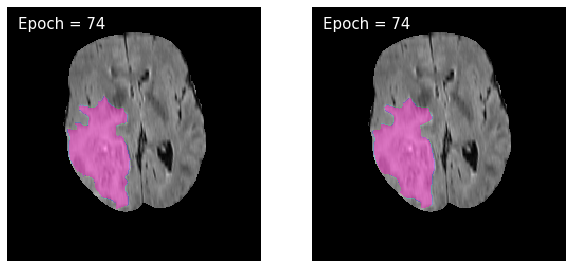

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 1 : train_loss : 0.0021413273526353035, valid_loss : 0.0026733091677284644


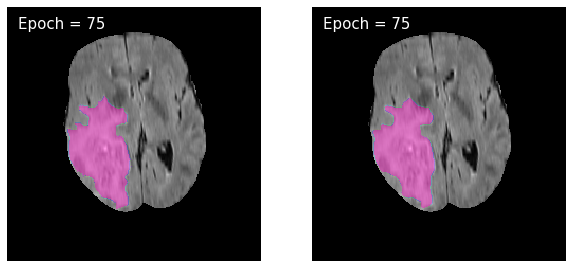

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 1 : train_loss : 0.0020486414124440662, valid_loss : 0.0026110392512687635


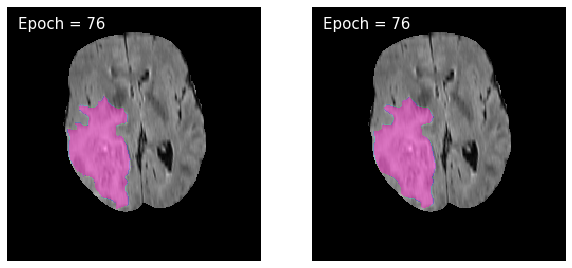

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 1 : train_loss : 0.005581733555707043, valid_loss : 0.0035823730966620484


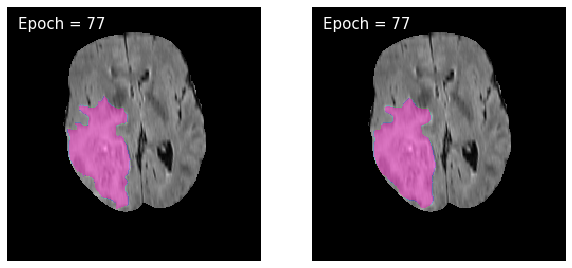

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 1 : train_loss : 0.002741403266660501, valid_loss : 0.002669940927825675


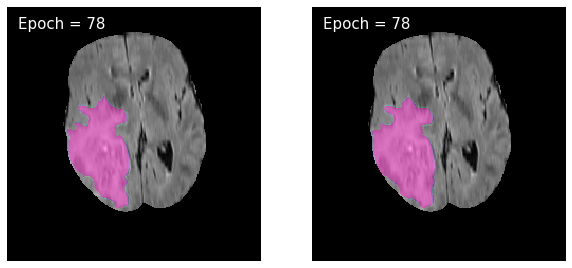

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 1 : train_loss : 0.0021256069371977005, valid_loss : 0.002425246319077166


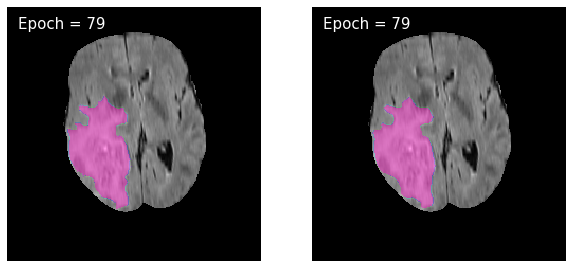

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 81: model 1 : train_loss : 0.001957322821121332, valid_loss : 0.002360448820682267


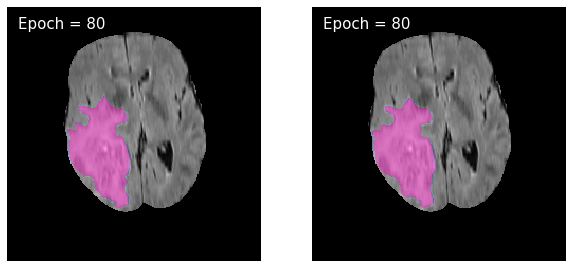

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 82: model 1 : train_loss : 0.002007534383315226, valid_loss : 0.002327902935602807


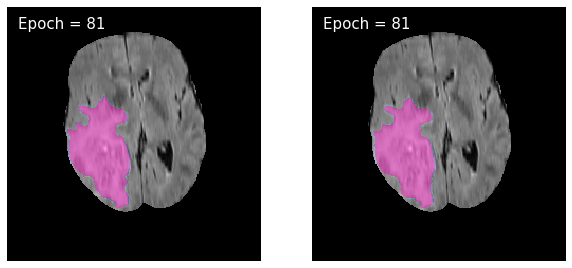

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 83: model 1 : train_loss : 0.0018943612521288172, valid_loss : 0.0025958202380723053


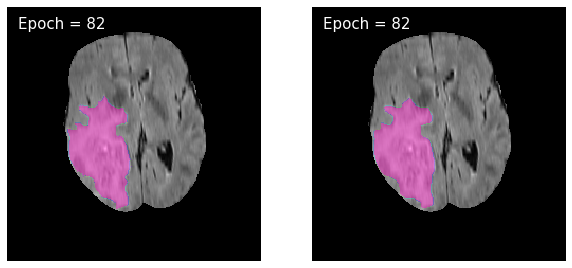

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 84: model 1 : train_loss : 0.0019306120222303317, valid_loss : 0.0023714926689448078


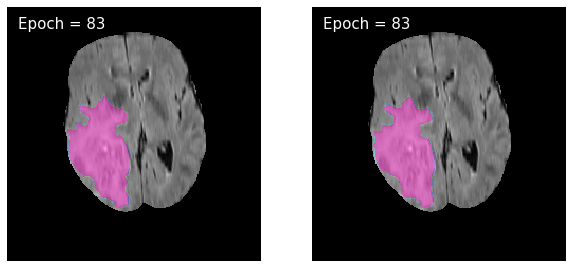

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 85: model 1 : train_loss : 0.002012626434911227, valid_loss : 0.002561938549297212


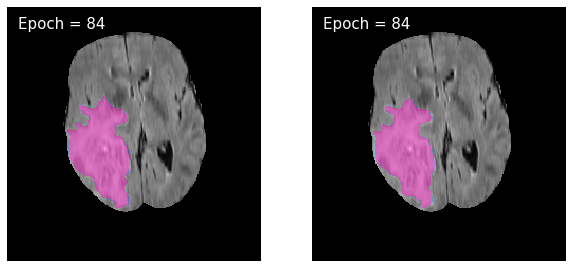

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 86: model 1 : train_loss : 0.0019292476863926437, valid_loss : 0.0023198353790153943


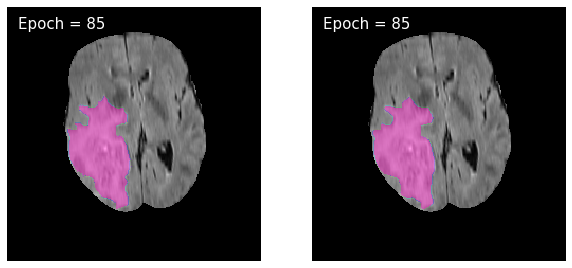

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 87: model 1 : train_loss : 0.0023368978074655954, valid_loss : 0.003581043520070915


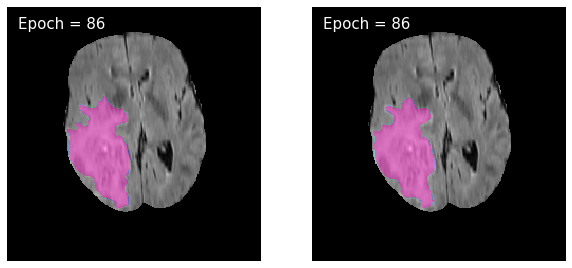

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 88: model 1 : train_loss : 0.00214480561640747, valid_loss : 0.002554715847315821


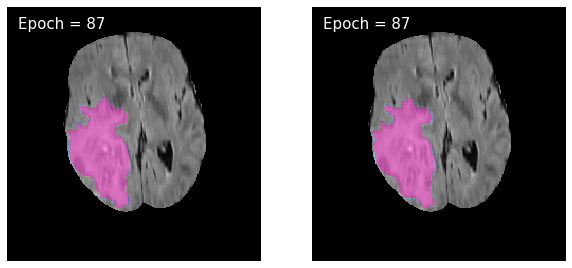

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 89: model 1 : train_loss : 0.0021821918674136283, valid_loss : 0.0025408402119193787


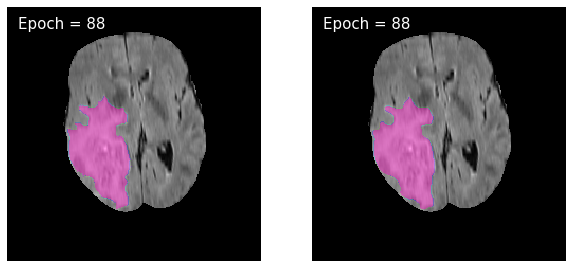

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 90: model 1 : train_loss : 0.001926619750703705, valid_loss : 0.002502377898841368


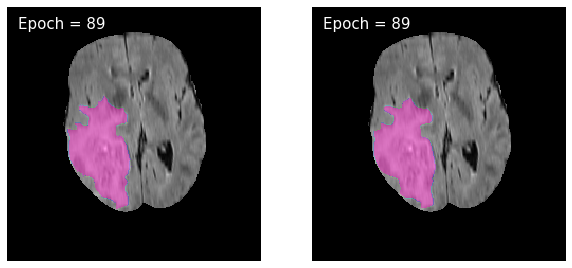

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 91: model 1 : train_loss : 0.001961208473635991, valid_loss : 0.0023710254339558245


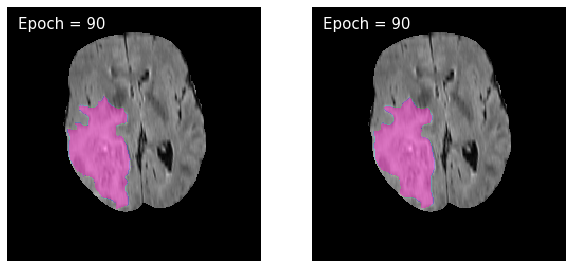

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 92: model 1 : train_loss : 0.0018184074557344987, valid_loss : 0.0024836513808397147


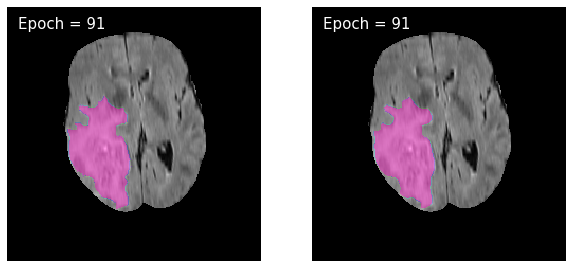

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 93: model 1 : train_loss : 0.0018866915215502715, valid_loss : 0.0023388342383694805


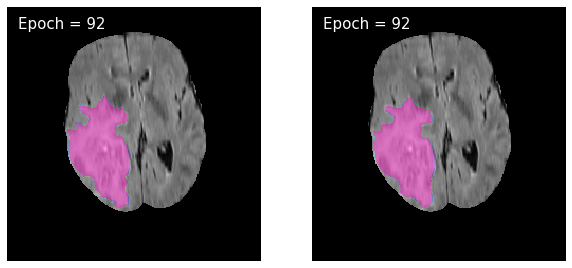

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 94: model 1 : train_loss : 0.0022919387658020133, valid_loss : 0.0028607120107398093


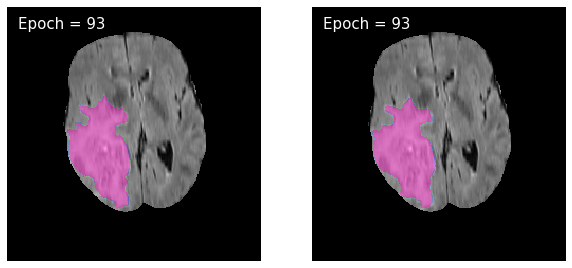

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 95: model 1 : train_loss : 0.002036659542265576, valid_loss : 0.0025743704229978185


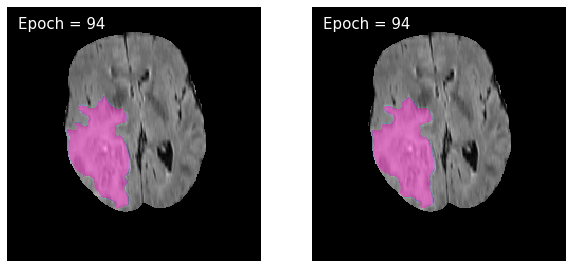

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 96: model 1 : train_loss : 0.0018645485467530072, valid_loss : 0.0023587139086557627


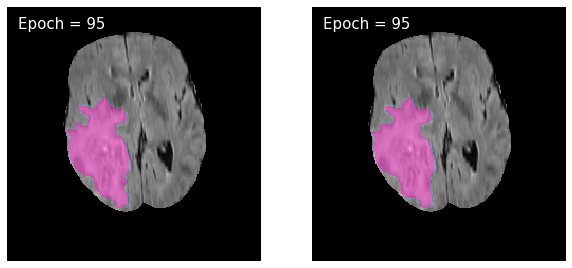

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 97: model 1 : train_loss : 0.0017552728821196729, valid_loss : 0.0024293661299166717


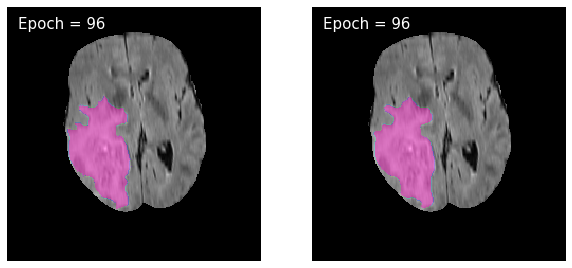

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 98: model 1 : train_loss : 0.0018017982725950787, valid_loss : 0.0022359882867119592


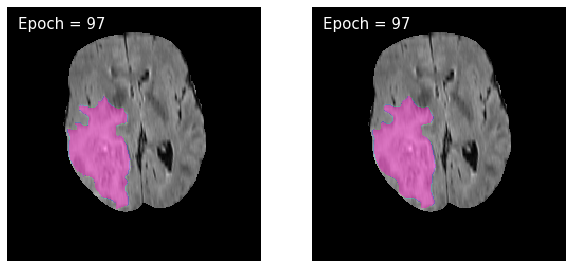

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 99: model 1 : train_loss : 0.0018450804390192106, valid_loss : 0.0025623519334096725


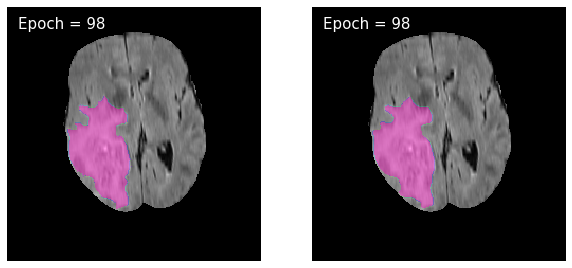

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 100: model 1 : train_loss : 0.0018918182531948023, valid_loss : 0.0024908489211787972


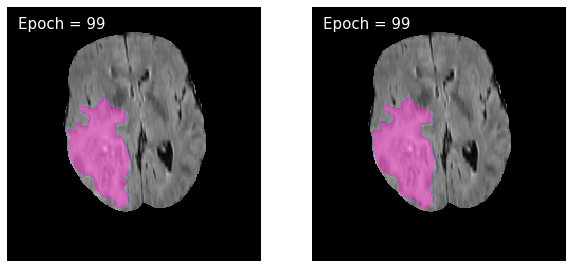

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 101: model 1 : train_loss : 0.0017000709842566353, valid_loss : 0.0024289013876070222


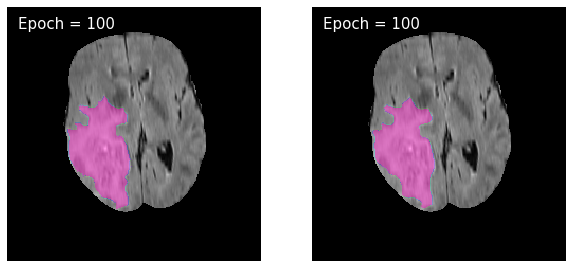

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 102: model 1 : train_loss : 0.0017314529873709043, valid_loss : 0.002434229083292703


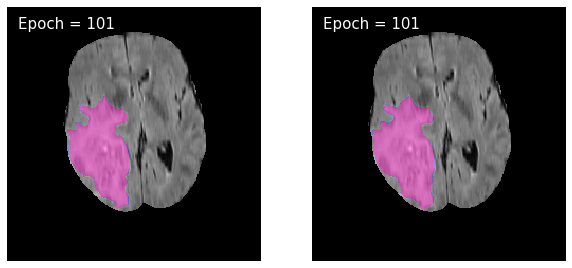

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 103: model 1 : train_loss : 0.0017710594110704767, valid_loss : 0.0025138498224850057


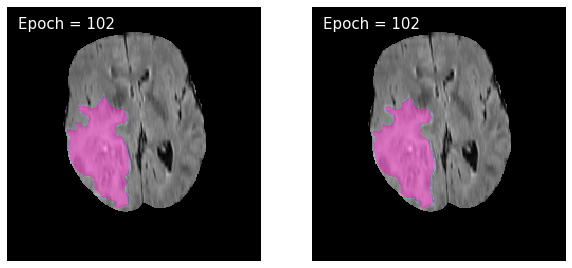

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 104: model 1 : train_loss : 0.005802893931868098, valid_loss : 0.009416130128014288


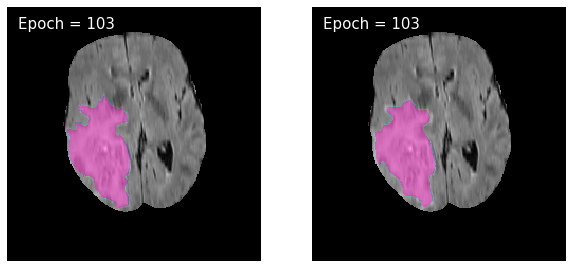

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 105: model 1 : train_loss : 0.0038043027223921963, valid_loss : 0.0028343396687151605


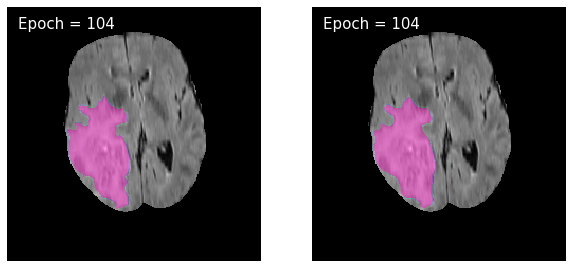

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 106: model 1 : train_loss : 0.0020815210830629352, valid_loss : 0.0027107130544800394


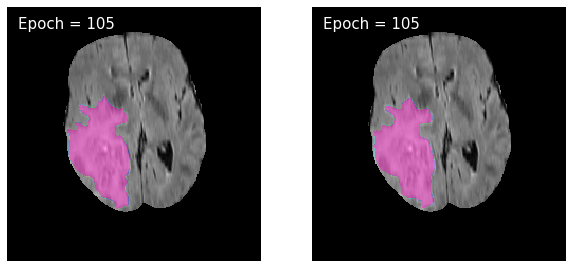

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 107: model 1 : train_loss : 0.0017601845368678127, valid_loss : 0.0022476156177294437


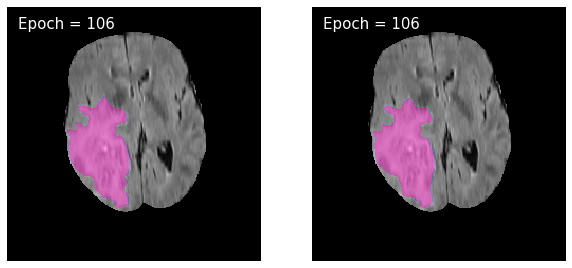

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 108: model 1 : train_loss : 0.0016354915113949739, valid_loss : 0.002329877801988107


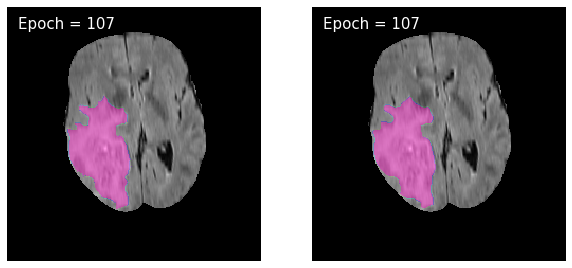

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 109: model 1 : train_loss : 0.0016044687828318611, valid_loss : 0.0023420189798084075


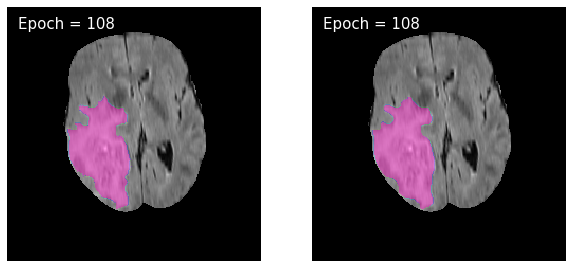

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 110: model 1 : train_loss : 0.001678466799739298, valid_loss : 0.002303712269155412


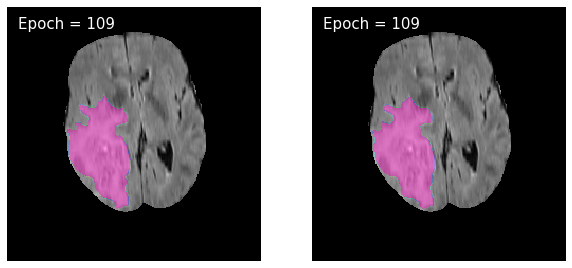

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 111: model 1 : train_loss : 0.0015392850994347352, valid_loss : 0.002238398543307142


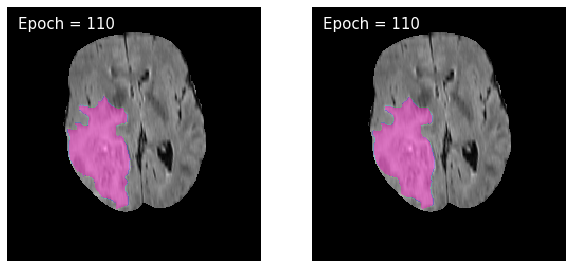

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 112: model 1 : train_loss : 0.0015116524995011347, valid_loss : 0.0022149499646560524


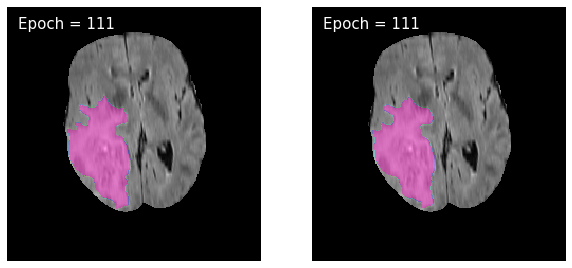

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 113: model 1 : train_loss : 0.0015543783331972724, valid_loss : 0.002494540714652406


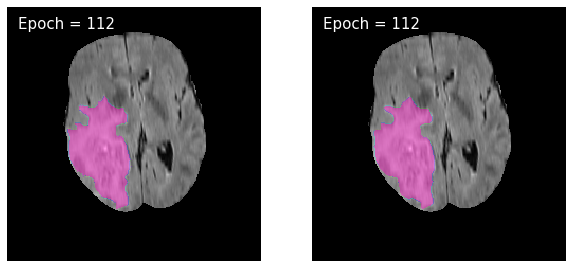

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 114: model 1 : train_loss : 0.001544302760654294, valid_loss : 0.0021832717645607364


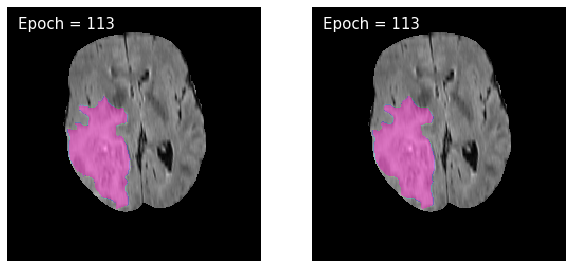

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 115: model 1 : train_loss : 0.0016522521827601734, valid_loss : 0.0022579573389093018


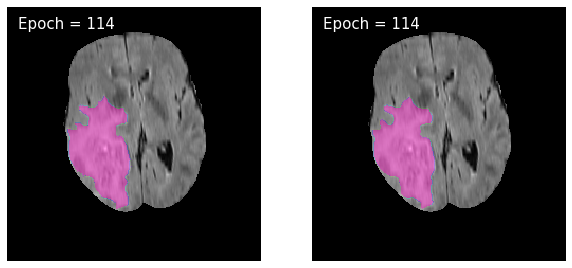

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 116: model 1 : train_loss : 0.001594360154601959, valid_loss : 0.0023230122297226144


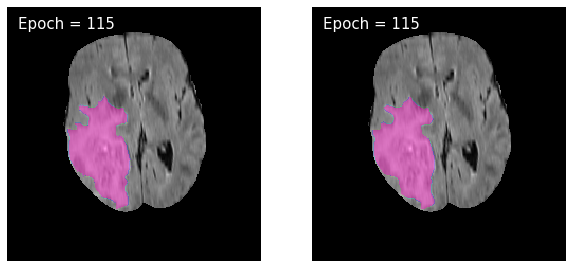

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 117: model 1 : train_loss : 0.001841912454090061, valid_loss : 0.05181124300946699


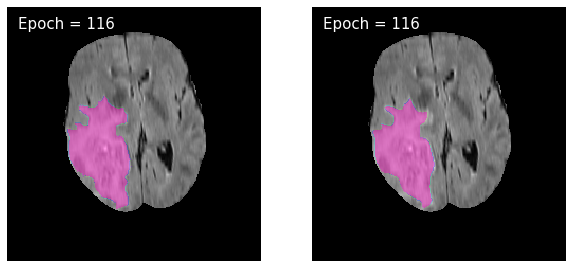

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 118: model 1 : train_loss : 0.004289279523144385, valid_loss : 0.0025366389946129483


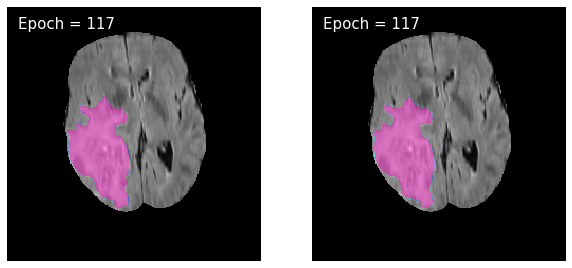

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 119: model 1 : train_loss : 0.001781799683996451, valid_loss : 0.0024377469267015534


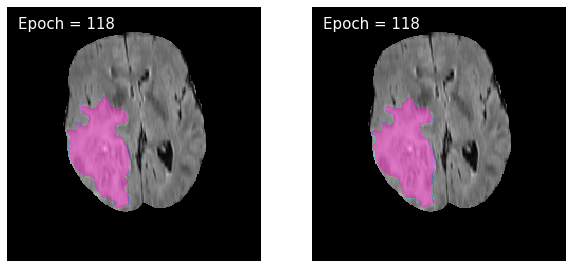

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 120: model 1 : train_loss : 0.0016256590342400424, valid_loss : 0.00218935838922741


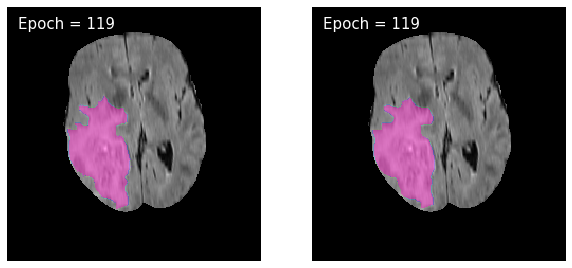

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 121: model 1 : train_loss : 0.0015662496952981969, valid_loss : 0.002344077366079867


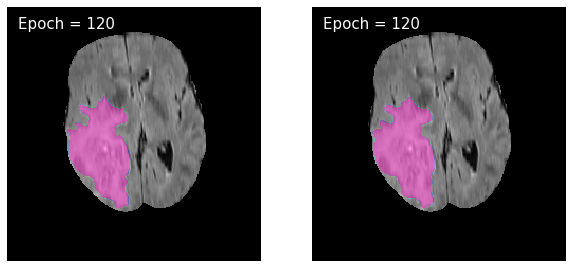

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 122: model 1 : train_loss : 0.001560886708545514, valid_loss : 0.0022186806558362453


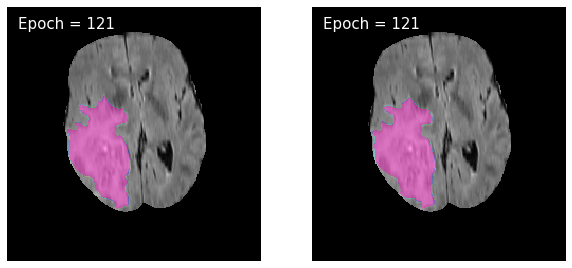

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 123: model 1 : train_loss : 0.001533985785101904, valid_loss : 0.002401816239818569


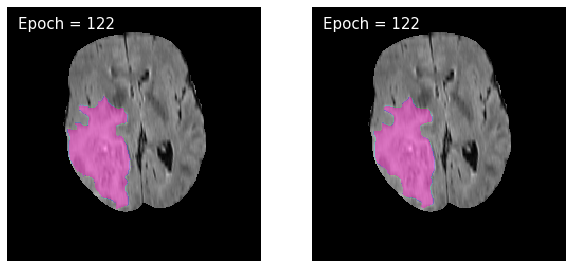

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 124: model 1 : train_loss : 0.0014374132292598119, valid_loss : 0.0023876639228157357


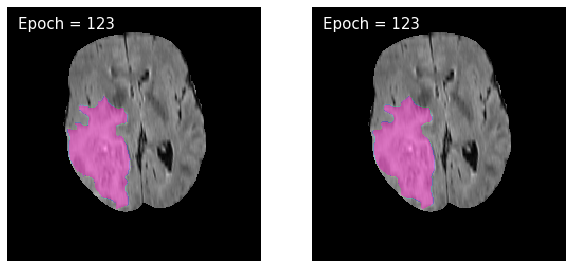

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 125: model 1 : train_loss : 0.0014804946903835665, valid_loss : 0.002220977567627405


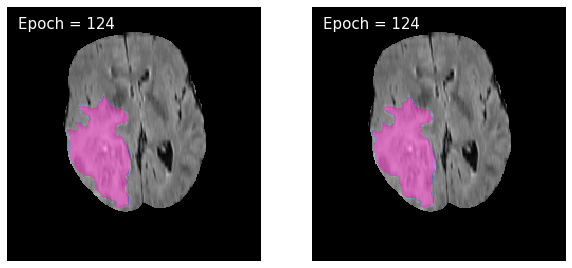

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 126: model 1 : train_loss : 0.0016644554247895187, valid_loss : 0.002751579156383893


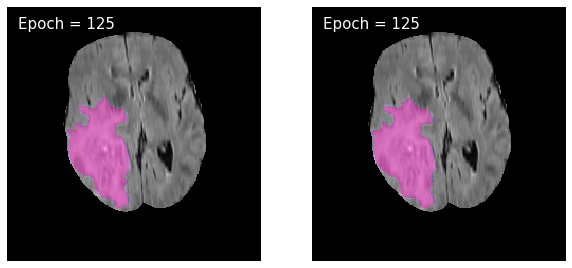

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 127: model 1 : train_loss : 0.001618495583002405, valid_loss : 0.0024281197951083315


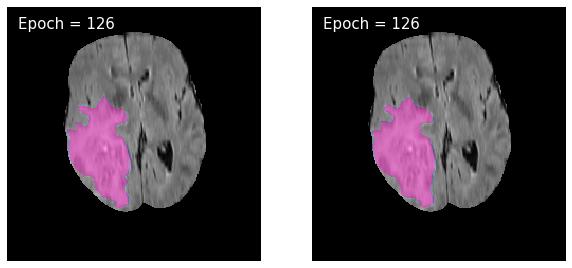

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 128: model 1 : train_loss : 0.0037003976334167867, valid_loss : 0.010591161395818598


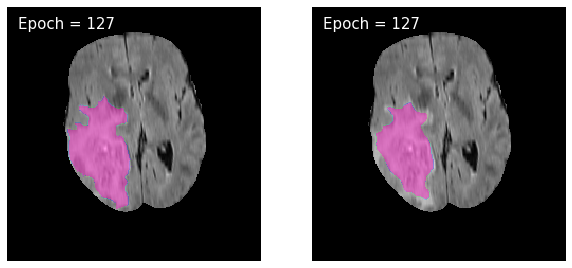

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 129: model 1 : train_loss : 0.004884755176450886, valid_loss : 0.0029316173995606663


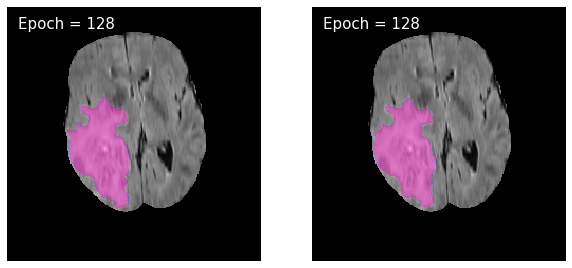

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 130: model 1 : train_loss : 0.0020543725868163295, valid_loss : 0.0022847847963896766


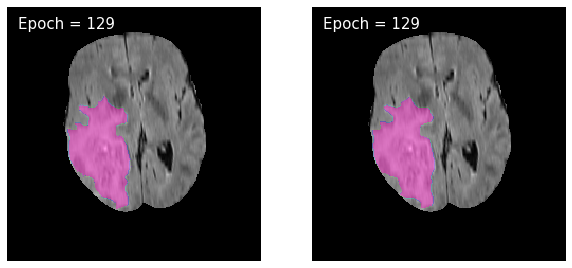

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 131: model 1 : train_loss : 0.0016600030482124965, valid_loss : 0.0022226496631670106


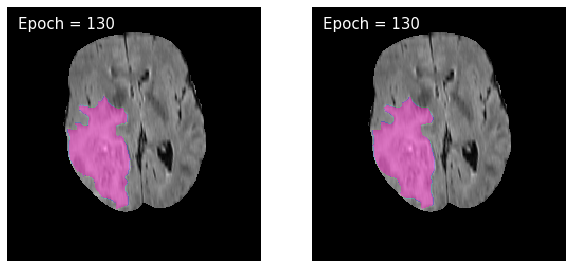

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 132: model 1 : train_loss : 0.0015598158625144145, valid_loss : 0.00224370354661367


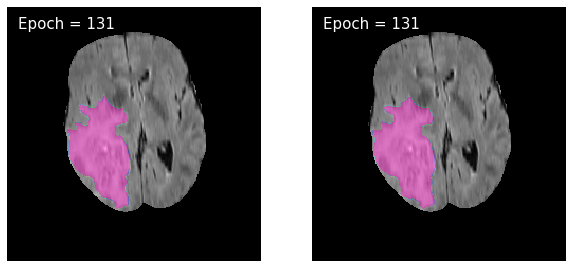

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 133: model 1 : train_loss : 0.0014302917775300661, valid_loss : 0.002160160312077531


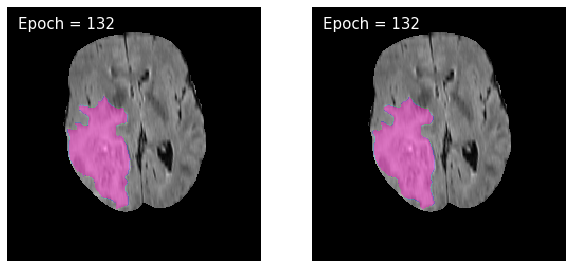

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 134: model 1 : train_loss : 0.0014259090309581713, valid_loss : 0.0022912775244747726


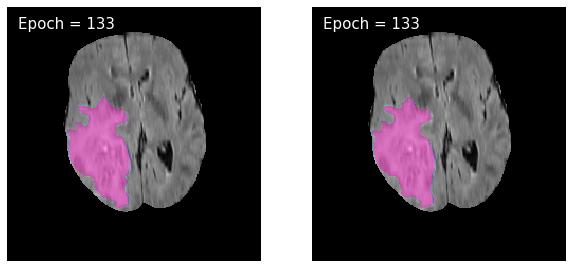

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 135: model 1 : train_loss : 0.0014584607096363549, valid_loss : 0.002273556725285323


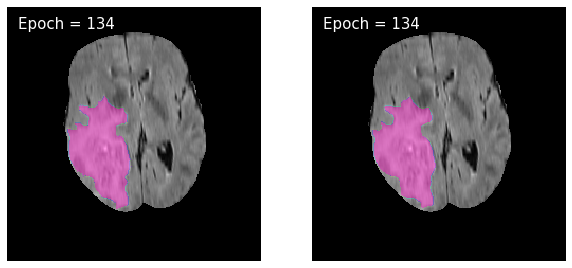

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 136: model 1 : train_loss : 0.0014223393581277576, valid_loss : 0.002321070150619264


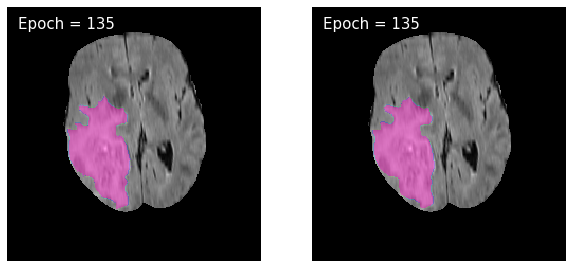

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 137: model 1 : train_loss : 0.0015163036205494771, valid_loss : 0.0029842481571413612


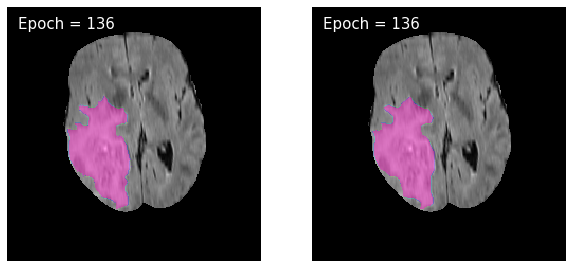

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 138: model 1 : train_loss : 0.0016234409461481293, valid_loss : 0.002752359890081494


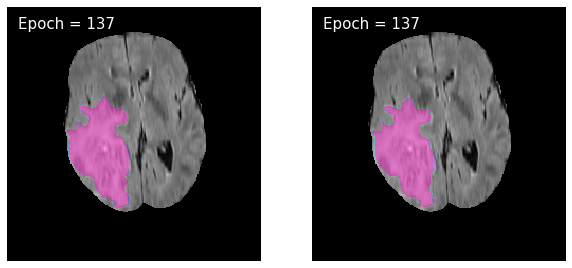

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 139: model 1 : train_loss : 0.007352655960542728, valid_loss : 0.009395567186465899


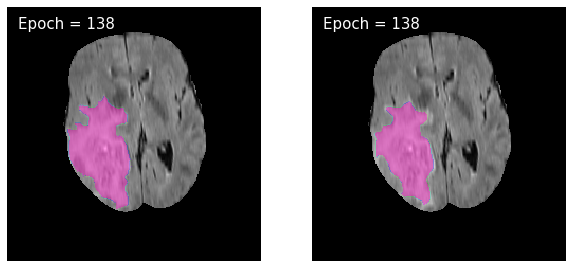

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 140: model 1 : train_loss : 0.006908154342181864, valid_loss : 0.004018363303187556


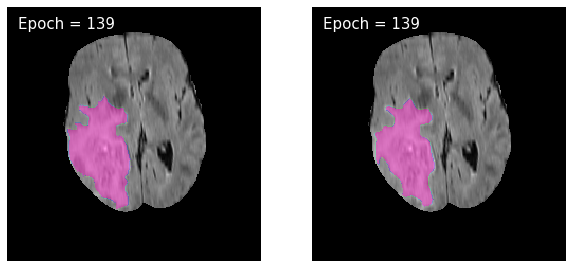

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 141: model 1 : train_loss : 0.0028038687694267803, valid_loss : 0.002960368292779351


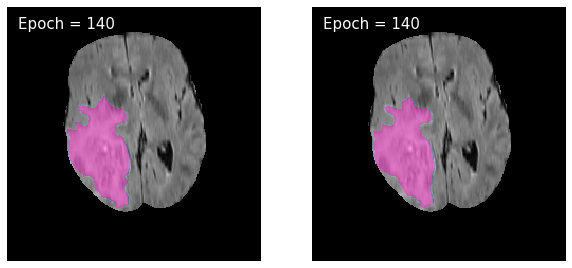

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 142: model 1 : train_loss : 0.0019010350960825418, valid_loss : 0.00218994296558469


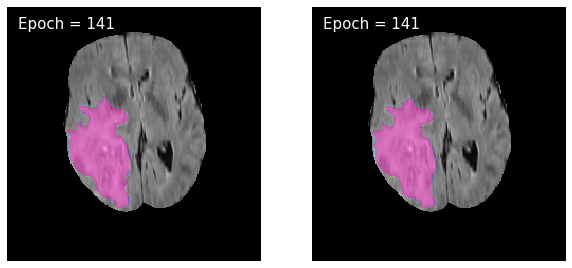

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 143: model 1 : train_loss : 0.001706712748586614, valid_loss : 0.0023664856656501927


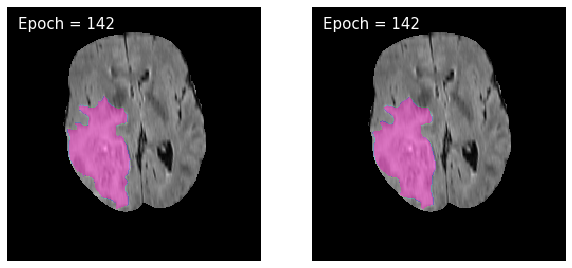

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 144: model 1 : train_loss : 0.0016970035940358996, valid_loss : 0.0025564372717118244


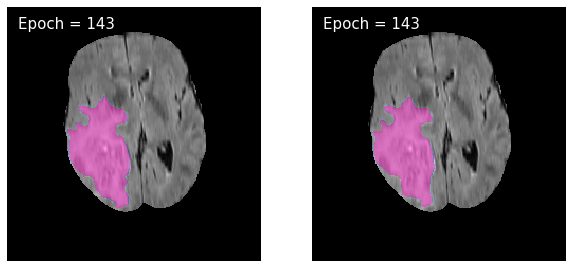

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 145: model 1 : train_loss : 0.001612085020271186, valid_loss : 0.0025154902299860627


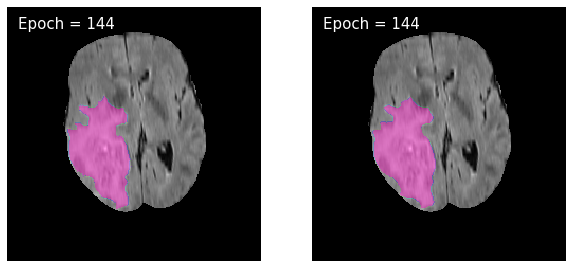

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 146: model 1 : train_loss : 0.0014801607208007799, valid_loss : 0.002236750787630427


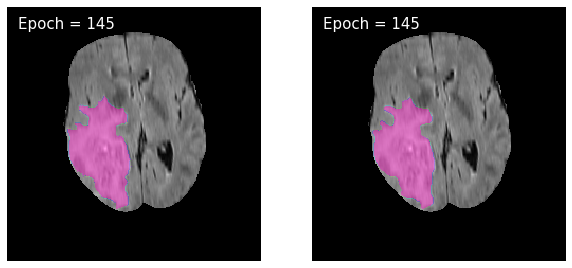

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 147: model 1 : train_loss : 0.0014868351230916742, valid_loss : 0.002208179035659609


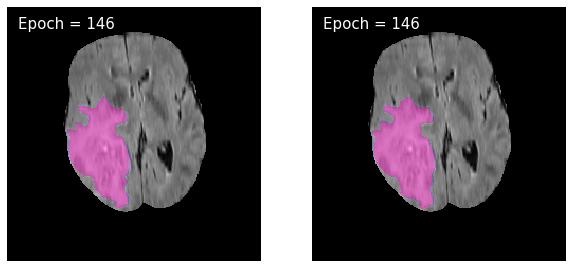

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 148: model 1 : train_loss : 0.0014521727522081, valid_loss : 0.0023253226062431532


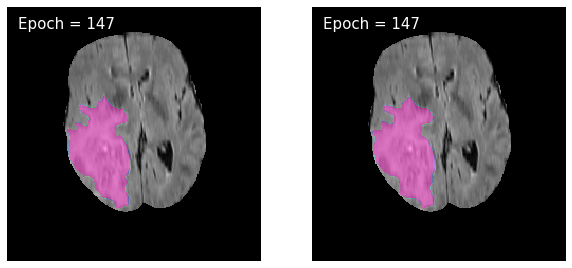

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 149: model 1 : train_loss : 0.0014887680103390188, valid_loss : 0.0022594968102213316


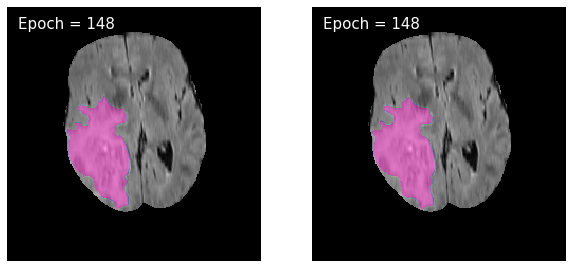

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 150: model 1 : train_loss : 0.001855416916885311, valid_loss : 0.0024362958290351055


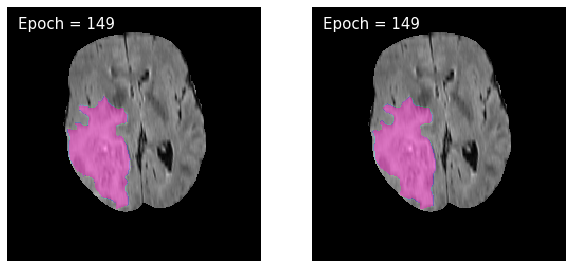

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 151: model 1 : train_loss : 0.0015357466595581873, valid_loss : 0.00239964794033455


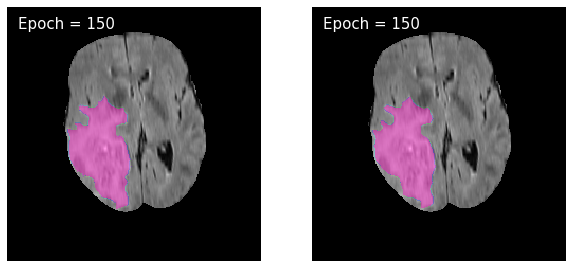

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 152: model 1 : train_loss : 0.0014923076829580634, valid_loss : 0.0022688158734490526


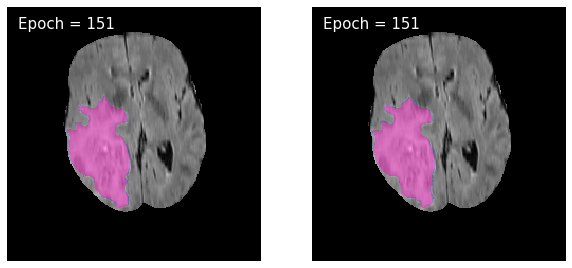

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 153: model 1 : train_loss : 0.0014958318721485554, valid_loss : 0.003271398114837552


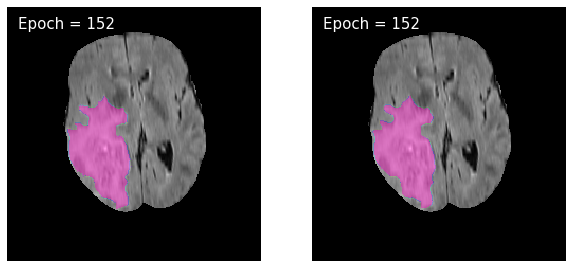

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 154: model 1 : train_loss : 0.0045743013048154335, valid_loss : 0.004207428555683466


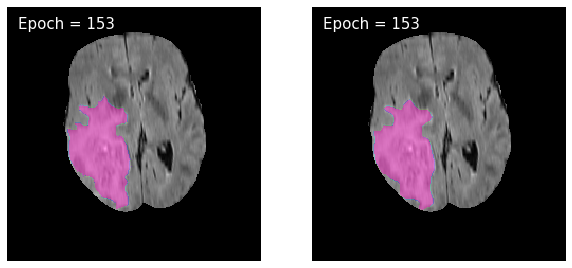

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 155: model 1 : train_loss : 0.0028559614587684093, valid_loss : 0.0025782950743882213


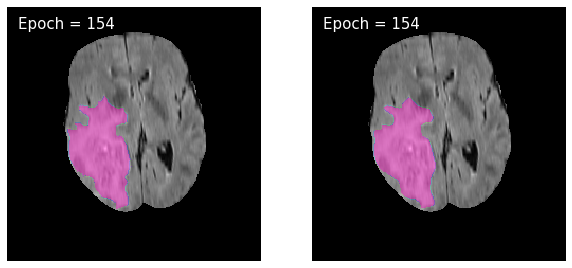

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 156: model 1 : train_loss : 0.0020600242924535372, valid_loss : 0.0023356139828385734


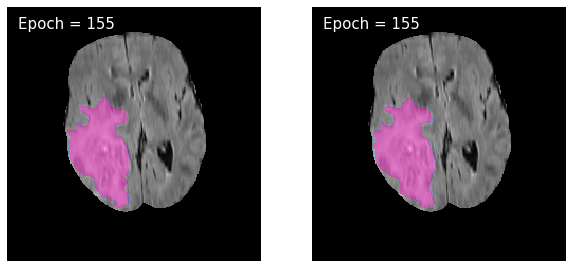

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 157: model 1 : train_loss : 0.0017563489462239605, valid_loss : 0.002216644574515333


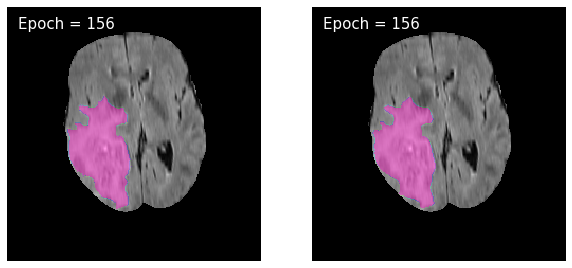

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 158: model 1 : train_loss : 0.0015751150283327454, valid_loss : 0.00216671837010565


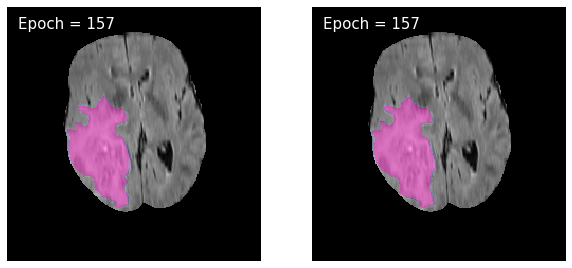

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 159: model 1 : train_loss : 0.001464830774511226, valid_loss : 0.002137830989843188


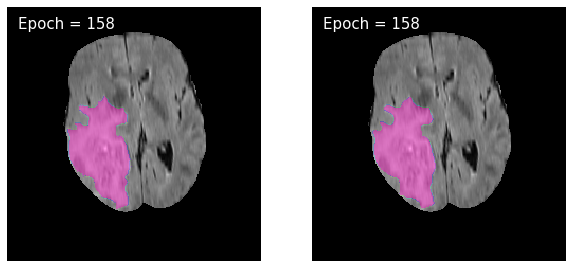

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 160: model 1 : train_loss : 0.00137104373859646, valid_loss : 0.002168097333892313


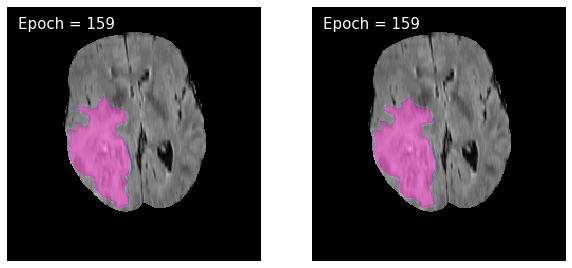

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 161: model 1 : train_loss : 0.0013073093942923876, valid_loss : 0.0021200909743302986


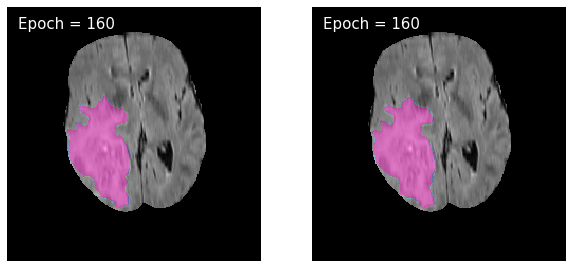

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 162: model 1 : train_loss : 0.0012515813908288553, valid_loss : 0.0021286829599447875


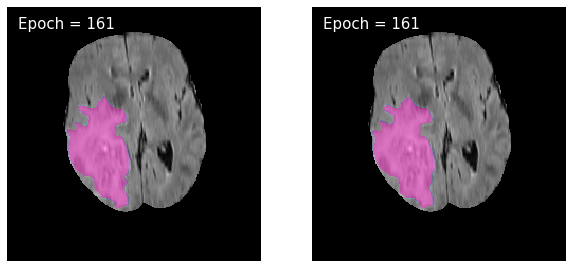

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 163: model 1 : train_loss : 0.0012125932811289874, valid_loss : 0.002152418827703669


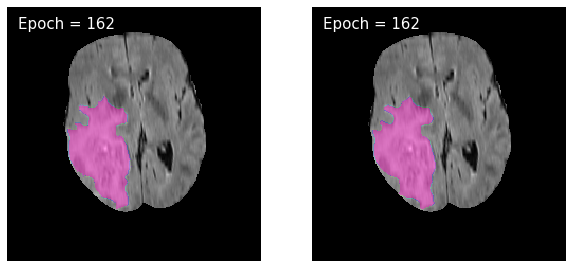

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 164: model 1 : train_loss : 0.0011808440318437255, valid_loss : 0.002156845244511321


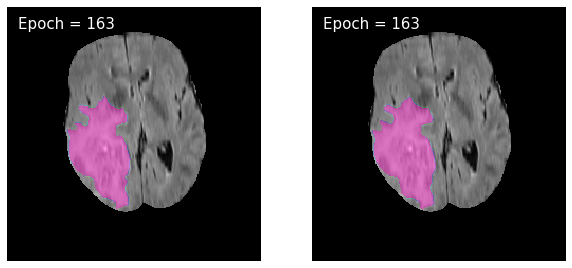

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 165: model 1 : train_loss : 0.0011496968257992096, valid_loss : 0.0022027868601627704


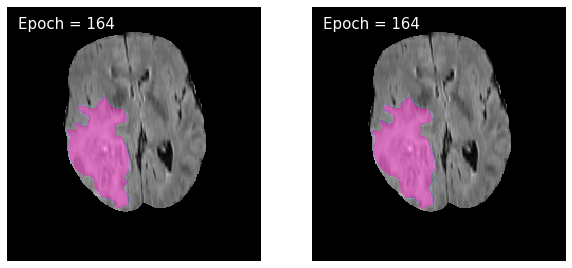

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 166: model 1 : train_loss : 0.0011193484355789239, valid_loss : 0.002151074290533543


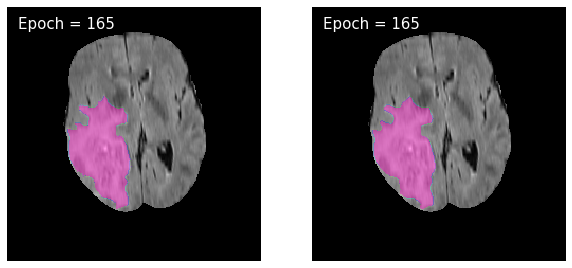

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 167: model 1 : train_loss : 0.0010992317574216582, valid_loss : 0.0022115962089801176


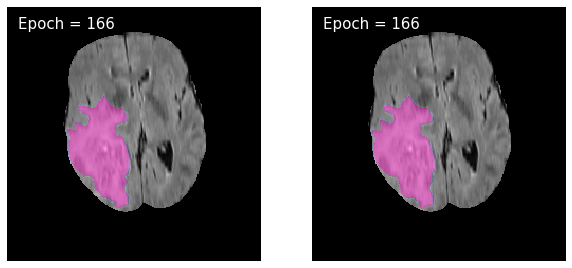

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 168: model 1 : train_loss : 0.0010826572238461644, valid_loss : 0.0022193603860031015


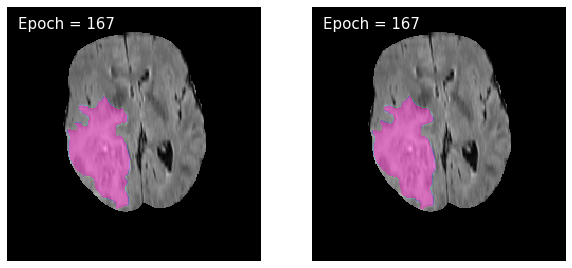

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 169: model 1 : train_loss : 0.001061529677258477, valid_loss : 0.0022060903349870125


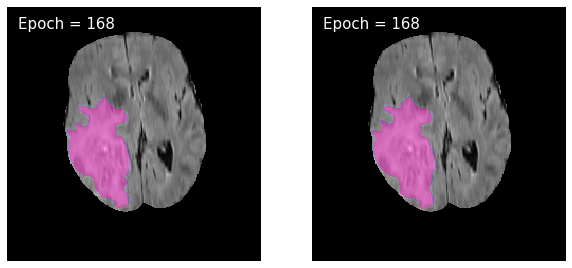

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 170: model 1 : train_loss : 0.0010469885012387636, valid_loss : 0.002232595918989934


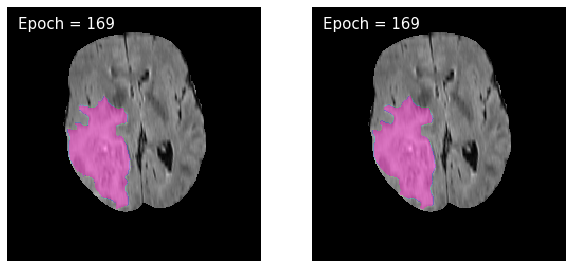

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 171: model 1 : train_loss : 0.0010198576111678647, valid_loss : 0.002252552532040978


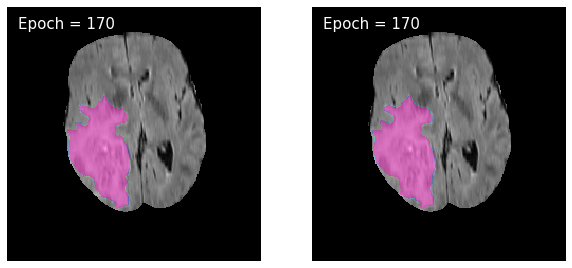

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 172: model 1 : train_loss : 0.001009447925650824, valid_loss : 0.00226263215102221


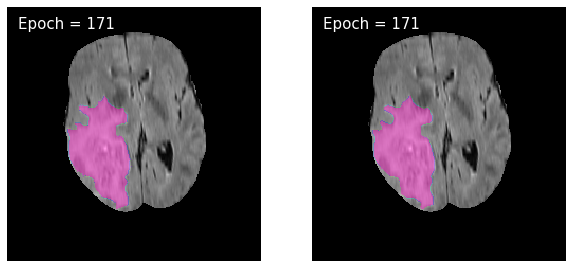

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 173: model 1 : train_loss : 0.000996445044886773, valid_loss : 0.00224738932451696


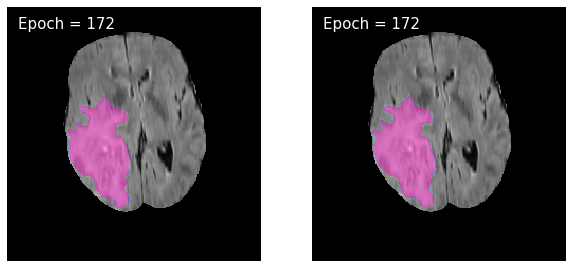

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 174: model 1 : train_loss : 0.0009839269084028106, valid_loss : 0.0022769268522488425


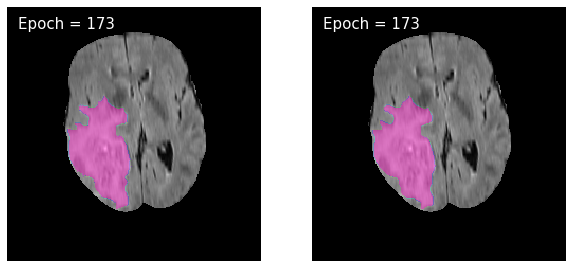

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 175: model 1 : train_loss : 0.0009656868275239363, valid_loss : 0.0022735994460843603


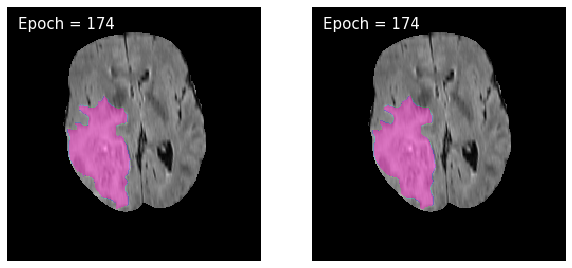

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 176: model 1 : train_loss : 0.0009589936059640949, valid_loss : 0.0022727540019013945


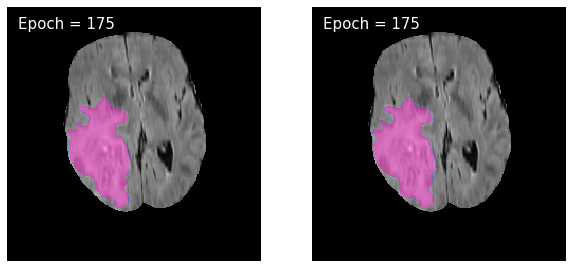

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 177: model 1 : train_loss : 0.0009476588909707169, valid_loss : 0.002311197666760854


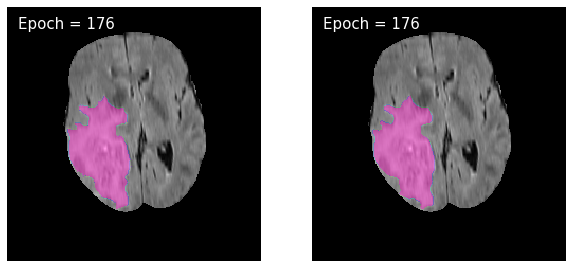

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 178: model 1 : train_loss : 0.0009236035728180248, valid_loss : 0.002329170766034786


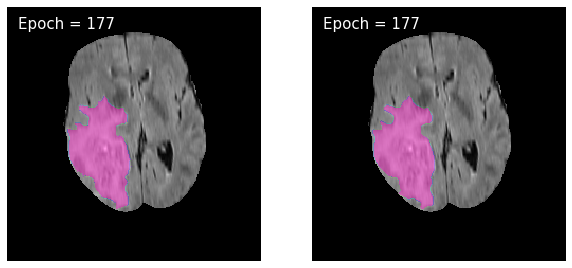

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 179: model 1 : train_loss : 0.0009267604844483846, valid_loss : 0.0023764906041117187


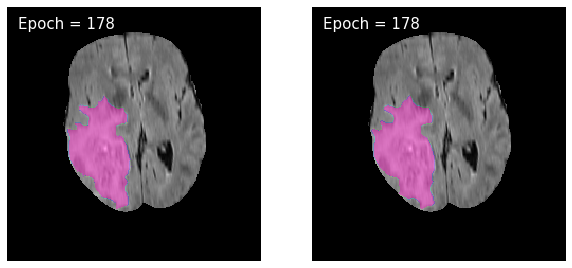

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 180: model 1 : train_loss : 0.000910666046017114, valid_loss : 0.002368451077738045


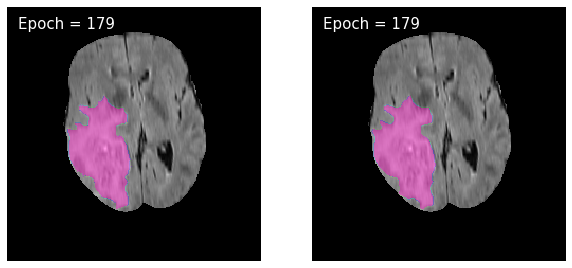

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 181: model 1 : train_loss : 0.0009030885538882042, valid_loss : 0.0023673446322085524


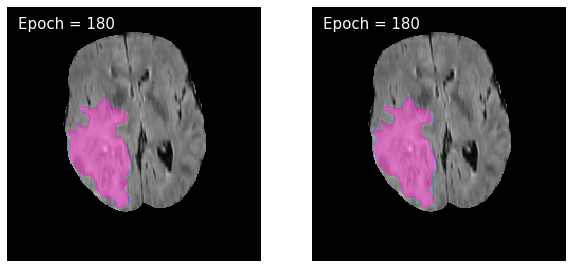

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 182: model 1 : train_loss : 0.0008867948295803432, valid_loss : 0.0023680776881168284


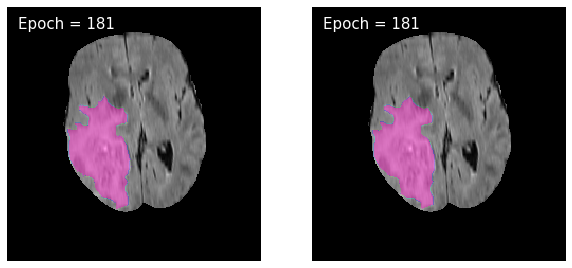

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 183: model 1 : train_loss : 0.0008467824424404311, valid_loss : 0.0023975419386030442


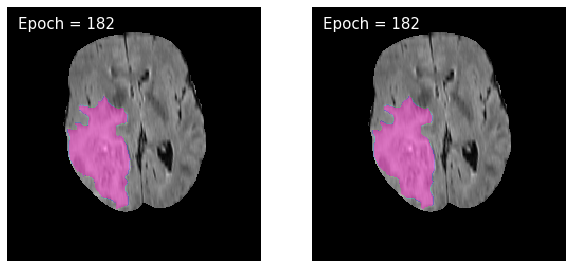

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 184: model 1 : train_loss : 0.0008319063554906952, valid_loss : 0.002410078161934217


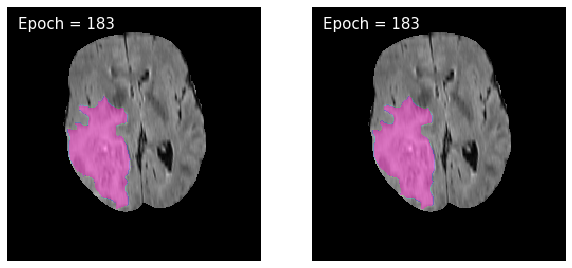

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 185: model 1 : train_loss : 0.0008246268469692965, valid_loss : 0.0024588803795759164


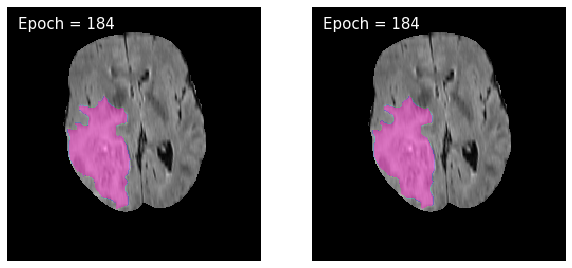

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 186: model 1 : train_loss : 0.0008306206743181379, valid_loss : 0.0024599160487009954


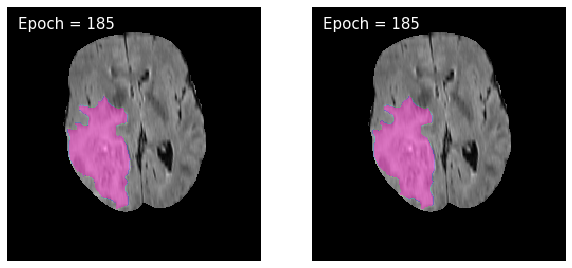

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 187: model 1 : train_loss : 0.0008184376251053271, valid_loss : 0.002481485338355704


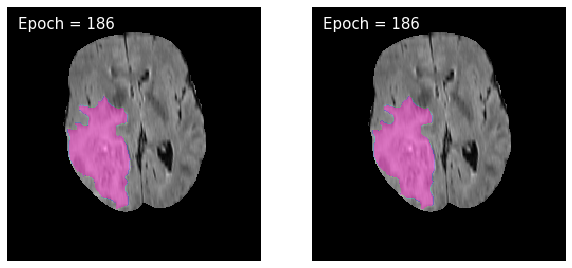

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 188: model 1 : train_loss : 0.0008207059462500954, valid_loss : 0.002490065891395738


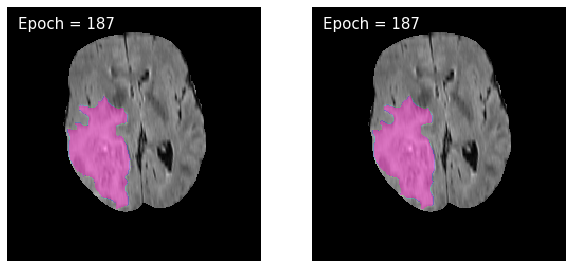

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 189: model 1 : train_loss : 0.0008179085094596321, valid_loss : 0.0024641527644183596


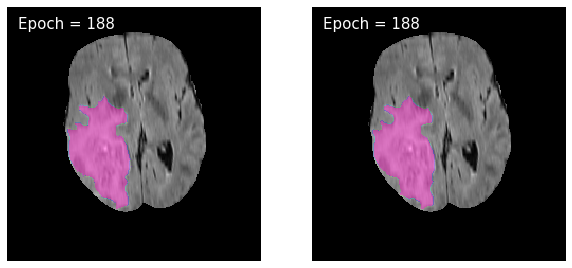

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 190: model 1 : train_loss : 0.0008115469381628691, valid_loss : 0.0024976349094463666


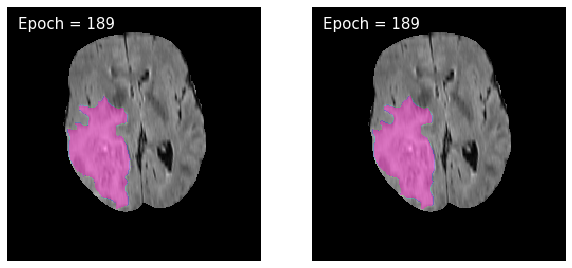

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 191: model 1 : train_loss : 0.00080916456251988, valid_loss : 0.0024929171406825913


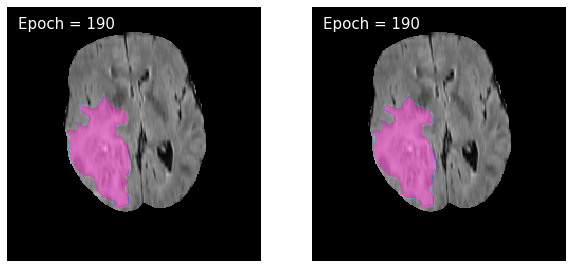

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 192: model 1 : train_loss : 0.0008080609028776313, valid_loss : 0.00248608203611036


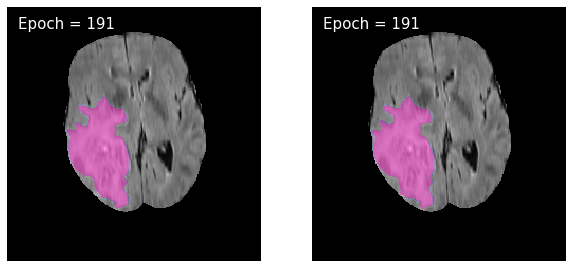

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 193: model 1 : train_loss : 0.0008114116380732801, valid_loss : 0.0025061881521152834


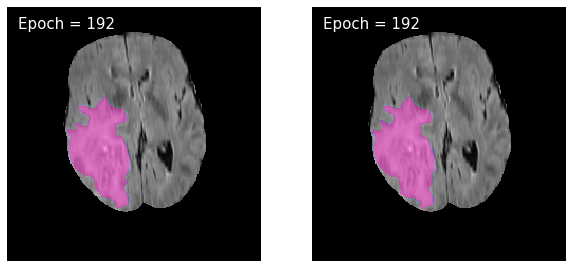

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 194: model 1 : train_loss : 0.0008066419999795013, valid_loss : 0.00249643044674008


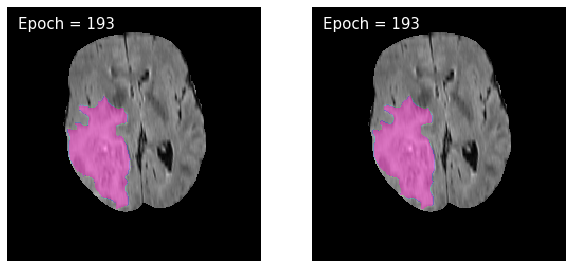

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 195: model 1 : train_loss : 0.0008078754809924455, valid_loss : 0.0024886814815238217


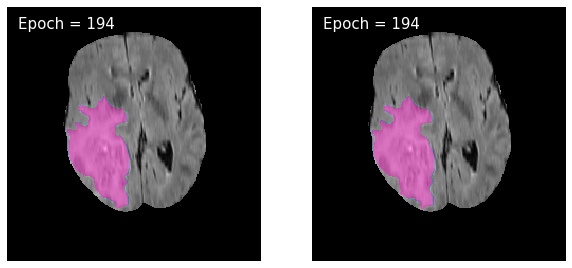

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 196: model 1 : train_loss : 0.0007998223333099255, valid_loss : 0.002521482594441181


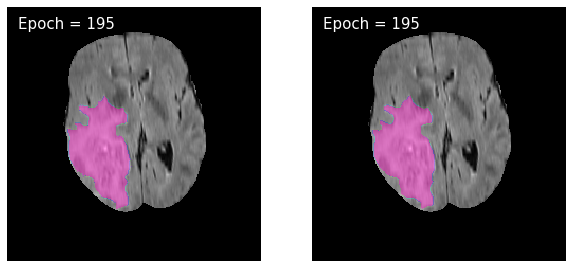

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 197: model 1 : train_loss : 0.0007963714544980355, valid_loss : 0.0025556443539056003


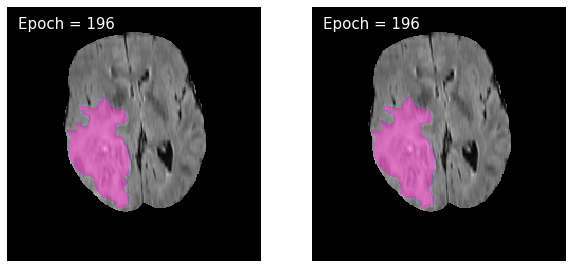

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 198: model 1 : train_loss : 0.0007978433919396913, valid_loss : 0.0025427904805600614


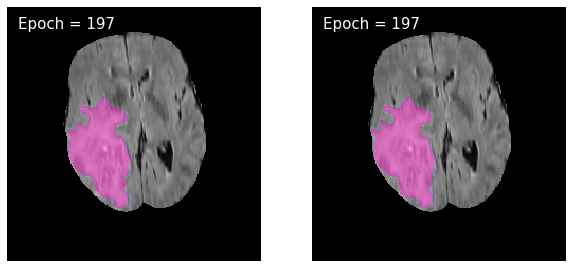

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 199: model 1 : train_loss : 0.0007956588420840161, valid_loss : 0.0025181966322661464


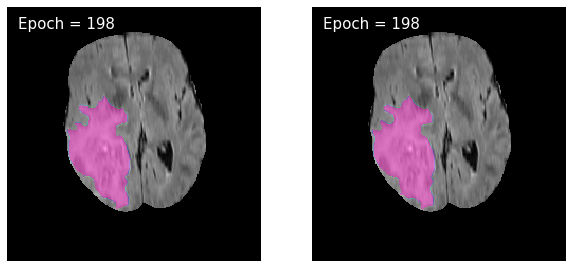

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 200: model 1 : train_loss : 0.0008029284685201082, valid_loss : 0.0025186382777627877


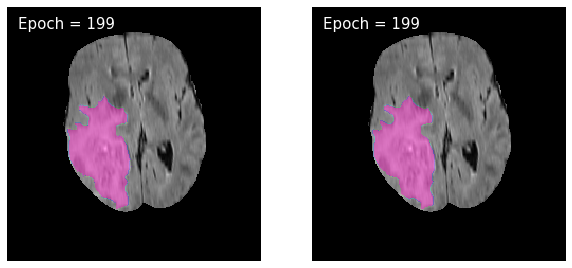

In [21]:
###### model 1 train


loss_1 = 0.
train_loss_1 = 0.
train_loss_2 = 0.

min_valid_loss = np.inf
train_loss_list_1 = []
valid_loss_list_1 = []

for i in tqdm(range(num_epoch)):
    train_loss_1 = 0.0
    valid_loss_1 = 0.0
    model_1.train()
    for image,label in tqdm(train_loader, leave=False):
        ########################
        # model 1 
        #######################
        
        image,label= image.to(device), label.to(device)
     
        optimizer_1.zero_grad()
        output = model_1(image)

        
        loss_1 = loss_func(output, (torch.sum(label[:,1:], axis = 1).unsqueeze(1)))  #0:normal data 
        # loss_1 += loss_func(output[:,0], label[:, 0])
     
        loss_1.backward()        
        optimizer_1.step()

        train_loss_1 += loss_1.item()*image.size(0)#
        
        
        
    ##### model valide        
    model_1.eval()
    
    for image, label in tqdm(valid_loader, leave=False):
      
        image ,label = image.to(device), label.to(device)
        
        output = model_1(image)
        loss_1 = loss_func(output, (torch.sum(label[:,1:], axis = 1).unsqueeze(1)))  #0:normal data 
        # loss_1 += loss_func(output[:,0], label[:, 0])
        valid_loss_1 += loss_1.item()*image.size(0)
        
    scheduler_1.step(valid_loss_1)
    
    if min_valid_loss>=valid_loss_1:
        # torch.save(model.module.state_dict(),'model_best_'+ str(fold) + '.pt')
        # torch.save(model.state_dict(), './model/3x3_model_{}.pt'.format(i+1))
        torch.save(model_1.state_dict(), f'./model/{save_1}.pt')
    

    
    
    train_loss_1 = train_loss_1/len(train_loader.sampler)
                                               
    valid_loss_1 = valid_loss_1/len(valid_loader.sampler)
    print('Epoch {}: model 1 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_1, valid_loss_1))
    train_loss_list_1.append(train_loss_1)
    valid_loss_list_1.append(valid_loss_1)
    
    
    
        ## 실시간으로 결과를 보여주려고 진행하는 이미지 
    pltimage = pltimage.to(device) # 4stack이미지를 
    pltout = model_1(pltimage)     # 일단 넣고 
    pltout = threshold_img(pltout) # 0.5 매핑 
    pltout = pltout.squeeze().detach().cpu().numpy()
    
    # imshow1(plt1)
    # Bimshow(pltout, i)  
    # param = pltout[1] + pltout[2]*2 +pltout[3]*3 +pltout[4]*4
    # Bimshow_2(plt1,show_label,pltout,i)
    Bimshow_2(plt1,np.sum(plt2,axis=0),pltout,i)

    plt.savefig('./image/model_1/model_1_{}th_result.png'.format(i), dpi=300, facecolor='None')
    plt.show()
    

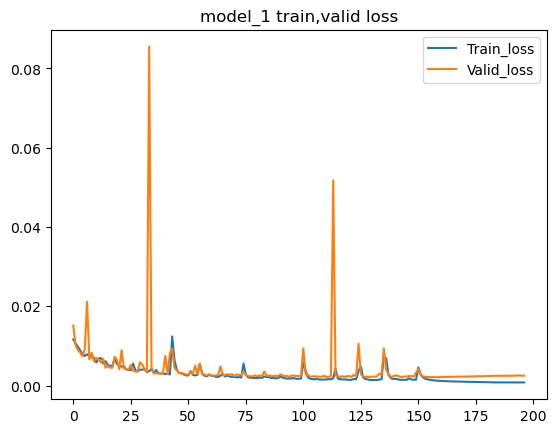

best epoch:  159


<Figure size 640x480 with 0 Axes>

In [23]:
plt.style.use('default')
plt.title('model_1 train,valid loss')
plt.plot(train_loss_list_1[3:],label = 'Train_loss')
plt.plot(valid_loss_list_1[3:],label = 'Valid_loss')
plt.legend()
plt.show()
print('best epoch: ',np.argmin(valid_loss_list_1)-1)
best=  np.argmin(valid_loss_list_1)-1
plt.savefig('./png/model_1 train,valid loss.png', dpi=300, facecolor='w')

Text(0.5, 1.0, 'label[0] reshape')

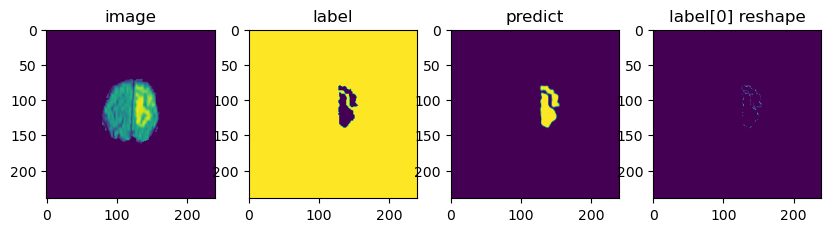

In [24]:
image , label = train_dataset.__getitem__(1200)
# image,label = pltimage , pltlabel
image, label = image.unsqueeze(0).cuda() , label.unsqueeze(0).cuda()
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_1.eval()
output = model_1(image)
# image.shape, label.shape
la = label.clone()
l = output*label
la[:,0] = l[:,0]
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy())
ax1.set_title('image')
ax2.imshow(label[0,0].detach().cpu().numpy())
ax2.set_title('label')
ax3.imshow(output[0,0].detach().cpu().numpy())
ax3.set_title('predict')
ax4.imshow(la[0][0].detach().cpu().numpy())
ax4.set_title('label[0] reshape')


In [15]:
model_2 = AttentionUNet_2(4,5).to(device)
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=20)
save_2 = '2_case_unet_ver_2_2'
loss_func = torch.nn.CrossEntropyLoss().to(device)


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 2 : train_loss : 0.9067653377584163, valid_loss : 0.906816632356695


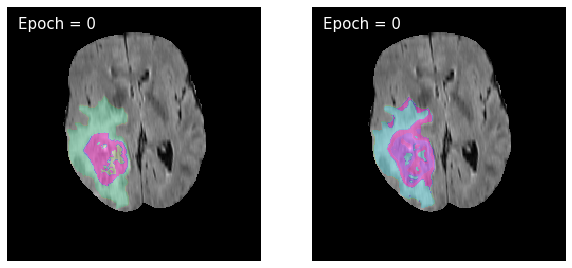

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 2 : train_loss : 0.9045159020679909, valid_loss : 0.9073742595250889


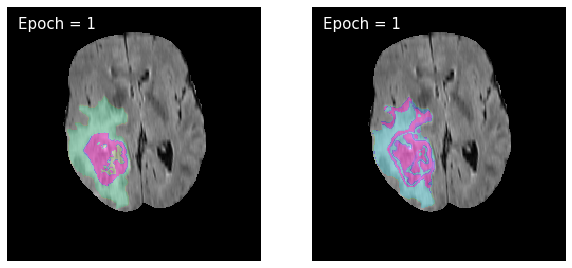

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 2 : train_loss : 0.9038001145559136, valid_loss : 0.9050833786367088


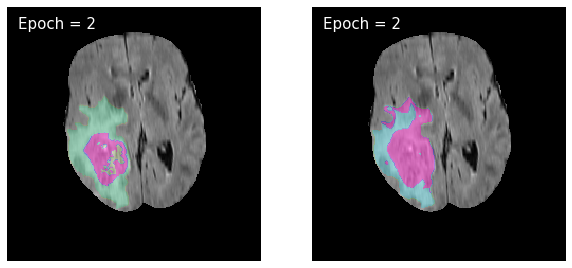

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 2 : train_loss : 0.9035052827807347, valid_loss : 0.9052509428352438


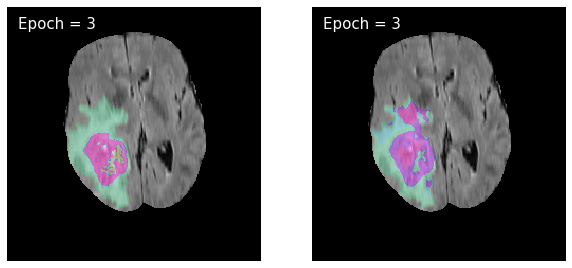

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 2 : train_loss : 0.9034746479934761, valid_loss : 0.9060216061370348


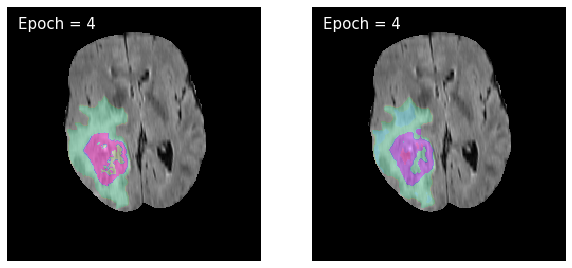

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 2 : train_loss : 0.9030888353951558, valid_loss : 0.9104194452845922


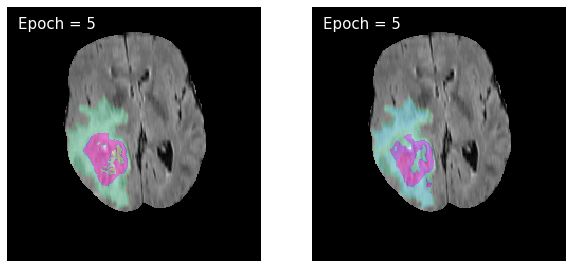

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 2 : train_loss : 0.9025061750572, valid_loss : 0.9023716095634686


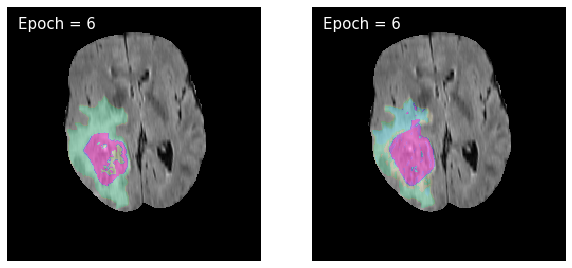

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 2 : train_loss : 0.9025024583675717, valid_loss : 0.9054897758428768


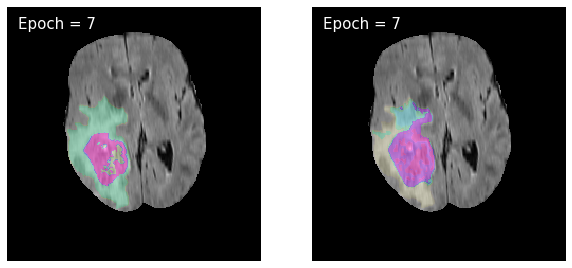

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 2 : train_loss : 0.9024401187096667, valid_loss : 0.9020934217879849


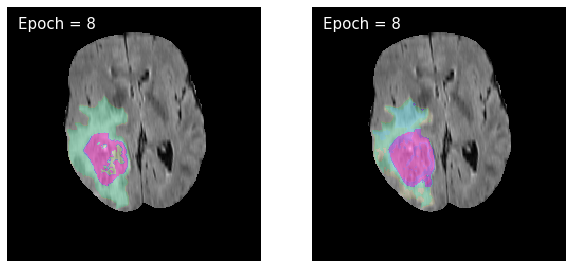

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 2 : train_loss : 0.9018447180455696, valid_loss : 0.9049895083711993


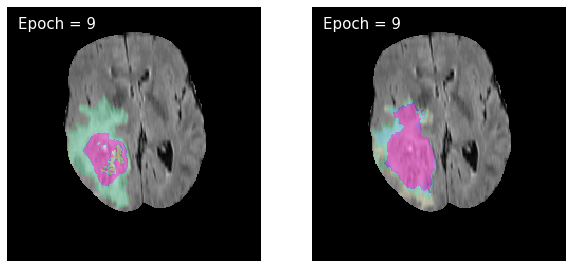

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 2 : train_loss : 0.9016650673793734, valid_loss : 0.9033934162348829


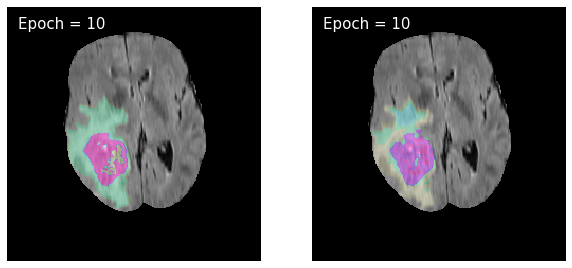

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 2 : train_loss : 0.9016880245016725, valid_loss : 0.9019293398946844


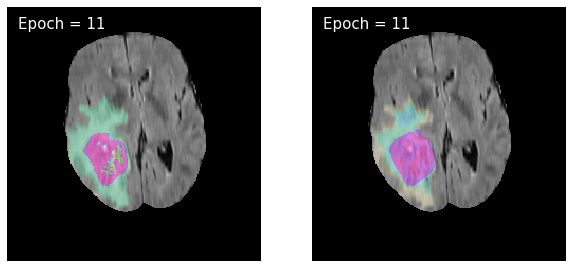

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 2 : train_loss : 0.9015581707826397, valid_loss : 0.9015011438118514


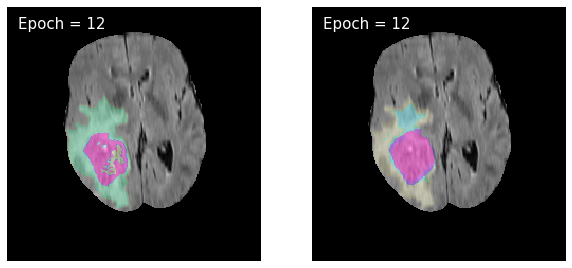

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 2 : train_loss : 0.9011682717325437, valid_loss : 0.902982601475331


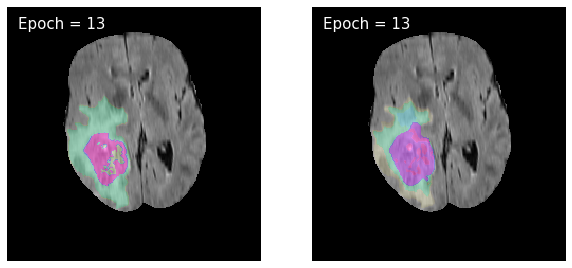

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 2 : train_loss : 0.9010340766085341, valid_loss : 0.9016921726926681


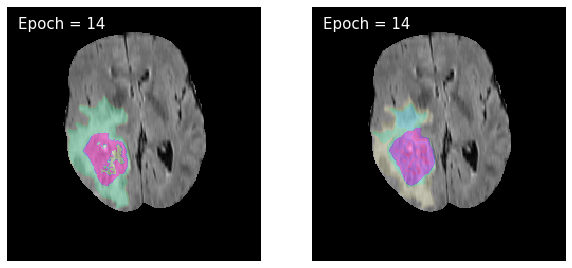

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 2 : train_loss : 0.9010698741981114, valid_loss : 0.9011048309264644


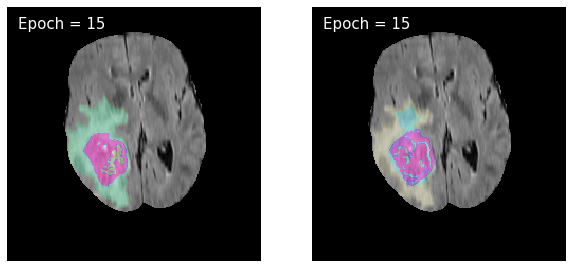

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 2 : train_loss : 0.9008429803837599, valid_loss : 0.901535318743798


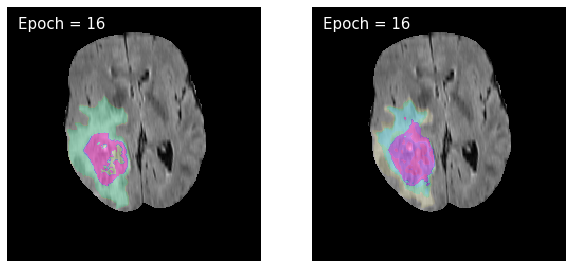

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 2 : train_loss : 0.9006196556475339, valid_loss : 0.9018578640716051


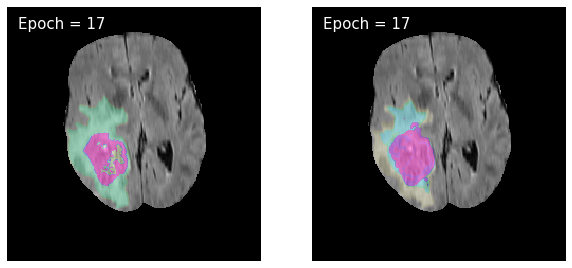

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 2 : train_loss : 0.9007569136768913, valid_loss : 0.9011881475647291


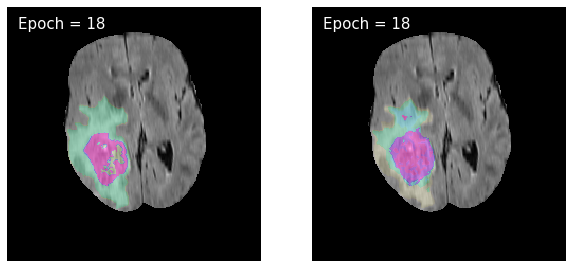

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 2 : train_loss : 0.9008033807645708, valid_loss : 0.9017223195042662


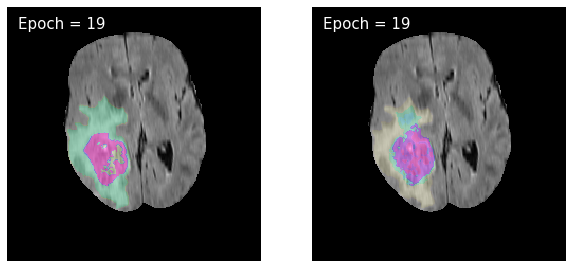

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 2 : train_loss : 0.9005956220413481, valid_loss : 0.9014644152534905


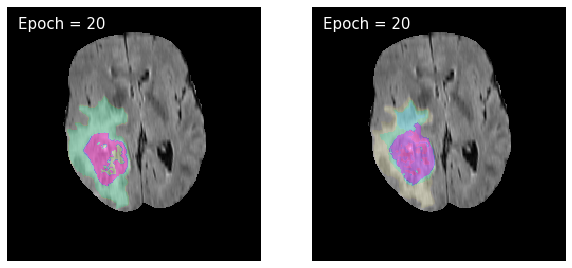

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 2 : train_loss : 0.9003102798056549, valid_loss : 0.9003334375478889


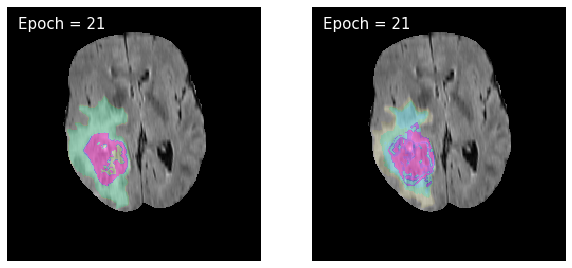

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 2 : train_loss : 0.9001131817798487, valid_loss : 0.9009122708311645


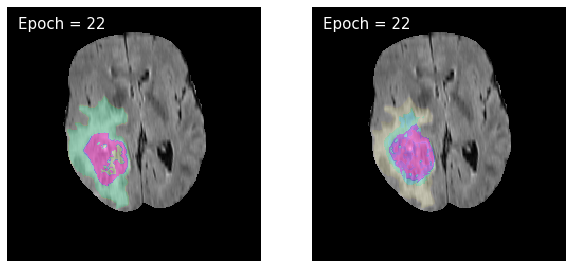

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 2 : train_loss : 0.9004069417381714, valid_loss : 0.9008987853603978


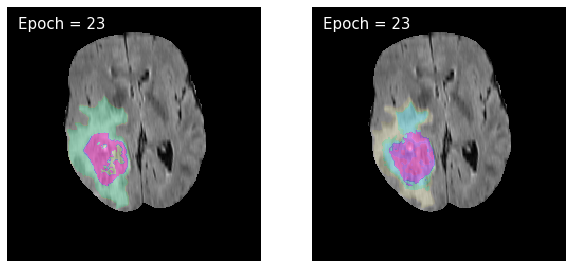

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 2 : train_loss : 0.9000672260653519, valid_loss : 0.9002130911234887


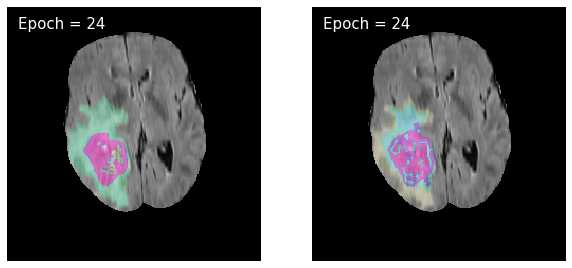

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 2 : train_loss : 0.899859465475317, valid_loss : 0.8996185146832979


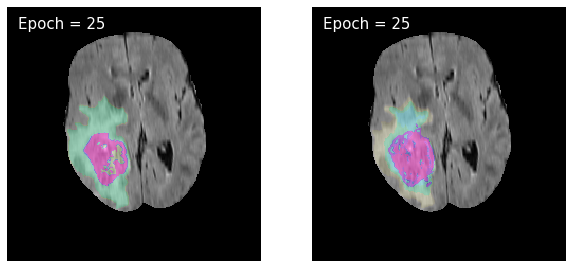

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 2 : train_loss : 0.8997667635847258, valid_loss : 0.9002852263630078


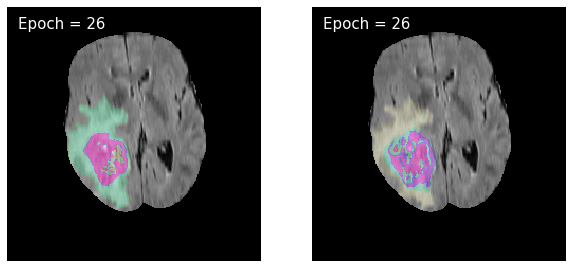

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 2 : train_loss : 0.8998078814555601, valid_loss : 0.9002715003907039


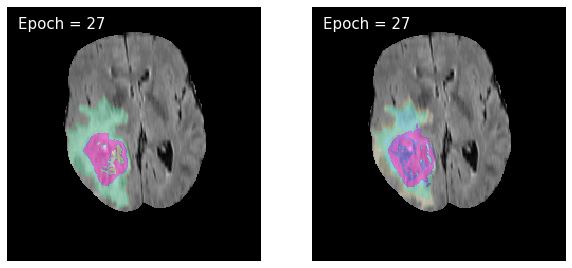

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 2 : train_loss : 0.8996877756961507, valid_loss : 0.9010387883391432


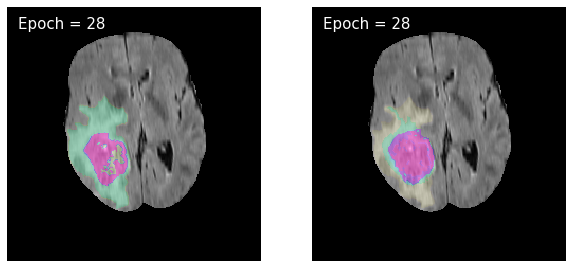

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 2 : train_loss : 0.899997336619119, valid_loss : 0.9004889147416237


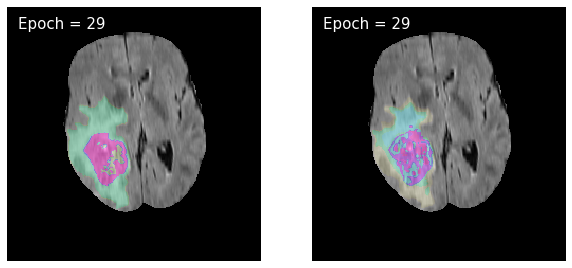

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 2 : train_loss : 0.8994998661197006, valid_loss : 0.8995062608712463


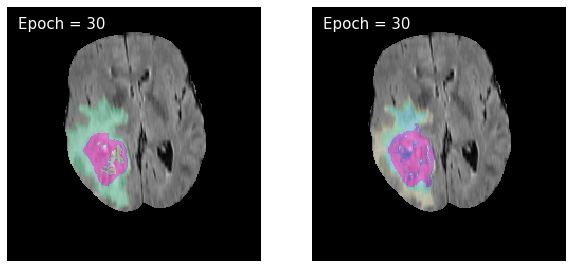

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 2 : train_loss : 0.8994798832291725, valid_loss : 0.9006751531394579


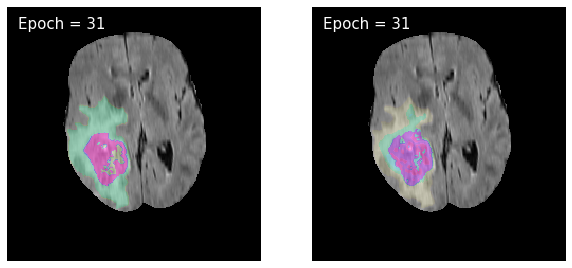

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 2 : train_loss : 0.8996496235230892, valid_loss : 0.8995074462345851


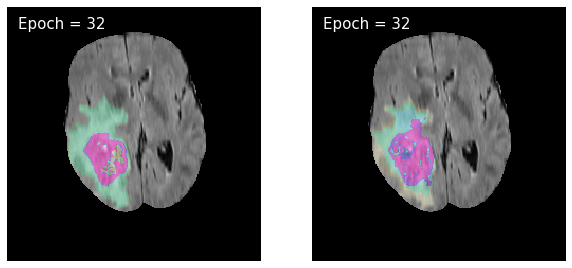

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 2 : train_loss : 0.8990972023415619, valid_loss : 0.8997574056028038


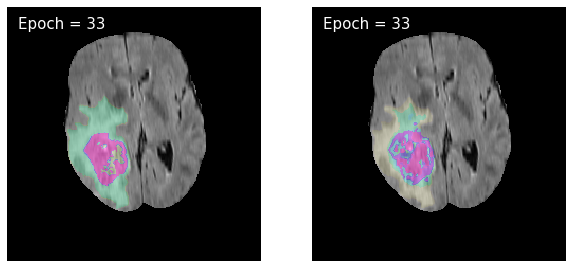

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 2 : train_loss : 0.8991796882360573, valid_loss : 0.8994952276028613


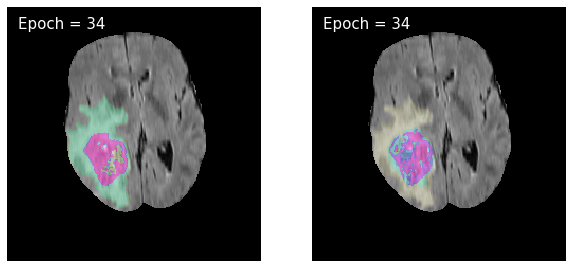

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 2 : train_loss : 0.899052827416917, valid_loss : 0.9009337524573008


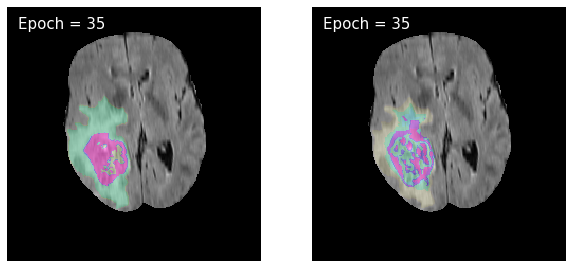

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 2 : train_loss : 0.8989042357043665, valid_loss : 0.9002625777195858


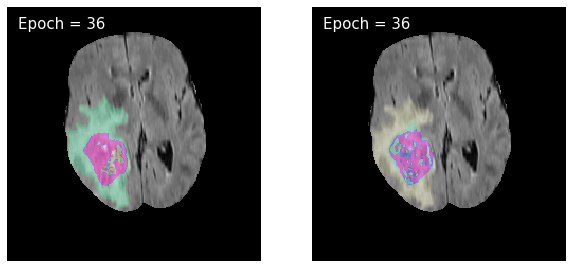

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 2 : train_loss : 0.8991209789943908, valid_loss : 0.8988329781800188


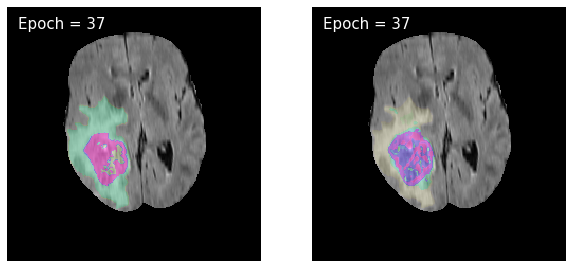

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 2 : train_loss : 0.8991479322947645, valid_loss : 0.8995422979676595


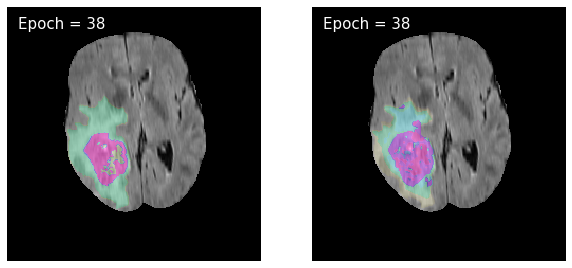

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 2 : train_loss : 0.8986883971515118, valid_loss : 0.8988429153318046


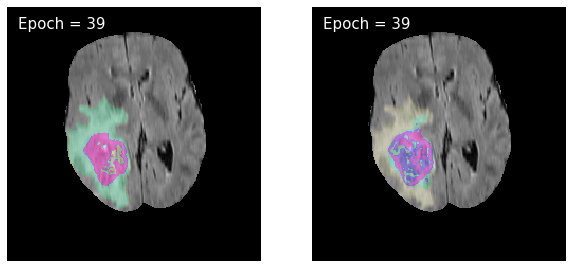

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 2 : train_loss : 0.8987059449189462, valid_loss : 0.8994650434582464


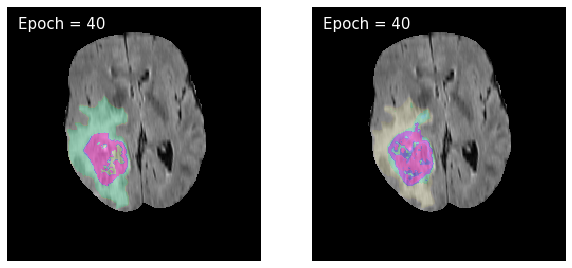

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 2 : train_loss : 0.8988417481682711, valid_loss : 0.9002568359657


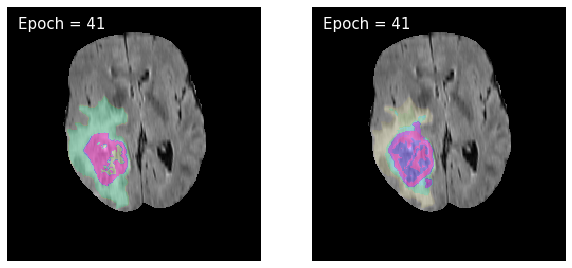

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 2 : train_loss : 0.8984588024600241, valid_loss : 0.8986324479663244


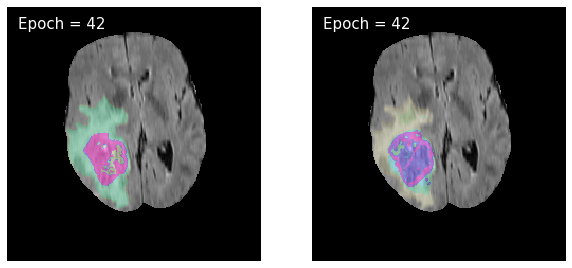

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 2 : train_loss : 0.8986310873522321, valid_loss : 0.8985127160145391


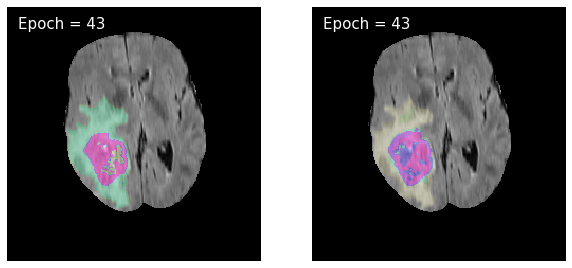

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 2 : train_loss : 0.8994182761616888, valid_loss : 0.9016662382630891


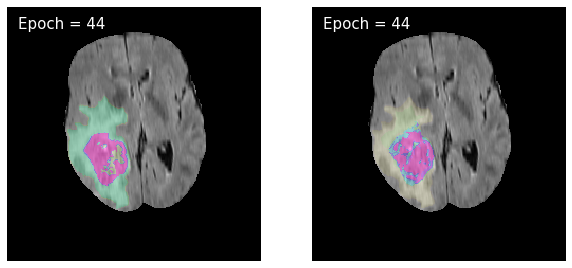

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 2 : train_loss : 0.8990328391926401, valid_loss : 0.9001759969258821


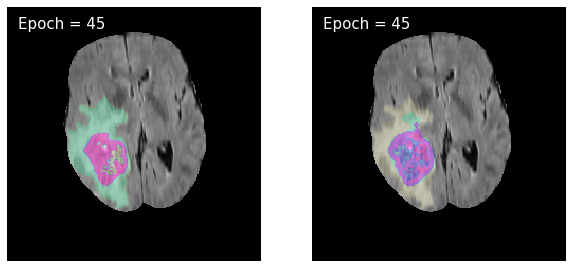

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 2 : train_loss : 0.8986883616820811, valid_loss : 0.8987960554258798


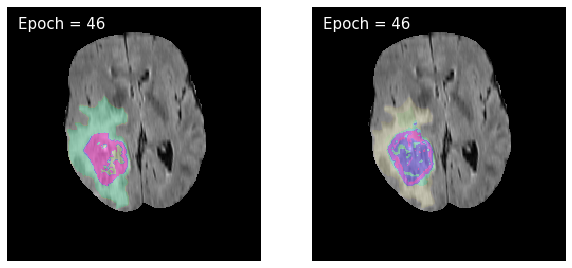

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 2 : train_loss : 0.8982528837468533, valid_loss : 0.8990735451700866


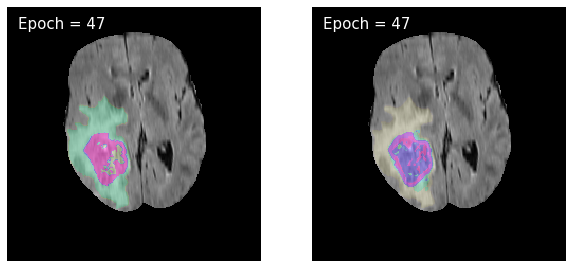

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 2 : train_loss : 0.8983025504171982, valid_loss : 0.8985680738283742


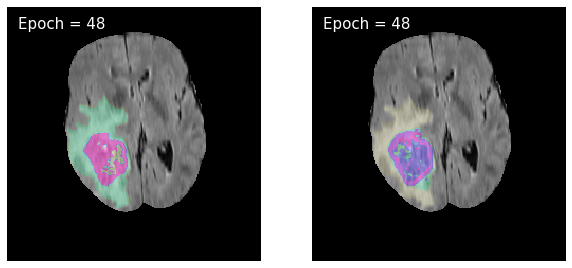

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 2 : train_loss : 0.8982284811785823, valid_loss : 0.8989386976726593


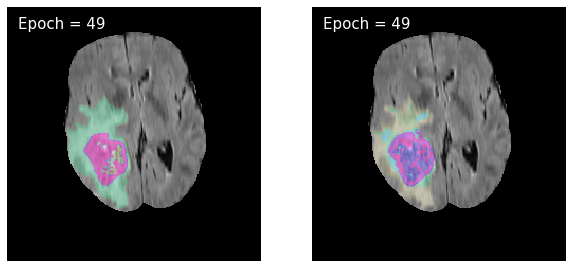

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 2 : train_loss : 0.8981577113970814, valid_loss : 0.8984434663127827


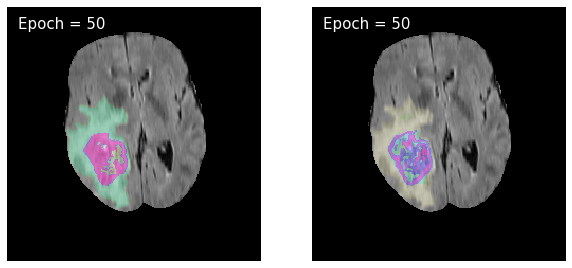

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 2 : train_loss : 0.89813248676475, valid_loss : 0.8985430329076706


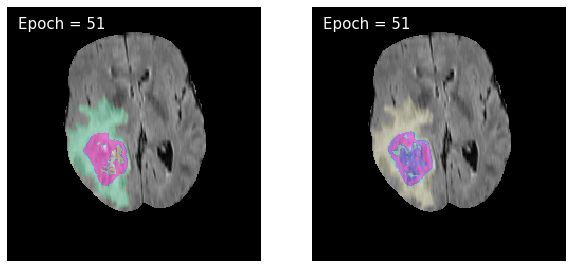

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 2 : train_loss : 0.8980764386637899, valid_loss : 0.8989716964543507


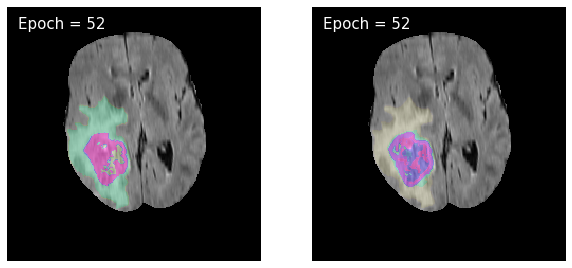

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 2 : train_loss : 0.8986268470217984, valid_loss : 0.8983845292560516


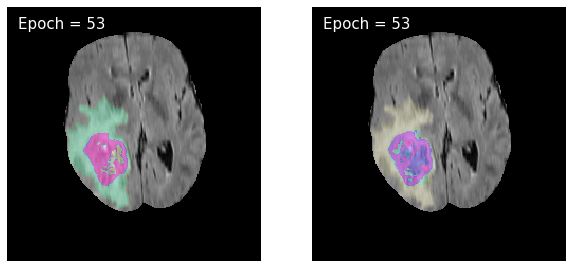

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 2 : train_loss : 0.8980664586860861, valid_loss : 0.8984856647990083


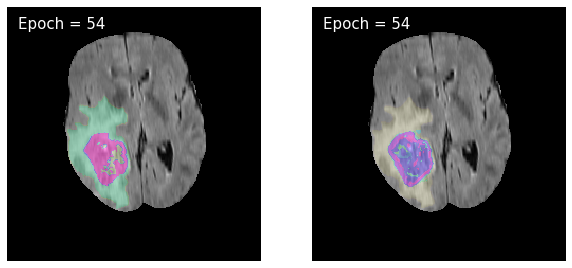

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 2 : train_loss : 0.8980115529408125, valid_loss : 0.8980523091490551


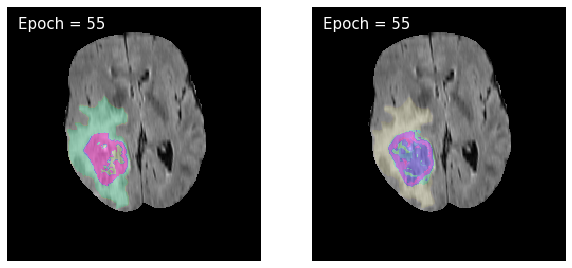

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 2 : train_loss : 0.8977863924615335, valid_loss : 0.8981495944242324


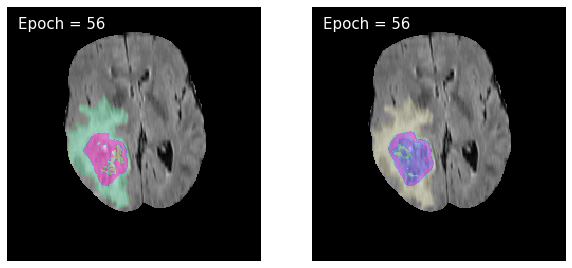

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 2 : train_loss : 0.8979817506184248, valid_loss : 0.8989704212834758


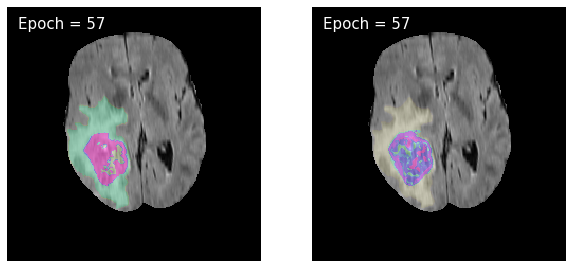

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 2 : train_loss : 0.8987548919332108, valid_loss : 0.8982308978835741


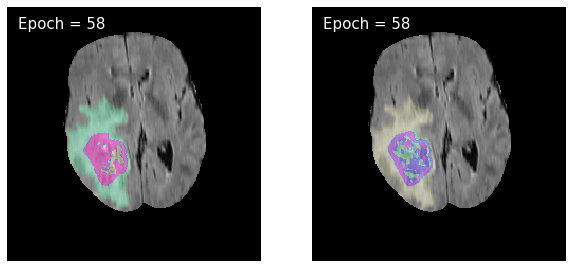

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 2 : train_loss : 0.8978392871167569, valid_loss : 0.8981241884250795


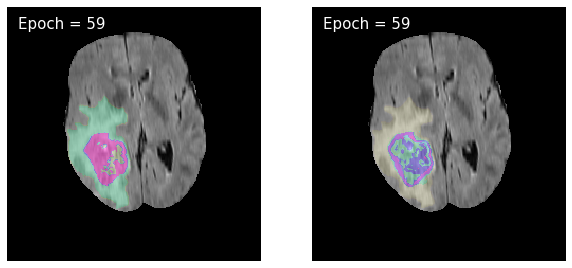

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 2 : train_loss : 0.8977946733735018, valid_loss : 0.8980624936921622


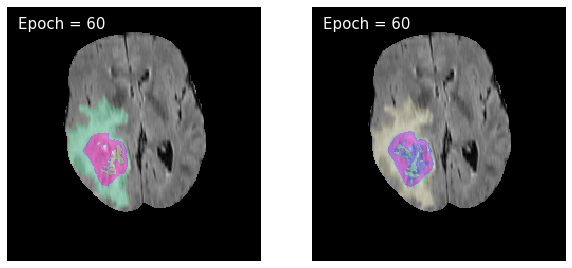

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 2 : train_loss : 0.8976948697294965, valid_loss : 0.8978743557968447


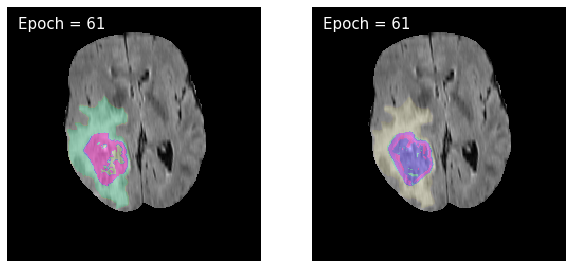

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 2 : train_loss : 0.8977740345651938, valid_loss : 0.8982100156686639


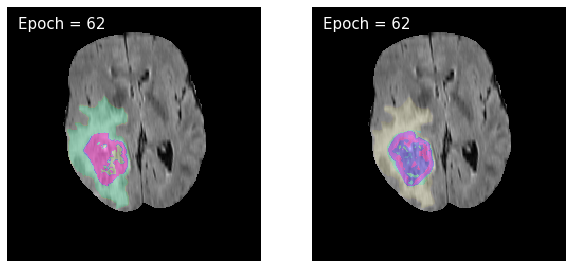

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 2 : train_loss : 0.8979202948960682, valid_loss : 0.897901346927048


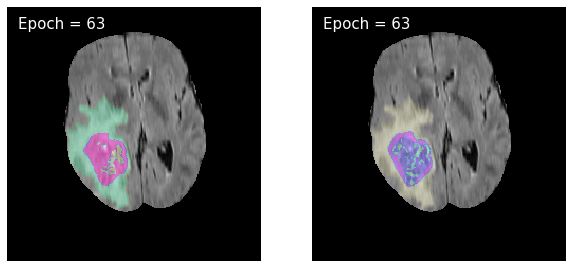

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 2 : train_loss : 0.8977046656928607, valid_loss : 0.8979894715932107


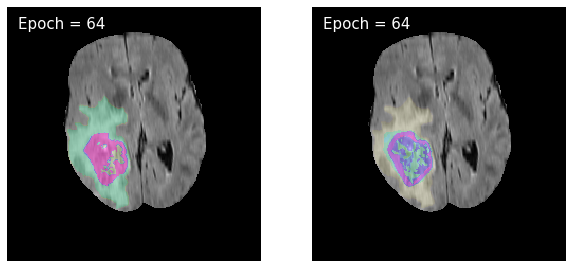

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 2 : train_loss : 0.8977353875535713, valid_loss : 0.8981094759318137


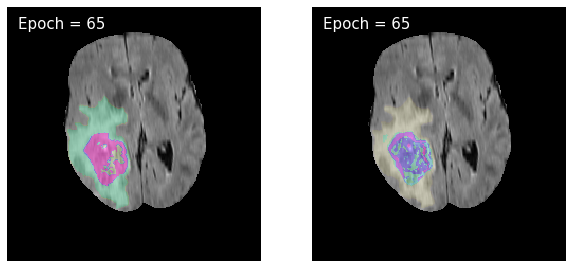

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 2 : train_loss : 0.8986792605728644, valid_loss : 0.8982766800189531


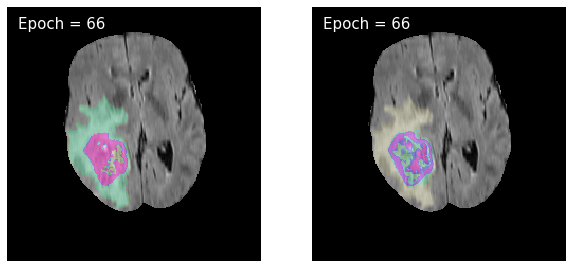

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 2 : train_loss : 0.8977158166951514, valid_loss : 0.8979736758015489


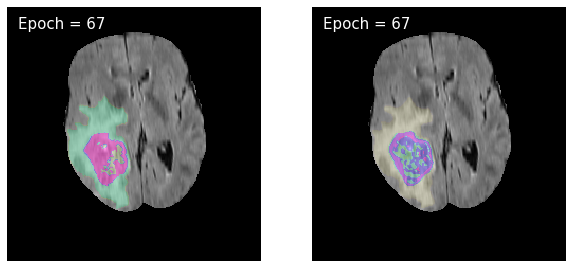

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 2 : train_loss : 0.8975711052849789, valid_loss : 0.8979830052903903


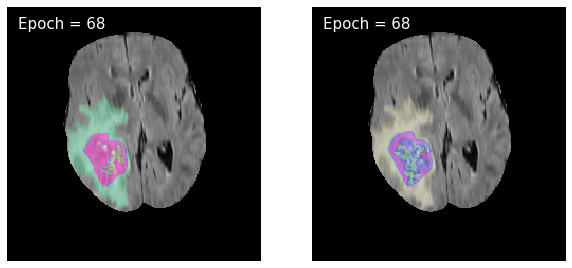

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 2 : train_loss : 0.8974704742431641, valid_loss : 0.8978764087923111


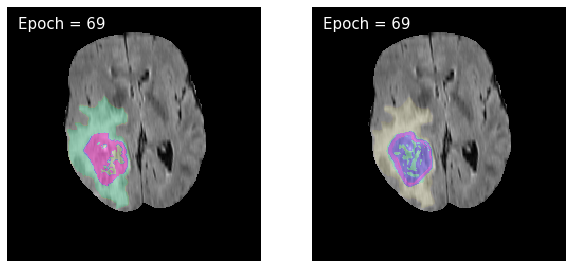

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 2 : train_loss : 0.897440686588586, valid_loss : 0.8976451100841645


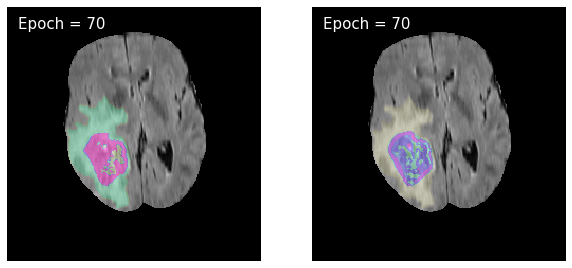

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 2 : train_loss : 0.8974427447489711, valid_loss : 0.8978679383634239


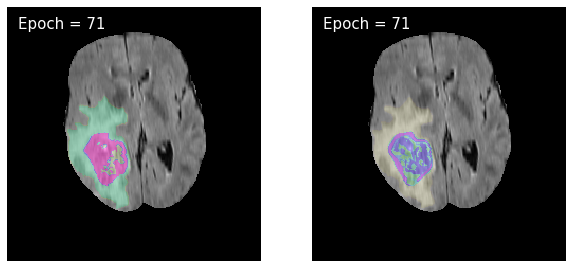

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 2 : train_loss : 0.8980132305382083, valid_loss : 0.9022151868670217


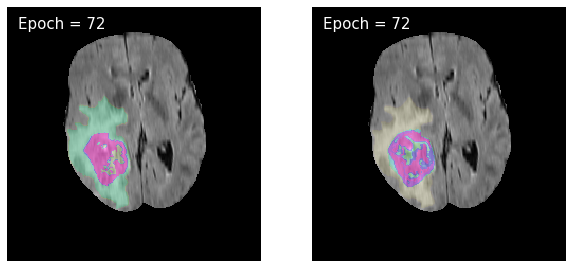

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 2 : train_loss : 0.898151808937124, valid_loss : 0.897697687469503


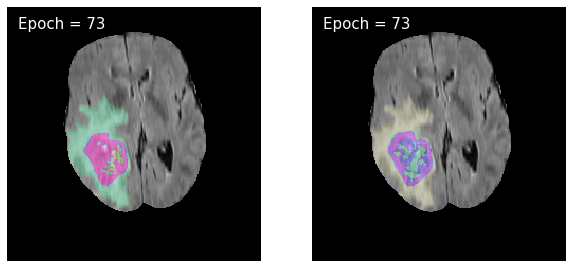

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 2 : train_loss : 0.8974203807395577, valid_loss : 0.8976687085564419


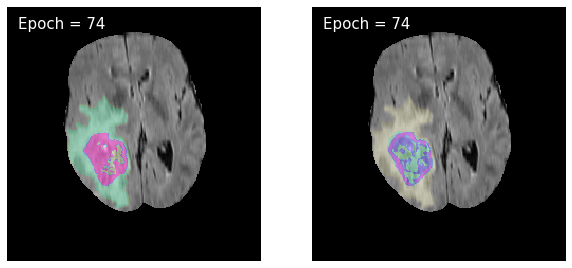

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 2 : train_loss : 0.8973296516693678, valid_loss : 0.8978948990503947


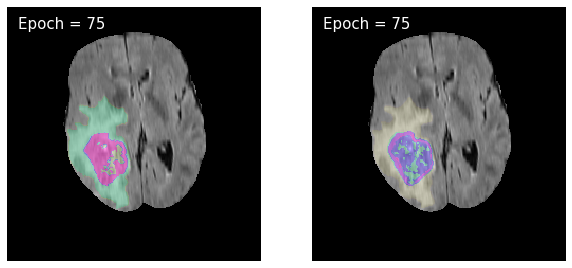

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 2 : train_loss : 0.8973895144675935, valid_loss : 0.8975585073392879


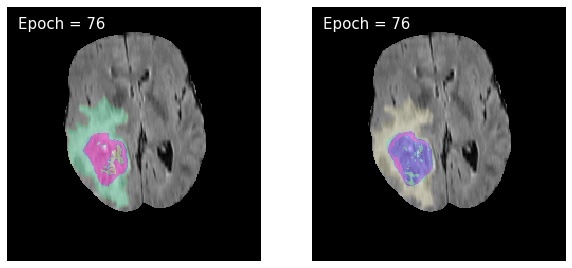

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 2 : train_loss : 0.8974161638776195, valid_loss : 0.8976155148558719


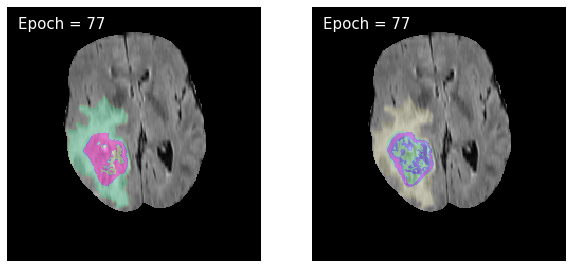

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 2 : train_loss : 0.8972592957867872, valid_loss : 0.89769934967


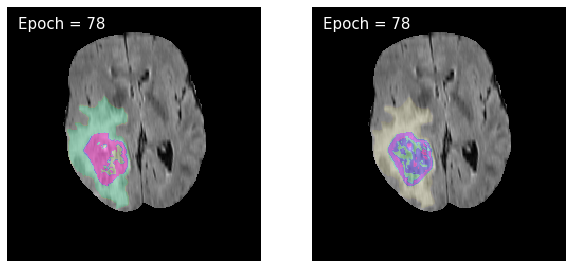

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 2 : train_loss : 0.8972988610032954, valid_loss : 0.8976851871577642


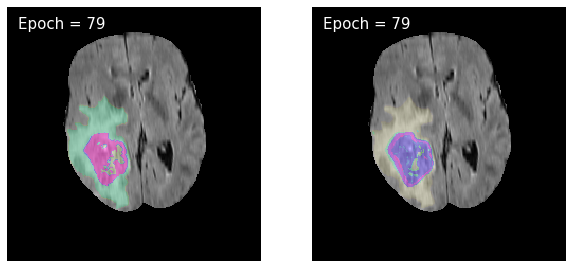

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 81: model 2 : train_loss : 0.8973477541466954, valid_loss : 0.8975476086620362


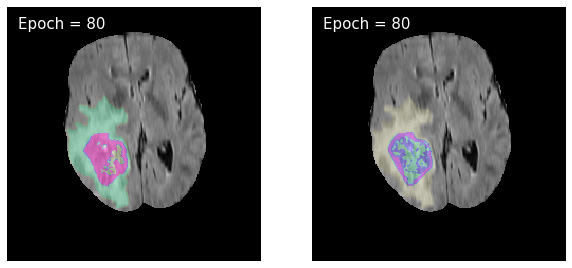

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 82: model 2 : train_loss : 0.8972773253250975, valid_loss : 0.8979798417578462


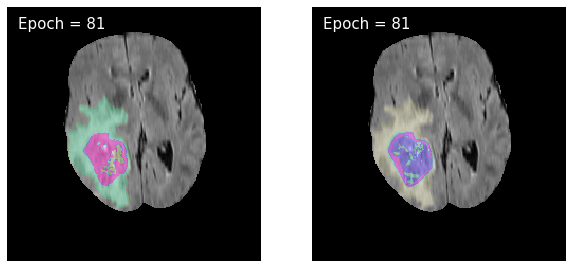

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 83: model 2 : train_loss : 0.8972292010416121, valid_loss : 0.8978857079180338


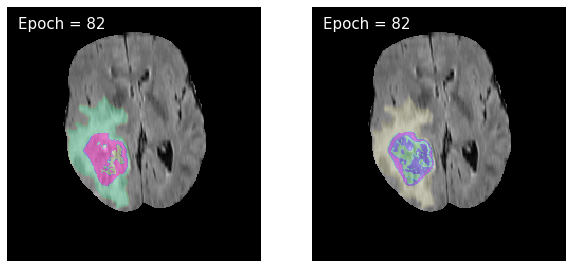

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 84: model 2 : train_loss : 0.8972659256367609, valid_loss : 0.8977004755088078


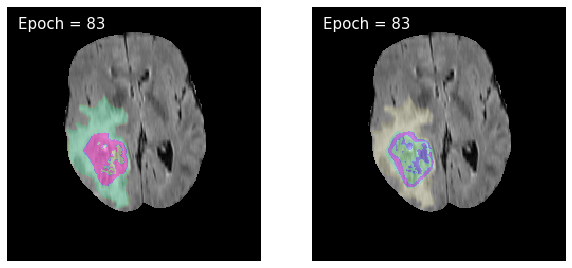

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 85: model 2 : train_loss : 0.8972574585769534, valid_loss : 0.8978614577202386


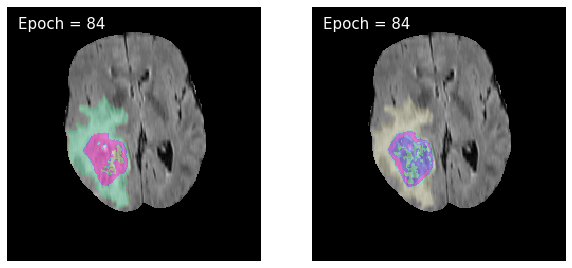

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 86: model 2 : train_loss : 0.8972570301435671, valid_loss : 0.8975497964889773


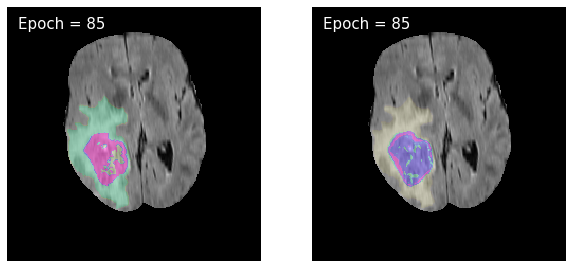

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 87: model 2 : train_loss : 0.8972400285520277, valid_loss : 0.8975092291992198


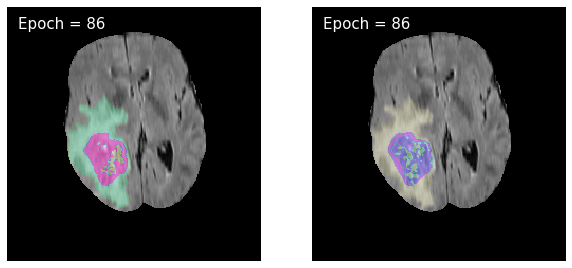

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 88: model 2 : train_loss : 0.8973150303966514, valid_loss : 0.8980047633090327


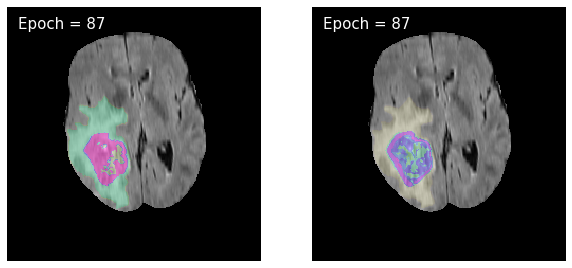

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 89: model 2 : train_loss : 0.8972726217585656, valid_loss : 0.8977215204347846


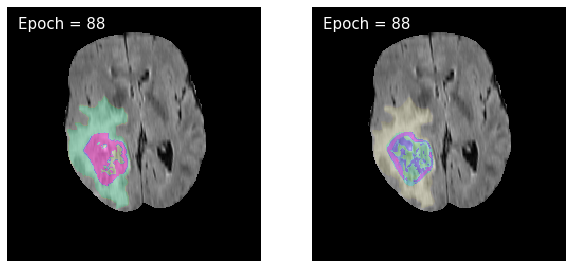

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 90: model 2 : train_loss : 0.8971220724267981, valid_loss : 0.8975625563693302


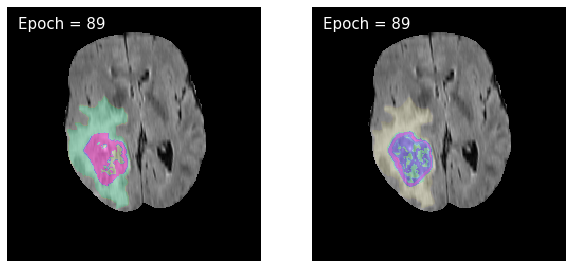

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 91: model 2 : train_loss : 0.8972915877698519, valid_loss : 0.8980128422219266


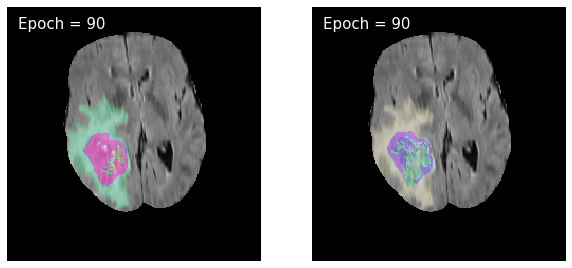

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 92: model 2 : train_loss : 0.8973070620423729, valid_loss : 0.8974540893749524


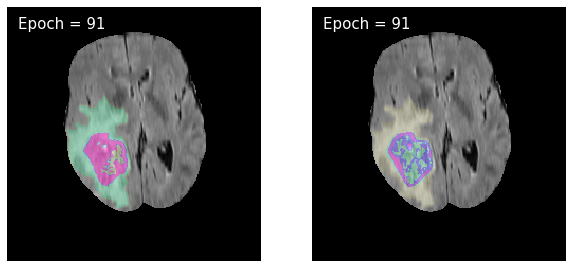

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 93: model 2 : train_loss : 0.8972003442595736, valid_loss : 0.897623778911688


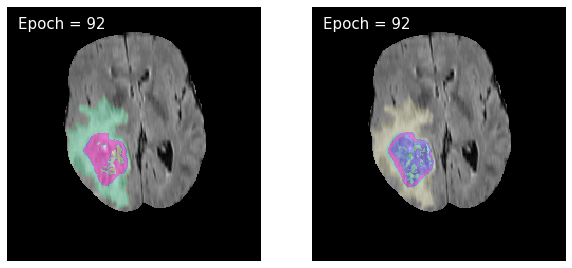

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 94: model 2 : train_loss : 0.8981361817193512, valid_loss : 0.9029277653623653


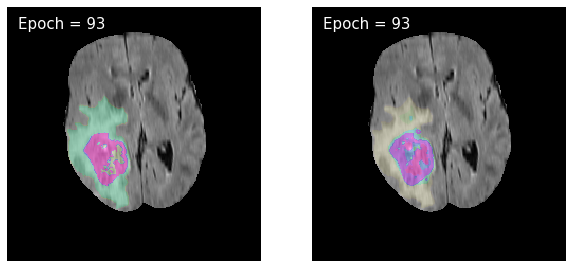

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 95: model 2 : train_loss : 0.8978408272367729, valid_loss : 0.8974993163219063


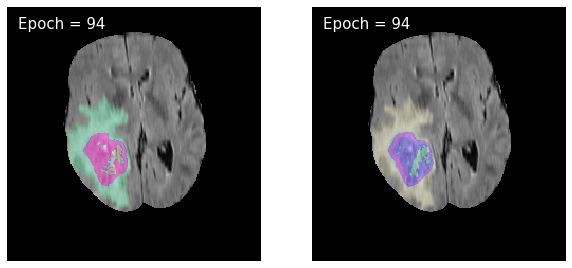

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 96: model 2 : train_loss : 0.8971052599166597, valid_loss : 0.8973709407352632


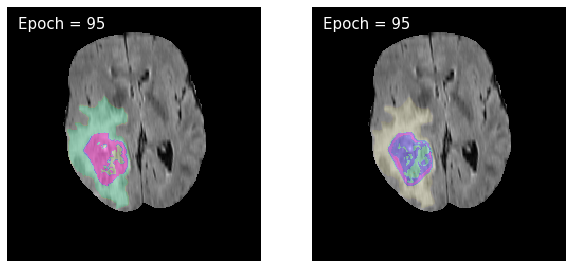

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 97: model 2 : train_loss : 0.8969853020354406, valid_loss : 0.8973465351167546


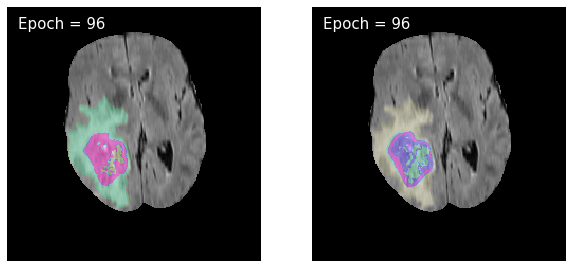

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 98: model 2 : train_loss : 0.8969537878463198, valid_loss : 0.8973927795085855


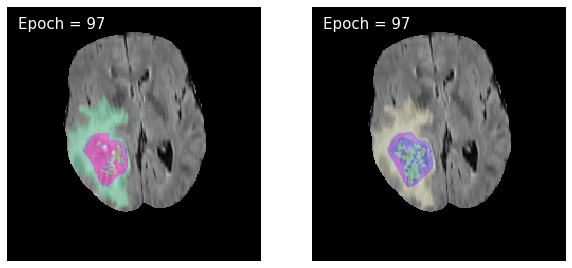

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 99: model 2 : train_loss : 0.8970290466443004, valid_loss : 0.8973328167552589


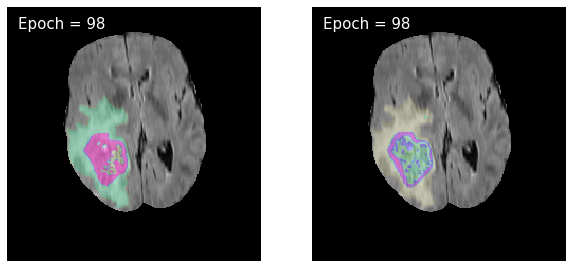

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 100: model 2 : train_loss : 0.8969549167342901, valid_loss : 0.8973972648382187


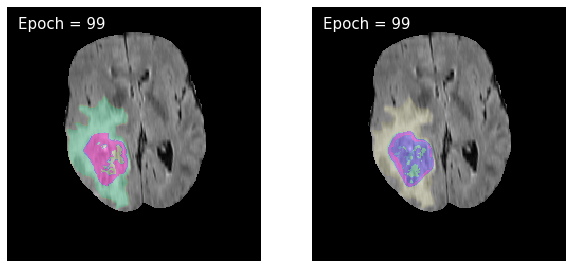

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 101: model 2 : train_loss : 0.896990157213787, valid_loss : 0.8972628772739442


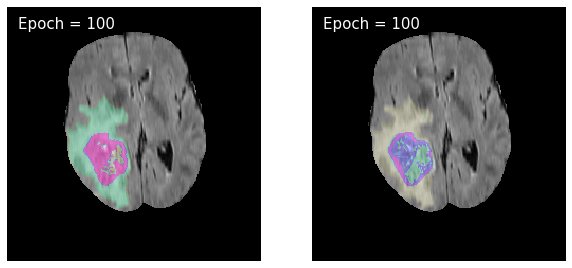

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 102: model 2 : train_loss : 0.896996123278701, valid_loss : 0.8974460695059069


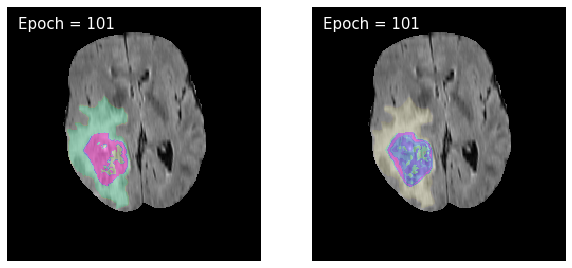

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 103: model 2 : train_loss : 0.8971311651353602, valid_loss : 0.8973110636235565


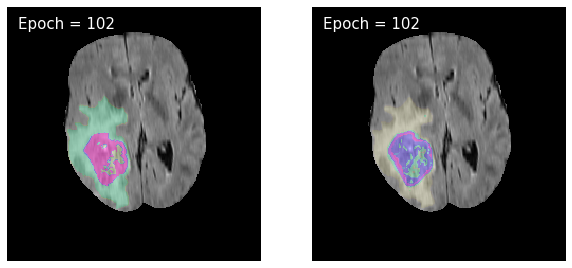

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 104: model 2 : train_loss : 0.8969209727558247, valid_loss : 0.8973538206629855


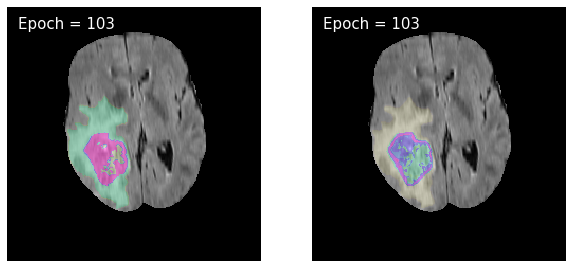

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 105: model 2 : train_loss : 0.8970144321721139, valid_loss : 0.89743243165875


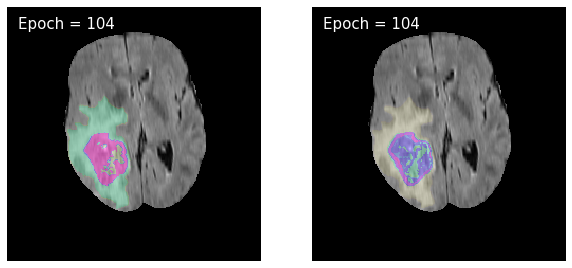

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 106: model 2 : train_loss : 0.8971786556361239, valid_loss : 0.8976295087286221


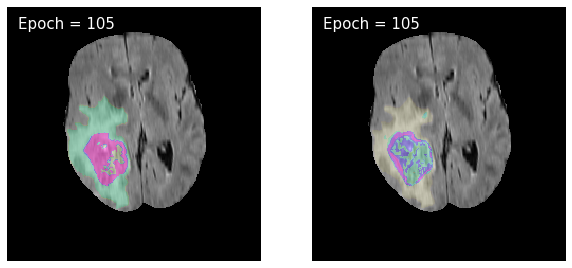

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 107: model 2 : train_loss : 0.8969164022663295, valid_loss : 0.8974901958498903


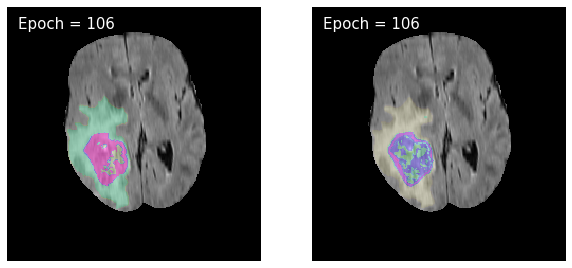

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 108: model 2 : train_loss : 0.8969114210781635, valid_loss : 0.8972909896764704


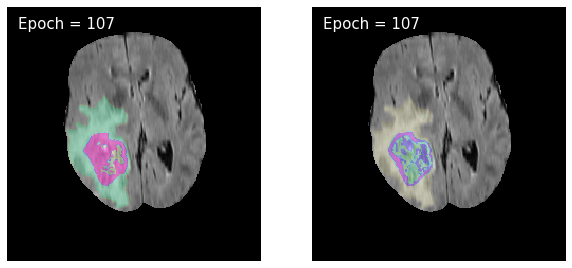

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 109: model 2 : train_loss : 0.8968715449040902, valid_loss : 0.8979197153320877


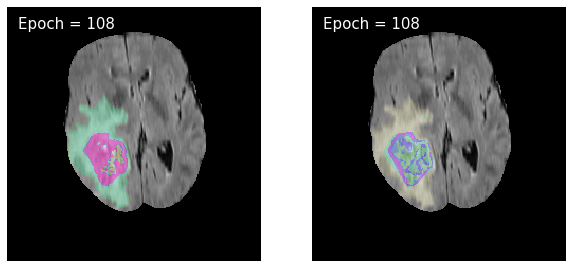

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 110: model 2 : train_loss : 0.8969251633490491, valid_loss : 0.8975203005216454


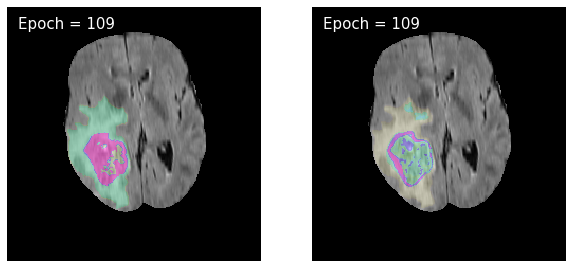

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 111: model 2 : train_loss : 0.9002392292022705, valid_loss : 0.8992054268557538


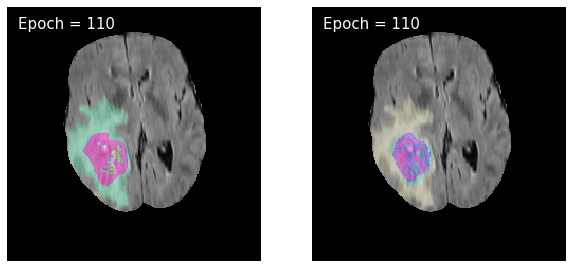

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 112: model 2 : train_loss : 0.8976158851745145, valid_loss : 0.8973834368810859


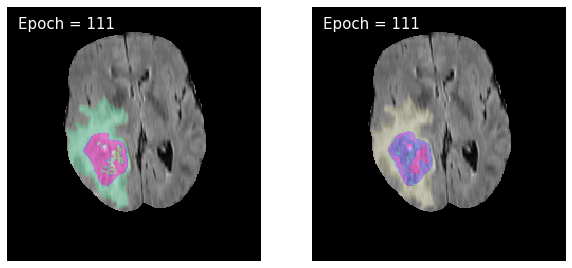

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 113: model 2 : train_loss : 0.8970347089522104, valid_loss : 0.89737078659637


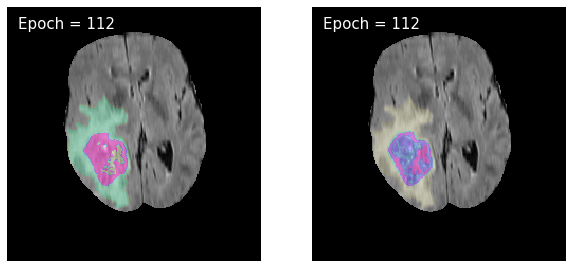

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 114: model 2 : train_loss : 0.8969628748211018, valid_loss : 0.8974708504574274


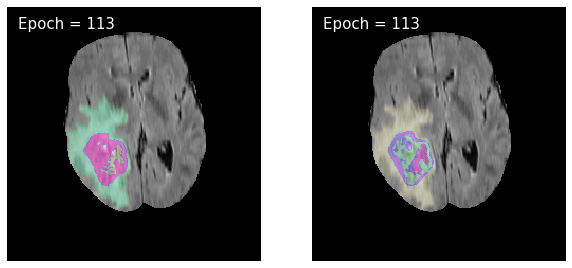

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 115: model 2 : train_loss : 0.8968881932681039, valid_loss : 0.8973239153142898


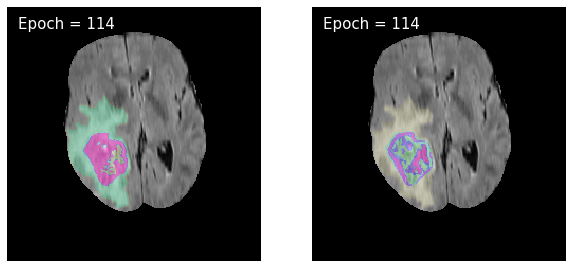

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 116: model 2 : train_loss : 0.896827711888341, valid_loss : 0.8974493594579799


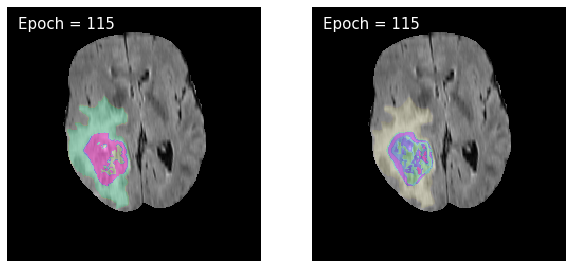

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 117: model 2 : train_loss : 0.8967983800026128, valid_loss : 0.8975483682206882


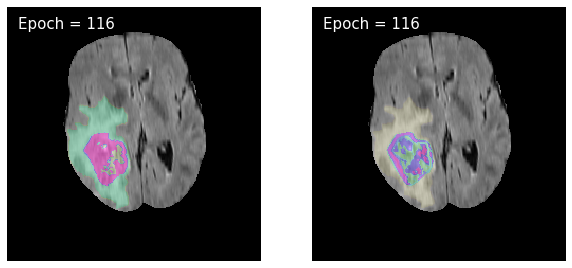

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 118: model 2 : train_loss : 0.8968723257649398, valid_loss : 0.8971680925097517


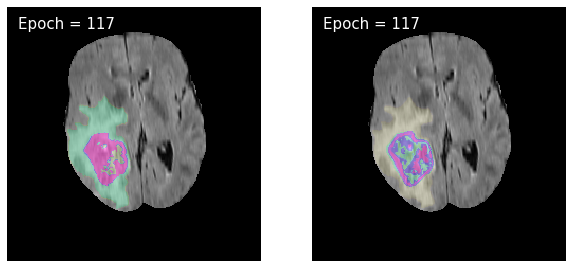

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 119: model 2 : train_loss : 0.8967437714805006, valid_loss : 0.8973436873125774


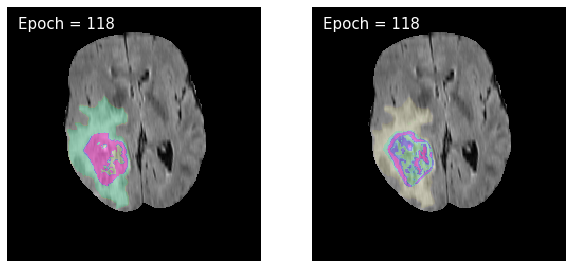

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 120: model 2 : train_loss : 0.8967847048036204, valid_loss : 0.89743936526519


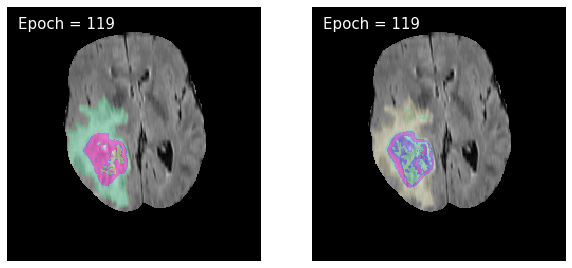

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 121: model 2 : train_loss : 0.8968858878884539, valid_loss : 0.8975505135072175


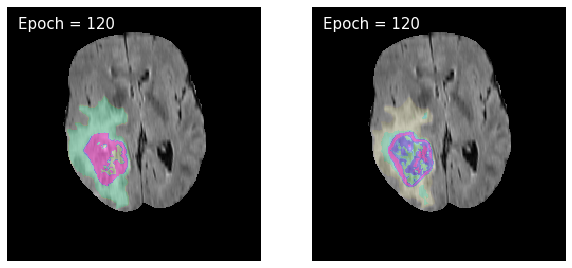

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 122: model 2 : train_loss : 0.8969949583879253, valid_loss : 0.8974889564898706


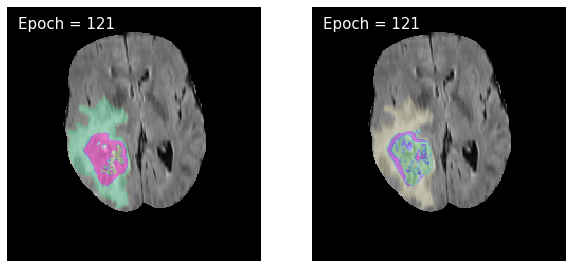

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 123: model 2 : train_loss : 0.8968264744585792, valid_loss : 0.8973223090332042


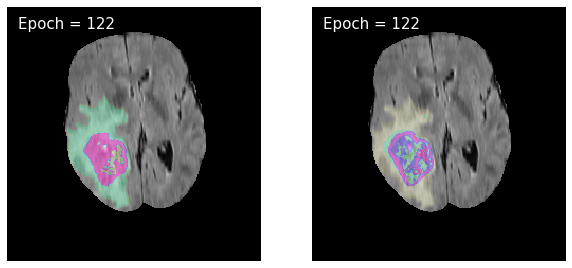

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 124: model 2 : train_loss : 0.896787646899554, valid_loss : 0.8972788175908468


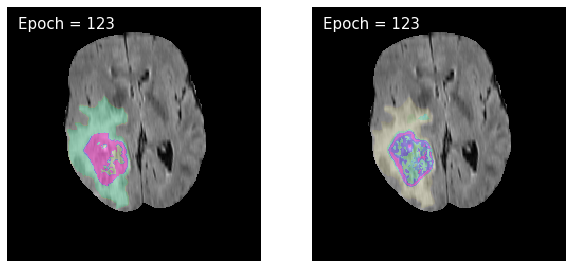

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 125: model 2 : train_loss : 0.8967761352024889, valid_loss : 0.8972996343528071


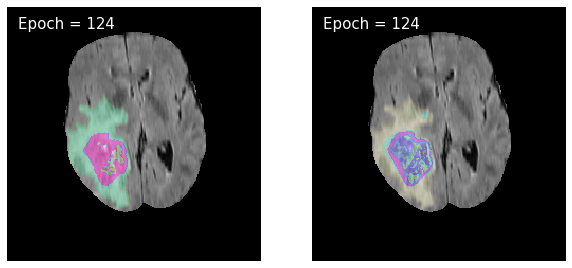

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 126: model 2 : train_loss : 0.8971795279707685, valid_loss : 0.8974878236811649


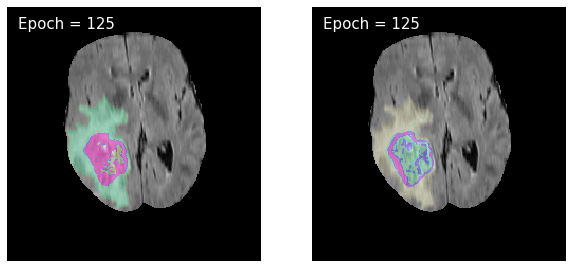

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 127: model 2 : train_loss : 0.8968666487892202, valid_loss : 0.897650598197855


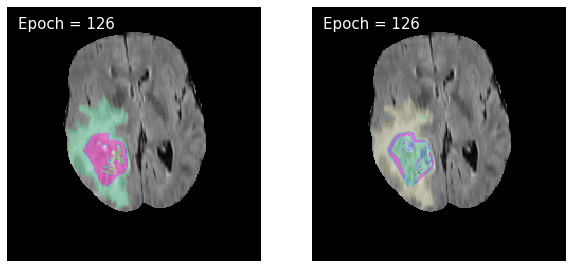

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 128: model 2 : train_loss : 0.8969049891102767, valid_loss : 0.897445612777305


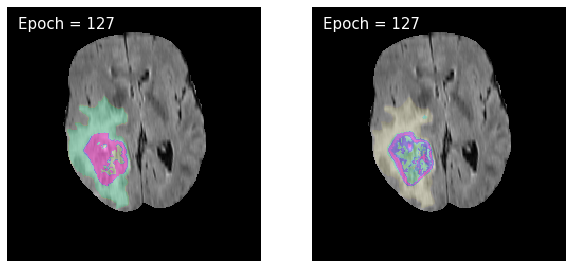

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 129: model 2 : train_loss : 0.8967785547243668, valid_loss : 0.8974294760214385


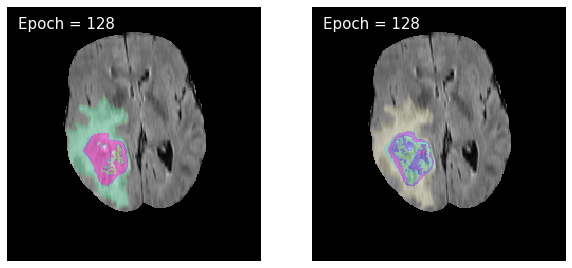

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 130: model 2 : train_loss : 0.8967010349501966, valid_loss : 0.8971874579306571


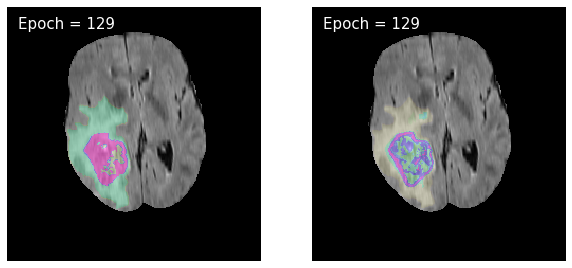

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 131: model 2 : train_loss : 0.8966960802974316, valid_loss : 0.8972521171134006


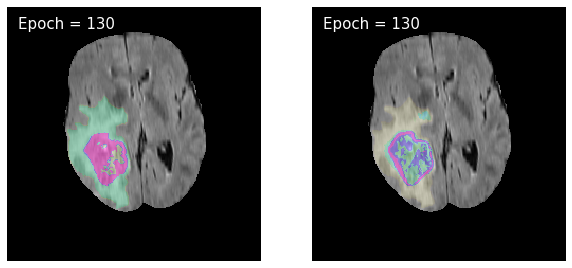

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 132: model 2 : train_loss : 0.8968326421392044, valid_loss : 0.8973785879150513


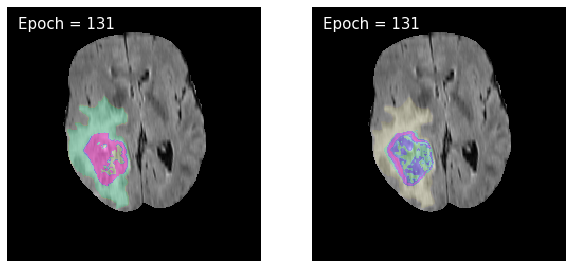

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 133: model 2 : train_loss : 0.8968638296362005, valid_loss : 0.8973759862203752


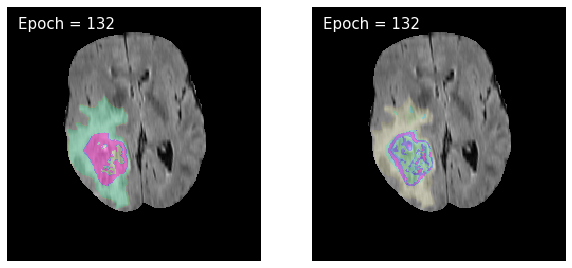

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 134: model 2 : train_loss : 0.8967180732112603, valid_loss : 0.8973594385609832


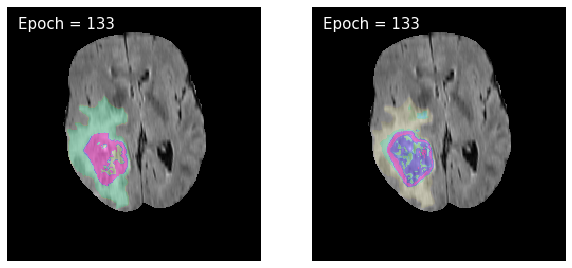

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 135: model 2 : train_loss : 0.8967515030163247, valid_loss : 0.8971912507568637


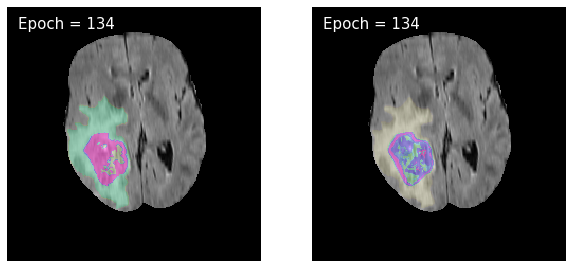

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 136: model 2 : train_loss : 0.8967182477581954, valid_loss : 0.8975259319588702


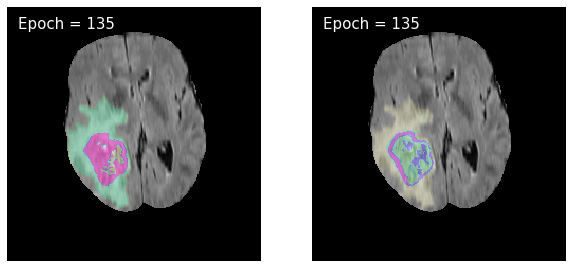

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 137: model 2 : train_loss : 0.8966292048193998, valid_loss : 0.8972862544719891


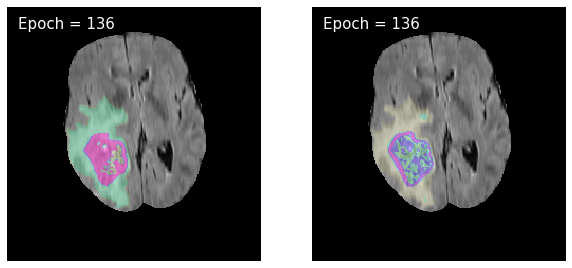

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 138: model 2 : train_loss : 0.8967044008124861, valid_loss : 0.8977462754294436


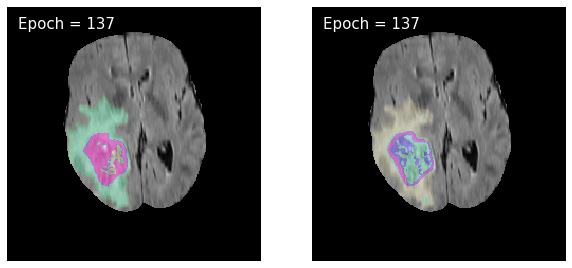

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 139: model 2 : train_loss : 0.8967166184312279, valid_loss : 0.897273467433068


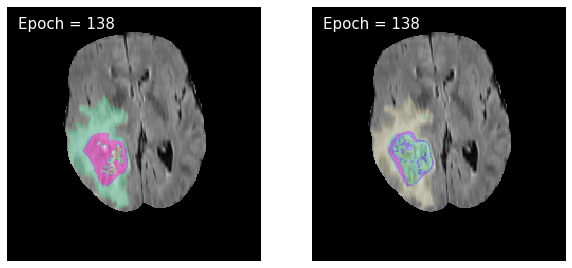

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 140: model 2 : train_loss : 0.896401496141549, valid_loss : 0.8969855391851036


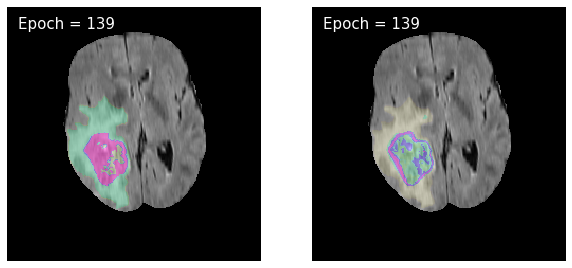

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 141: model 2 : train_loss : 0.8962897537005294, valid_loss : 0.8969777820892232


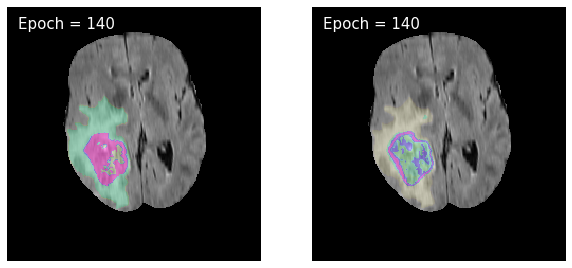

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 142: model 2 : train_loss : 0.8962566695223986, valid_loss : 0.896965455624365


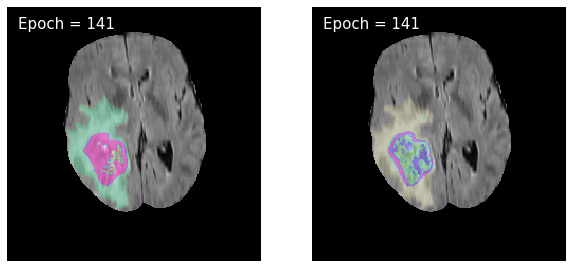

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 143: model 2 : train_loss : 0.896228876423249, valid_loss : 0.8969864576894749


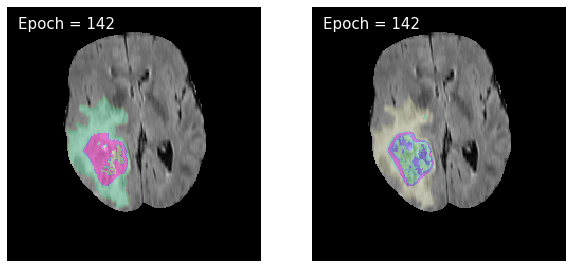

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 144: model 2 : train_loss : 0.8962122225921426, valid_loss : 0.8969584106597849


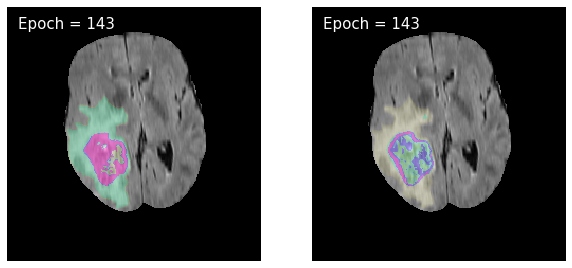

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 145: model 2 : train_loss : 0.89619425025829, valid_loss : 0.8969547871139741


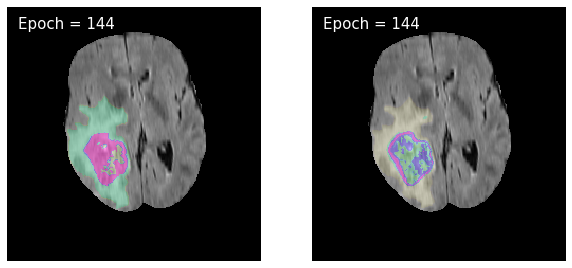

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 146: model 2 : train_loss : 0.896177570558501, valid_loss : 0.8969566376619441


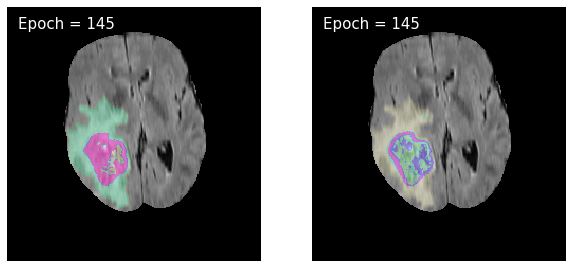

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 147: model 2 : train_loss : 0.896160664974443, valid_loss : 0.8969805666035221


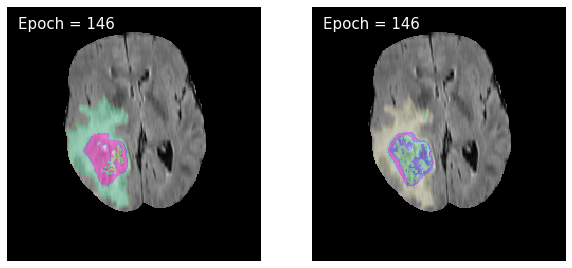

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 148: model 2 : train_loss : 0.8961517202774151, valid_loss : 0.8969604710257182


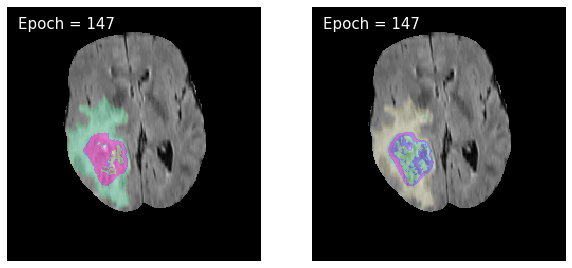

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 149: model 2 : train_loss : 0.896141506281475, valid_loss : 0.8969787334402403


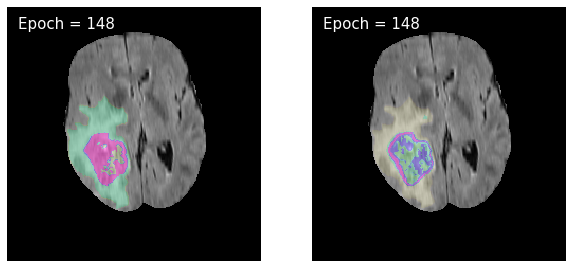

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 150: model 2 : train_loss : 0.8961267918014953, valid_loss : 0.8970090325481148


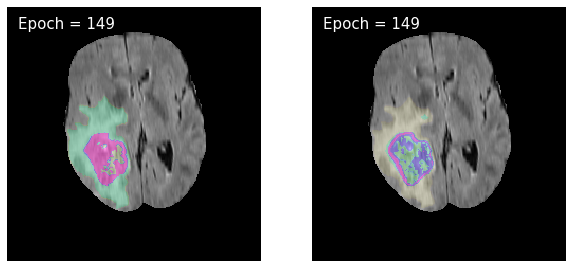

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 151: model 2 : train_loss : 0.8961188469157123, valid_loss : 0.8969722895692753


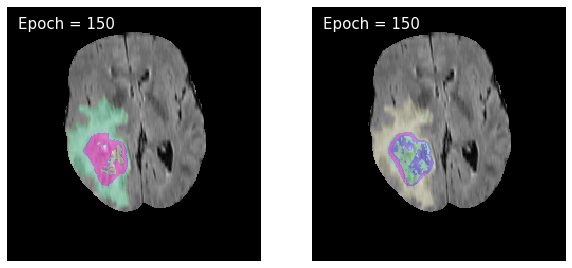

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 152: model 2 : train_loss : 0.8960980539620589, valid_loss : 0.8969971713039183


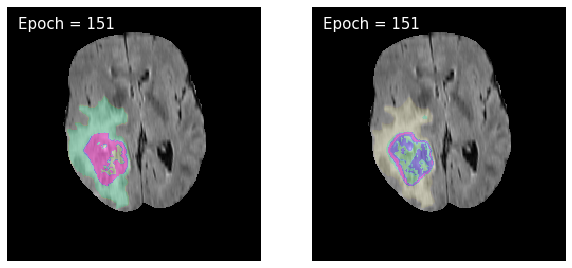

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 153: model 2 : train_loss : 0.8960864993283146, valid_loss : 0.8970086672293243


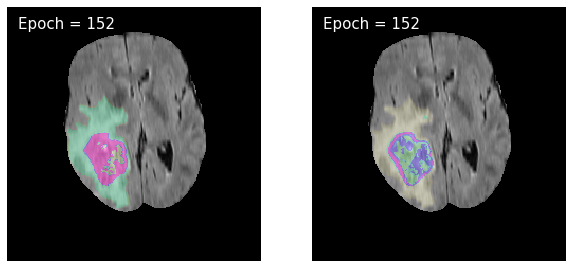

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 154: model 2 : train_loss : 0.8960835876347502, valid_loss : 0.8970070177669166


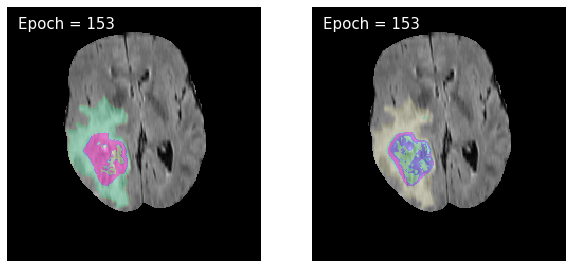

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 155: model 2 : train_loss : 0.8960675825208626, valid_loss : 0.8970229234746707


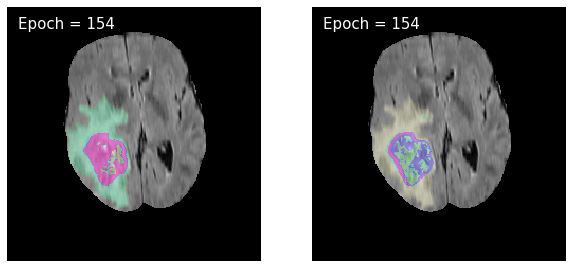

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 156: model 2 : train_loss : 0.89605449950135, valid_loss : 0.8970292594323876


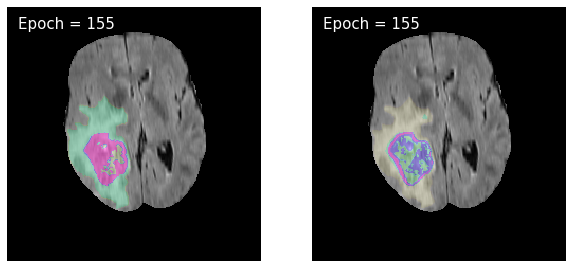

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 157: model 2 : train_loss : 0.8960467496974356, valid_loss : 0.8969932704843501


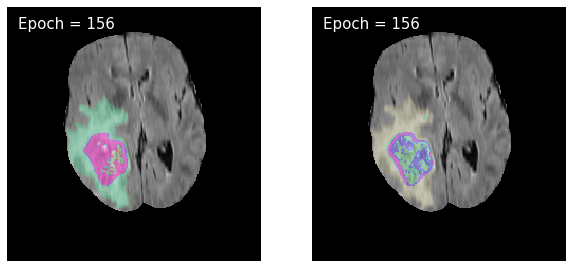

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 158: model 2 : train_loss : 0.8960324687179037, valid_loss : 0.8970400876896356


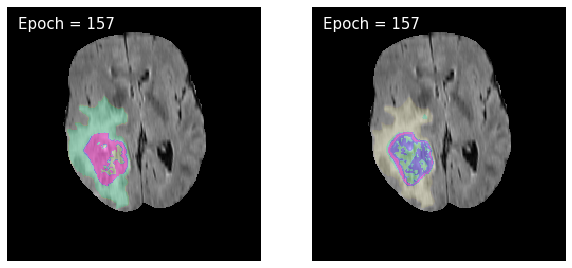

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 159: model 2 : train_loss : 0.8960239481872627, valid_loss : 0.8970402578512827


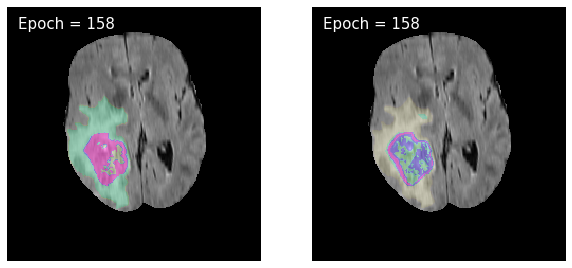

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 160: model 2 : train_loss : 0.8960139403407206, valid_loss : 0.8970691274891618


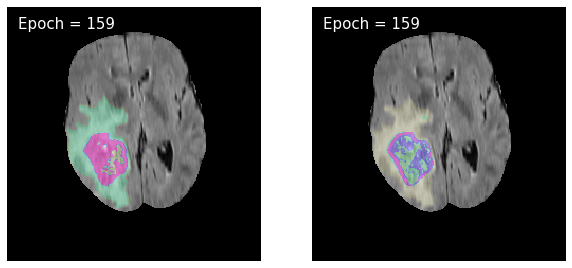

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 161: model 2 : train_loss : 0.8960019220708467, valid_loss : 0.8970902623829021


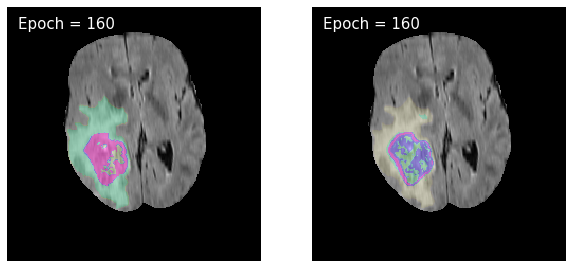

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 162: model 2 : train_loss : 0.8959757542983531, valid_loss : 0.8970592774210437


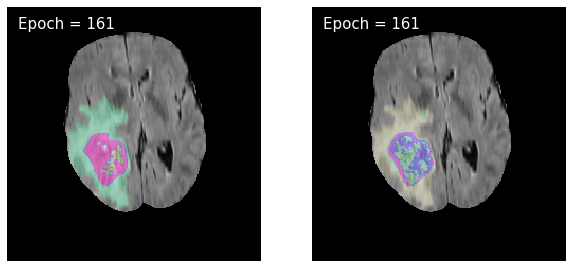

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 163: model 2 : train_loss : 0.8959647203718523, valid_loss : 0.8970891152338315


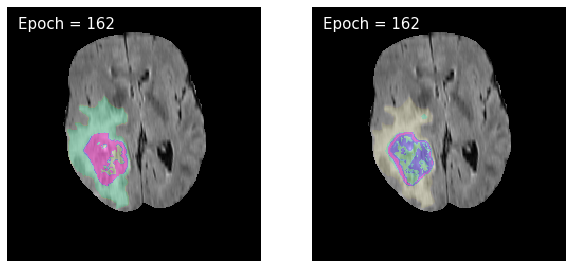

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 164: model 2 : train_loss : 0.8959645944953765, valid_loss : 0.8970546024621174


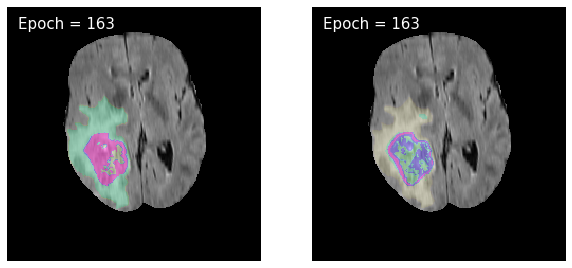

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 165: model 2 : train_loss : 0.8959573055273734, valid_loss : 0.8970827804778212


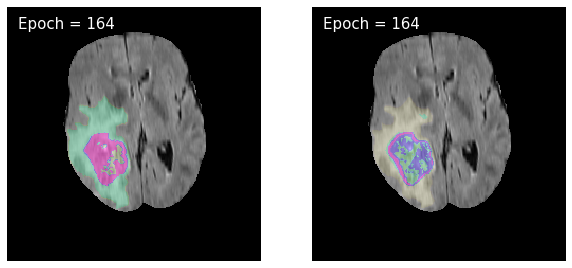

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 166: model 2 : train_loss : 0.8959555531241483, valid_loss : 0.8970810254254649


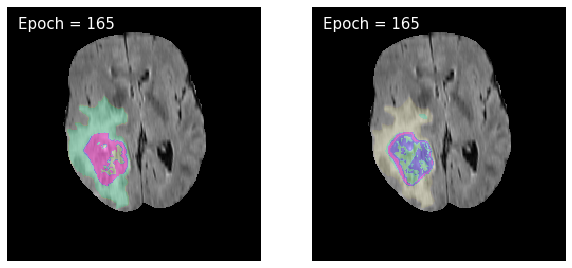

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 167: model 2 : train_loss : 0.8959527037021031, valid_loss : 0.8970857873078315


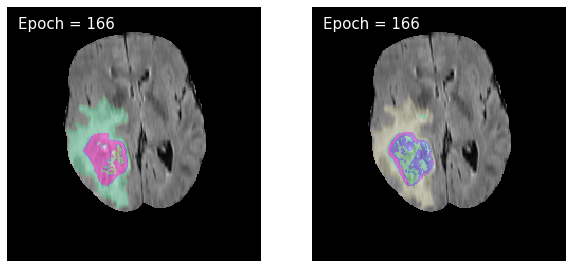

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 168: model 2 : train_loss : 0.8959506960789896, valid_loss : 0.8970724900243103


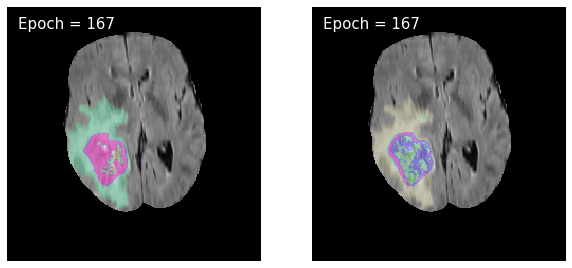

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 169: model 2 : train_loss : 0.8959466698985772, valid_loss : 0.897095414098873


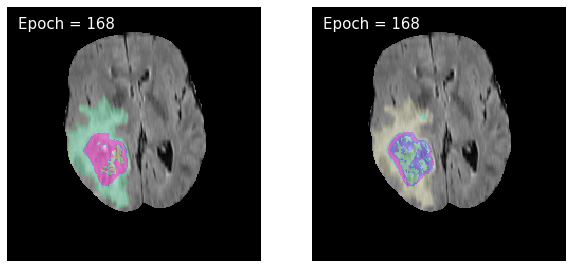

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 170: model 2 : train_loss : 0.8959494847845978, valid_loss : 0.8970861587953823


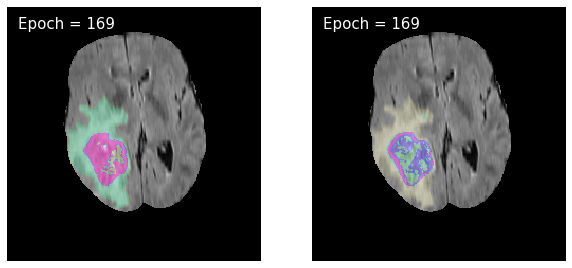

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 171: model 2 : train_loss : 0.8959467876410858, valid_loss : 0.8971369811283645


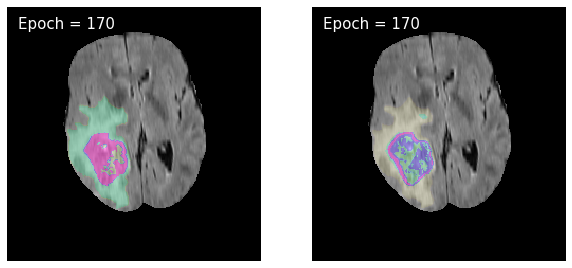

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 172: model 2 : train_loss : 0.8959460662515372, valid_loss : 0.8970836534775714


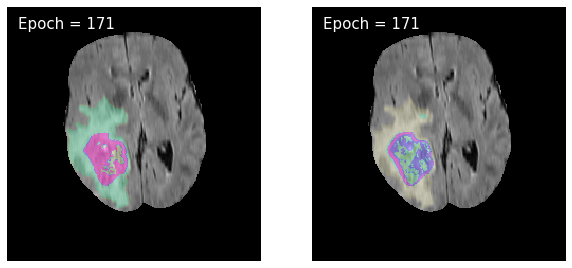

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 173: model 2 : train_loss : 0.8959417707168016, valid_loss : 0.8970831515648032


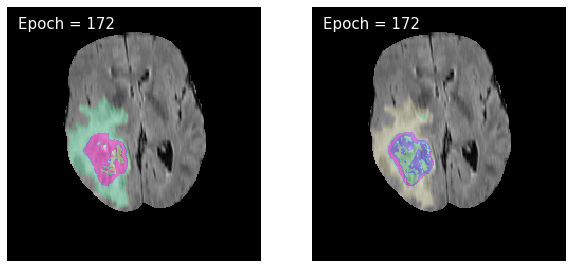

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 174: model 2 : train_loss : 0.8959462130629776, valid_loss : 0.8971072103708021


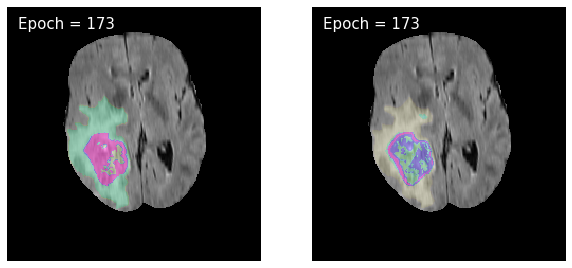

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 175: model 2 : train_loss : 0.8959420884748966, valid_loss : 0.8970899290295058


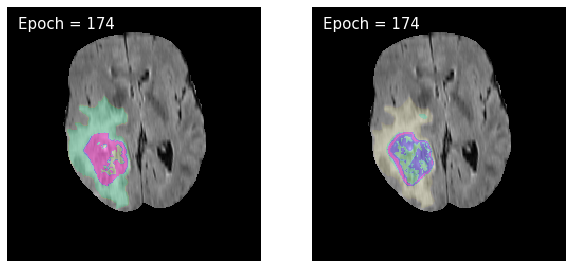

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 176: model 2 : train_loss : 0.8959368958035838, valid_loss : 0.8971389947078561


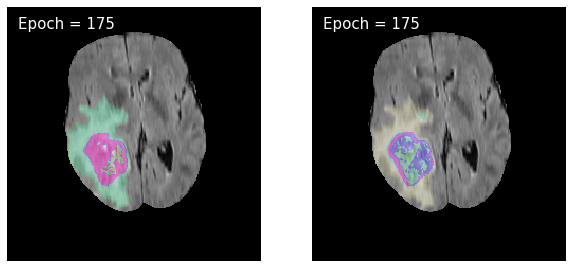

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 177: model 2 : train_loss : 0.8959360788065849, valid_loss : 0.8971020574531248


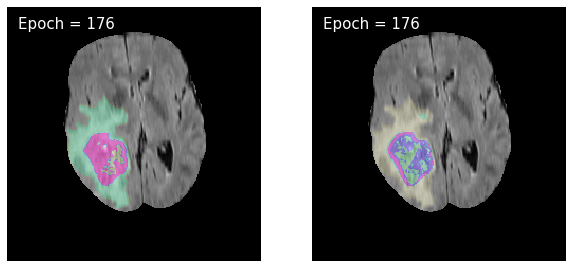

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 178: model 2 : train_loss : 0.8959349175160897, valid_loss : 0.8971394801973015


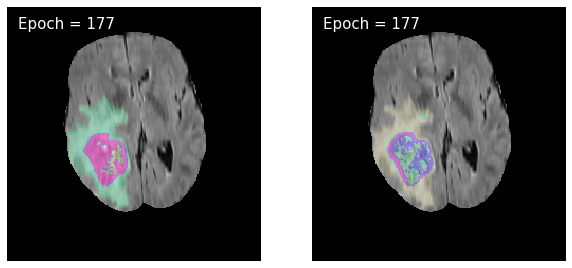

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 179: model 2 : train_loss : 0.8959388370215227, valid_loss : 0.8971175919136694


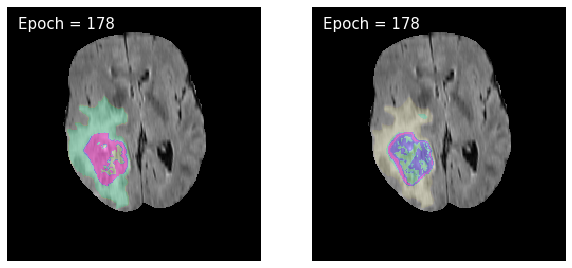

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 180: model 2 : train_loss : 0.8959319799538427, valid_loss : 0.8971133267366758


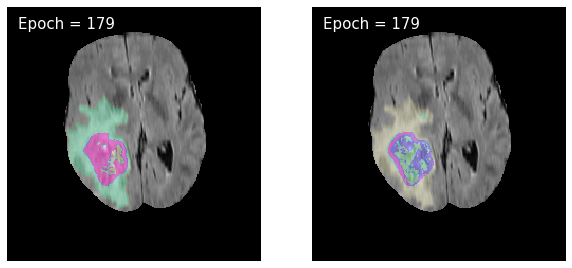

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 181: model 2 : train_loss : 0.8959359470629852, valid_loss : 0.8971158843687785


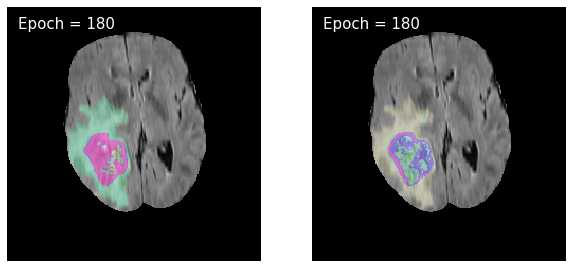

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 182: model 2 : train_loss : 0.8959317779381003, valid_loss : 0.8971090808671008


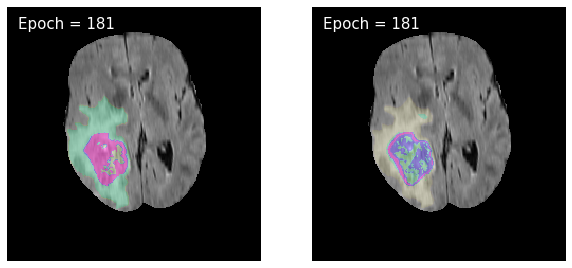

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 183: model 2 : train_loss : 0.8959252174268633, valid_loss : 0.8971061452582318


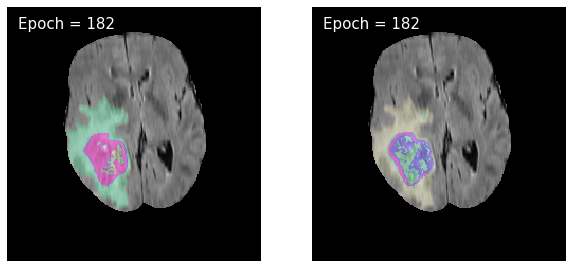

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 184: model 2 : train_loss : 0.8959307935947273, valid_loss : 0.8971105415814666


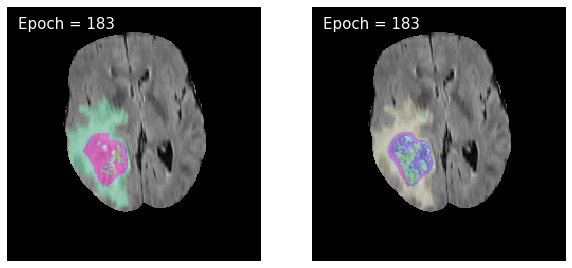

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 185: model 2 : train_loss : 0.8959271342429005, valid_loss : 0.8971057816218304


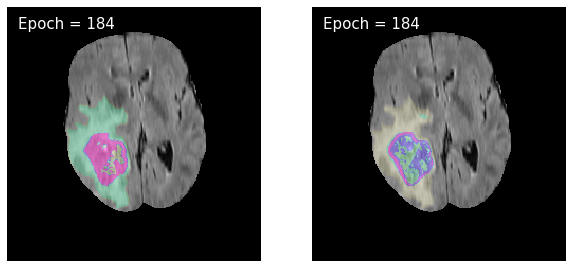

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 186: model 2 : train_loss : 0.8959291833359123, valid_loss : 0.8971187677434695


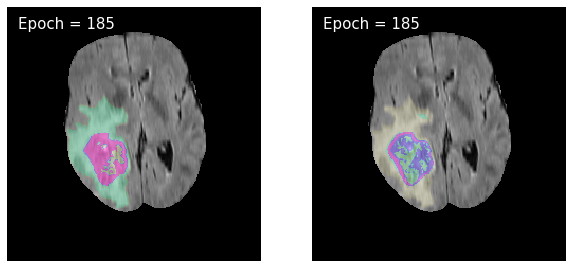

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 187: model 2 : train_loss : 0.8959283798066295, valid_loss : 0.8971122064257181


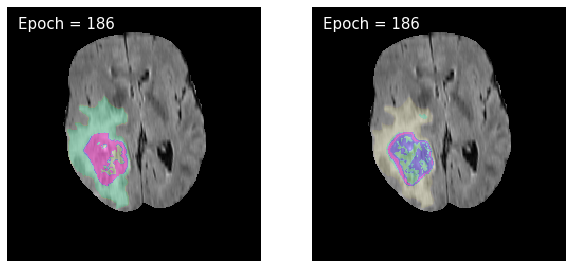

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 188: model 2 : train_loss : 0.8959236667726931, valid_loss : 0.897115760272549


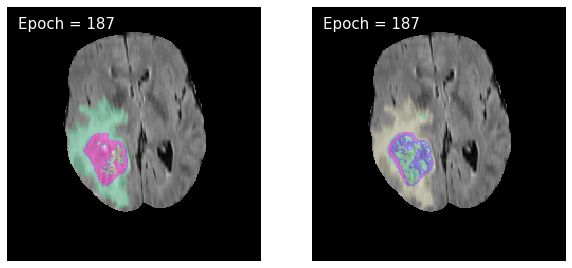

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 189: model 2 : train_loss : 0.8959262635083807, valid_loss : 0.8971172747432544


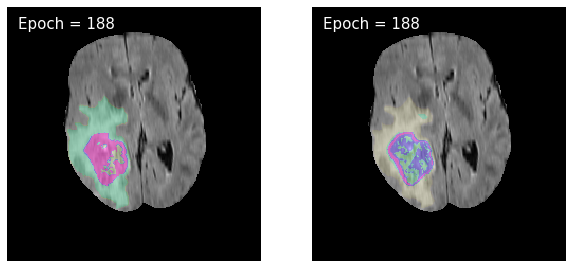

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 190: model 2 : train_loss : 0.8959263805841706, valid_loss : 0.8971234294035102


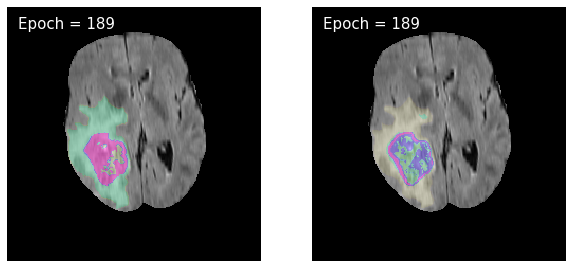

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 191: model 2 : train_loss : 0.8959262079040476, valid_loss : 0.8971285556433022


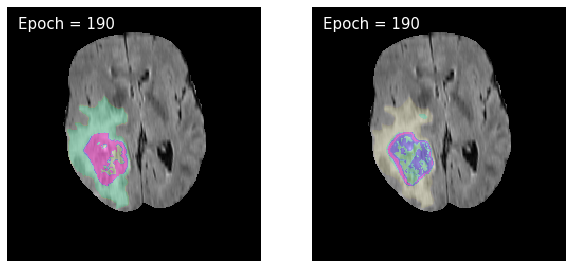

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 192: model 2 : train_loss : 0.8959317145998312, valid_loss : 0.8971128115250219


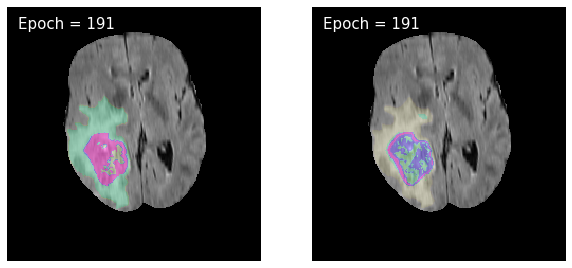

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 193: model 2 : train_loss : 0.8959301178087324, valid_loss : 0.8971228993708088


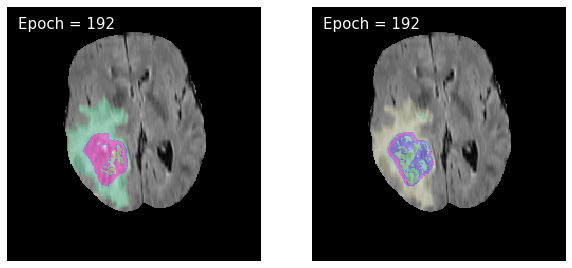

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 194: model 2 : train_loss : 0.8959277085543212, valid_loss : 0.8971257017504785


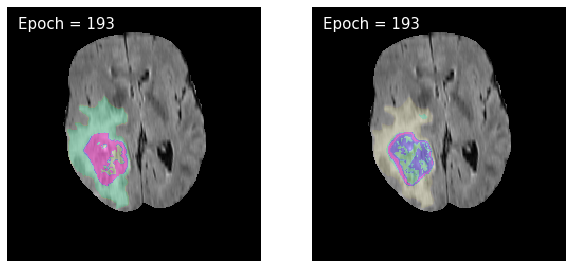

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 195: model 2 : train_loss : 0.8959256543942479, valid_loss : 0.897097137586404


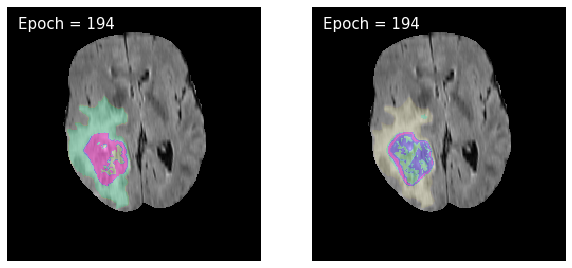

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 196: model 2 : train_loss : 0.8959298921911508, valid_loss : 0.8971234571228746


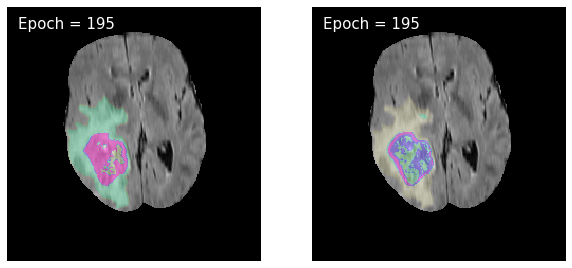

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 197: model 2 : train_loss : 0.8959233276796021, valid_loss : 0.8971302768876476


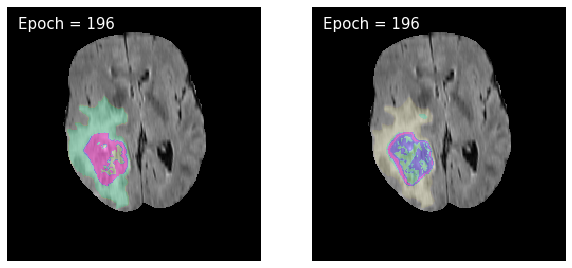

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 198: model 2 : train_loss : 0.8959287669034612, valid_loss : 0.8971198910186368


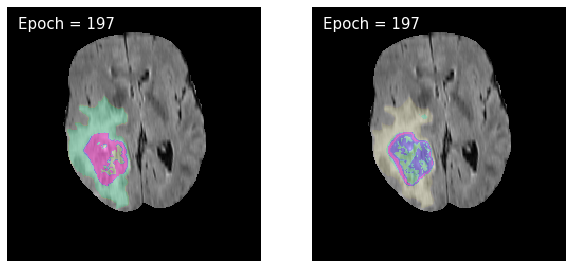

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 199: model 2 : train_loss : 0.8959248625992129, valid_loss : 0.897109754383564


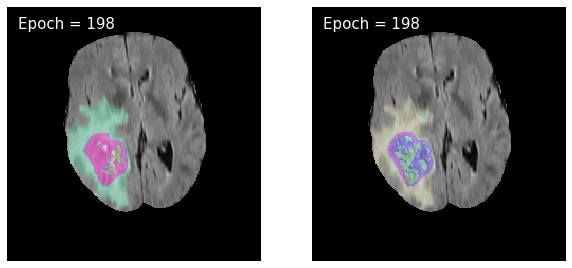

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 200: model 2 : train_loss : 0.8959265076607399, valid_loss : 0.897097727944774


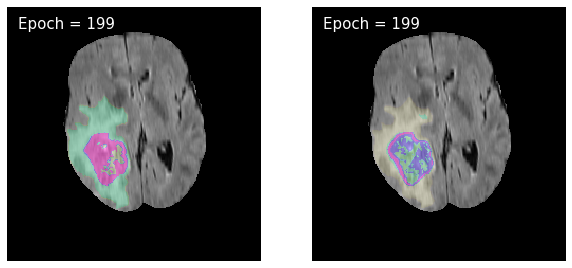

In [16]:
model_1.load_state_dict(torch.load(f"./model/2_case_unet_ver_1.pt"))
model_1.eval()
    
loss_2 =0.
min_valid_loss = np.inf
train_loss_list_2 = []
valid_loss_list_2 = []

for i in tqdm(range(num_epoch)):
    train_loss_2 = 0.0
    valid_loss_2 = 0.0
    model_2.train()
    
    for image,label in tqdm(train_loader, leave=False):
      
        optimizer_2.zero_grad()
        image,label= image.to(device), label.to(device)
        with torch.no_grad():
            output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
        # output_2 = threshold_img(output_2)
        loss_2   = loss_func(output_2, label)  #0:normal data 
       
        loss_2.backward()
        optimizer_2.step()
        train_loss_2 += loss_2.item()*image.size(0)#
    # train_loss_2 = train_loss_2/len(train_loader.sampler)
        


    with torch.no_grad():
        model_2.eval()    

        for image, label in tqdm(valid_loader, leave=False):

            image,label = image.to(device),label.to(device)
            output = model_1(image)
            output_2 = model_2(image)
            check = threshold_img(output)
            output_2 = output_2*check
            output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
            loss_2 = loss_func(output_2, label)  #0:normal data 
            valid_loss_2 += loss_2.item()*image.size(0)
        scheduler_2.step(valid_loss_2)
    if min_valid_loss>=valid_loss_2:
    # torch.save(model.module.state_dict(),'model_best_'+ str(fold) + '.pt')
    # torch.save(model.state_dict(), './model/3x3_model_{}.pt'.format(i+1))
        torch.save(model_2.state_dict(), f'./model/{save_2}.pt')
    
    train_loss_2 = train_loss_2/len(train_loader.sampler)
    valid_loss_2 = valid_loss_2/len(valid_loader.sampler)
    
    print('Epoch {}: model 2 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_2, valid_loss_2))
    train_loss_list_2.append(train_loss_2)
    valid_loss_list_2.append(valid_loss_2)
    
    ##################show the image
    with torch.no_grad():
        pltimage = pltimage.to(device) # 4stack이미지를 
        output_1 = model_1(pltimage)     # 일단 넣고 
        pltout = model_2(pltimage)

        check = threshold_img(output_1) # 0.5 매핑
        pltout = pltout*check
        pltout[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
        pltout = threshold_img(pltout)
        # imshow1(plt1)
        pltout = pltout.squeeze().detach().cpu().numpy()
        param = pltout[1] + pltout[2]*2 +pltout[3]*3 +pltout[4]*4
        # Bimshow(param, i)    
        Bimshow_2(plt1,show_label,param,i)
        plt.savefig('./image/model_2_4to5/{}th_result.png'.format(i), dpi=300, facecolor='None')
        plt.show()        
    

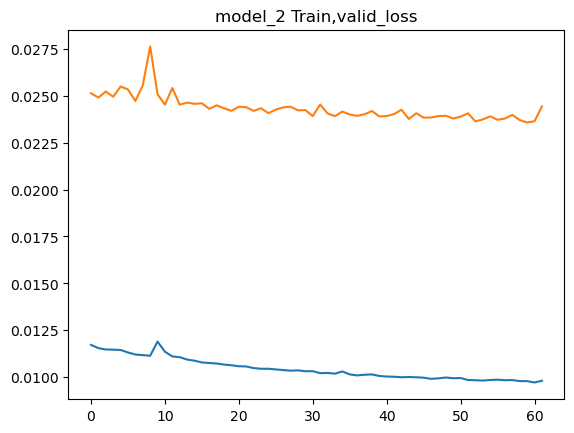

best epoch:  61


<Figure size 640x480 with 0 Axes>

In [44]:
plt.style.use('default')
plt.title('model_2 Train,valid_loss')
plt.plot(train_loss_list_2[3:])
plt.plot(valid_loss_list_2[3:])

plt.show()
print('best epoch: ',np.argmin(valid_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
plt.savefig('model_2 Train,valid_loss.png', dpi=300, facecolor='w')

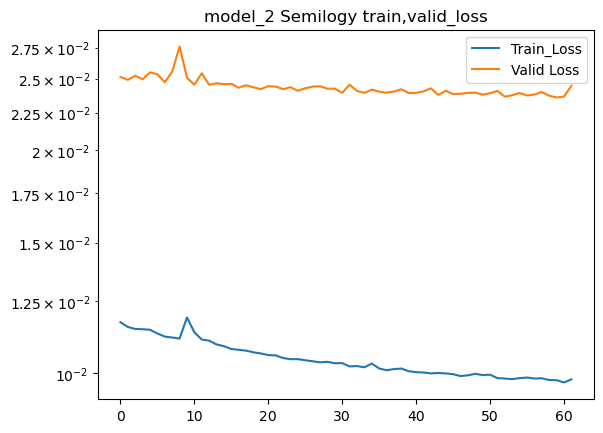

best epoch:  62


<Figure size 640x480 with 0 Axes>

In [45]:
plt.style.use('default')
plt.title('model_2 Semilogy train,valid_loss')
plt.semilogy(train_loss_list_2[3:],label = 'Train_Loss')
plt.semilogy(valid_loss_list_2[3:],label = "Valid Loss")
plt.legend()

plt.show()
print('best epoch: ',np.argmin(train_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
plt.savefig('model_2 Semilogy train,valid_loss.png', dpi=300, facecolor='w')

In [14]:
def test(model_1,model_2, test_loader, loss_func,string, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label necrosis
        [1] label edema
        [2] label non-enhancing tumor
        [3] label enhancing tumor
    '''
    enhancing = 0.0 # necrosis[1] + enhanced tumor[4]
    core = 0.0      # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = 0.0  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    enhancing_real_seg = 0.0
    core_real_seg = 0.0     
    complete_real_seg = 0.0 
    
    model_1 = model_1.to(device)
    model_2 = model_2.to(device)
    model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
    model_2.load_state_dict(torch.load(f"./model/{save_2}.pt"))

    model_1.eval()
    model_2.eval()
    
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()
        output_2 = threshold_img(output_2)
        
        # pred = torch.topk(output_2, 1, dim=1).indices
        # target = torch.topk(label, 1, dim=1).indices
        
        en, co, com, en_real_seg, co_real_seg, com_real_seg  = loss_func(output_2.detach().cpu().numpy(), label.detach().cpu().numpy())
        
        enhancing += en
        core += co
        complete += com
        enhancing_real_seg += en_real_seg
        core_real_seg += co_real_seg
        complete_real_seg += com_real_seg
        
        
        
    enhancing, core, complete = enhancing/enhancing_real_seg, core/core_real_seg, complete/complete_real_seg
    
    return  complete, core, enhancing

In [17]:
model_1 = AttentionUNet_1(4, 1).to(device)
model_2 = AttentionUNet_2(4,5).to(device)
save_1 = '2_case_unet_ver_1'
save_2 = '2_case_unet_ver_2'
dice  =dice
sen=sensitivity
spec=specificity

In [18]:
print('DICE : ', test(model_1,model_2, test_loader, dice,'DICE', device))
print('Specificity : ', test(model_1,model_2, test_loader, sen,'Specificity', device))
print('Sensitivity : ', test(model_1,model_2, test_loader, spec,'Sensitivity', device))

  0%|          | 0/149 [00:00<?, ?it/s]

DICE :  (0.9401105195367914, 0.9281699111764774, 0.9467415122562413)


  0%|          | 0/149 [00:00<?, ?it/s]

Specificity :  (0.9285947402672274, 0.918336854745198, 0.9410951388126851)


  0%|          | 0/149 [00:00<?, ?it/s]

Sensitivity :  (0.9998597492182562, 0.9998973294059607, 0.9999000253848181)


In [19]:
def confusion_matrix(pred, target, class_name):
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    
    for i in range(len(class_name)):
        mask = target == i
        pred_mask = pred[mask]
        for j in range(len(class_name)):
            cm_pred[i, j] = torch.sum(pred_mask==j)
            cm_target[i, j] = torch.sum(mask)
            
    return cm_pred, cm_target

In [20]:
def test_confusion_matrix(model,model_2, test_loader, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label normal
        [1] label necrosis
        [2] label edema
        [3] label non-enhancing tumor
        [4] label enhancing tumor
    '''
    class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']
    model = model.to(device)
    model_2 = model_2.to(device)
    model.eval()
    model_2.eval()
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()
        
        pred = torch.topk(output_2, 1, dim=1).indices
        target = torch.topk(label, 1, dim=1).indices
        
        cm_p, cm_t  = confusion_matrix(pred, target, class_name)
        cm_pred += cm_p
        cm_target += cm_t
        
    cm = np.round(cm_pred/cm_target, 2)
    # ax = sns.heatmap(cm, annot=True)
    # ax.set_yticklabels(class_name, rotation=0)
    # ax.set_xticklabels(class_name, rotation=15)
    # plt.show()
    return  cm

  0%|          | 0/149 [00:00<?, ?it/s]

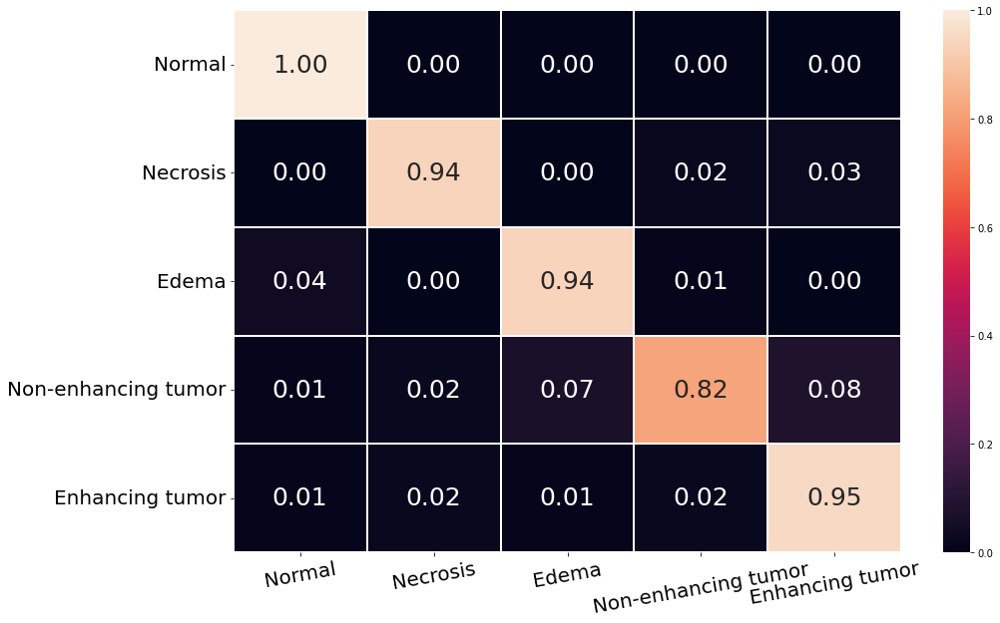

In [21]:
model_1 = AttentionUNet_1(4,1)
model_2 = AttentionUNet_2(4,5)
model_1.load_state_dict(torch.load(f'./model/{save_1}.pt'))
model_2.load_state_dict(torch.load(f'./model/{save_2}.pt'))

class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

cm = test_confusion_matrix(model_1,model_2, test_loader, device)

fig,ax = plt.subplots(1,1,figsize = (15,10))
ax = sns.heatmap(cm, annot=True,linewidths=0.1,fmt=".2f",annot_kws={"fontsize":25})
ax.set_yticklabels(class_name, rotation=0,fontsize =20,)
ax.set_xticklabels(class_name, rotation=10,fontsize =20)
plt.savefig('./png/best_confusion_matrix_2.png', dpi=200, facecolor='w',bbox_inches = 'tight')
plt.show()

---------------------
# another test

In [49]:
num_epoch = 80
learning_rate = 1e-2

model_1 = AttentionUNet_1(4, 1).to(device)

# optimizer_1 = torch.optim.AdamW(model_1.parameters(), lr=learning_rate)
# scheduler_1 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_1,mode='min',patience=10)
# save_1 = '2_case_unet_ver_1'


model_2 = AttentionUNet_2(4,4).to(device) # normal은 model_1이 확인한 상황 
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=10)
save_3 = '2_case_unet_ver_4_to_4'

loss_func = torch.nn.BCELoss().to(device)
model_1,model_2 = model_1.to(device), model_2.to(device)
    
plt2 = pltlabel[0].detach().cpu().numpy()
plt1 = pltimage[0][0].detach().cpu().numpy()
show_label = plt2[0]+plt2[1]*2+plt2[2]*3+plt2[3]*4
# model

In [50]:
################################ 여기는 4,4 실험

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 2 : train_loss : 0.290749437456963, valid_loss : 0.2927067245366753


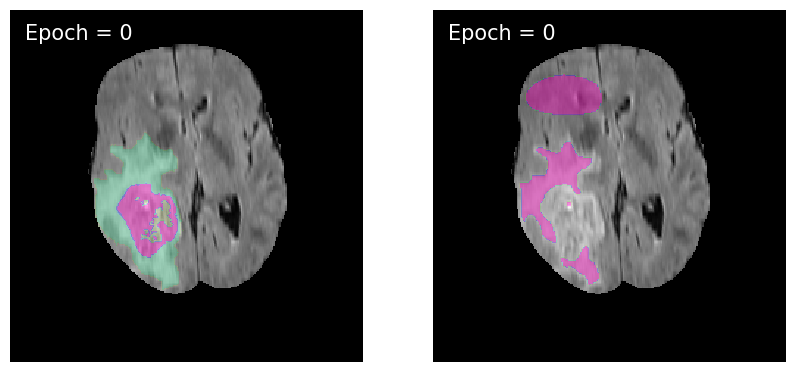

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 2 : train_loss : 0.2898350135992037, valid_loss : 0.2897533024110461


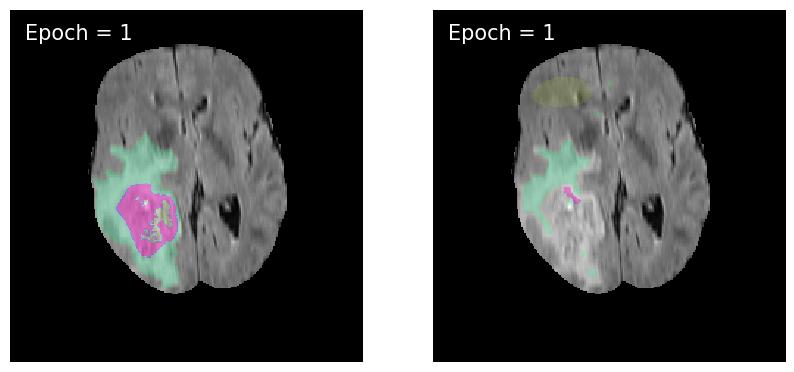

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 2 : train_loss : 0.2894718412318219, valid_loss : 0.2893562561642098


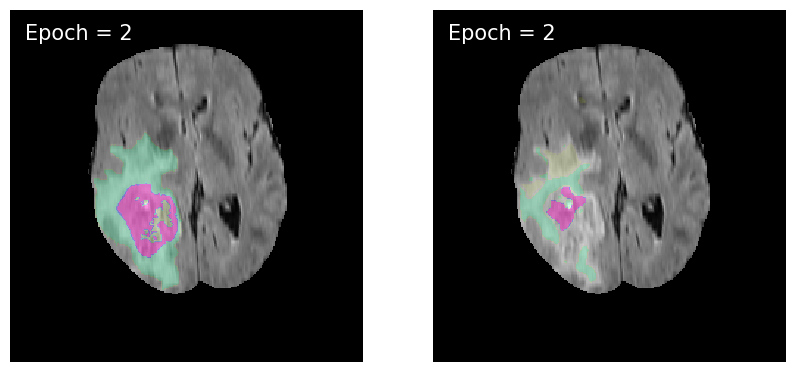

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 2 : train_loss : 0.28936874606465335, valid_loss : 0.28954905932468755


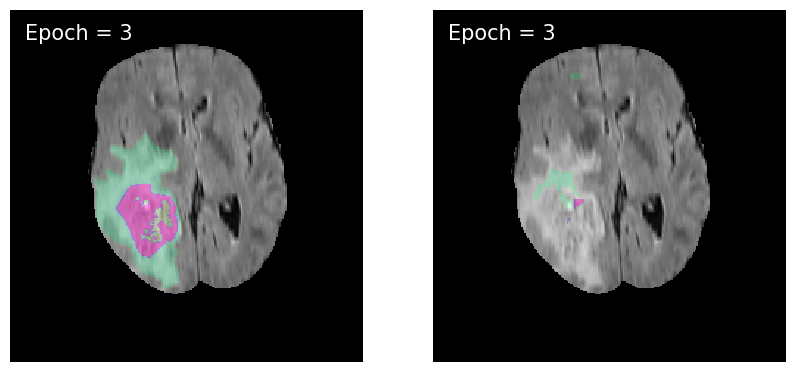

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 2 : train_loss : 0.2891402999293351, valid_loss : 0.2907315462587341


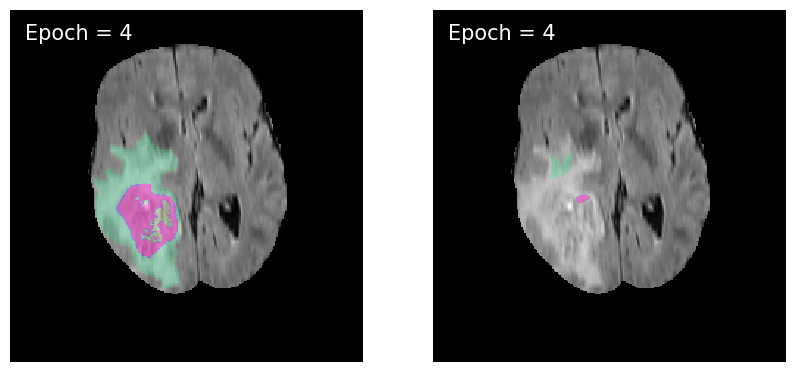

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 2 : train_loss : 0.2889381965134768, valid_loss : 0.2887858348267694


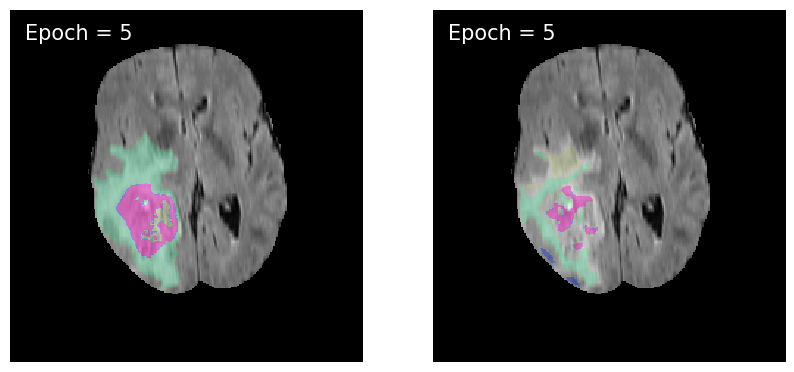

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 2 : train_loss : 0.28868879341172426, valid_loss : 0.28834948905052676


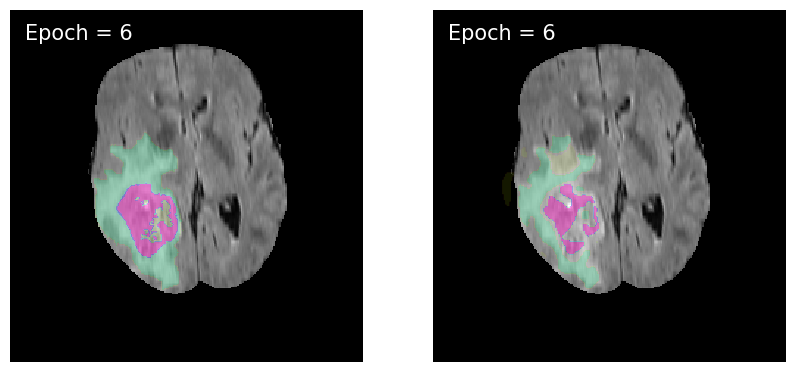

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 2 : train_loss : 0.28836347426077397, valid_loss : 0.2881578789843667


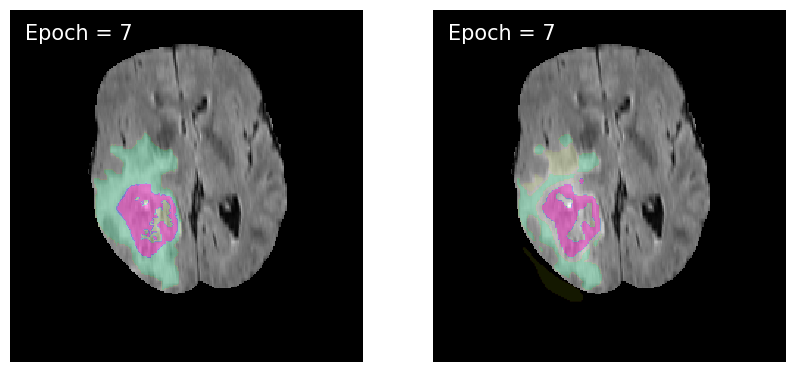

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 2 : train_loss : 0.28814483248947453, valid_loss : 0.28861063887034694


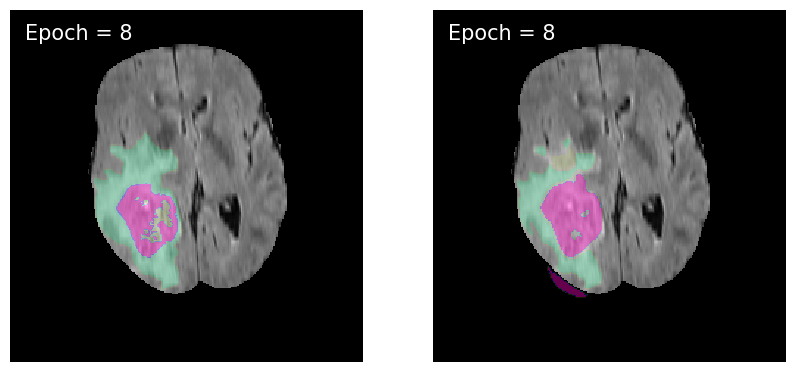

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 2 : train_loss : 0.28805918034824485, valid_loss : 0.2879423548777898


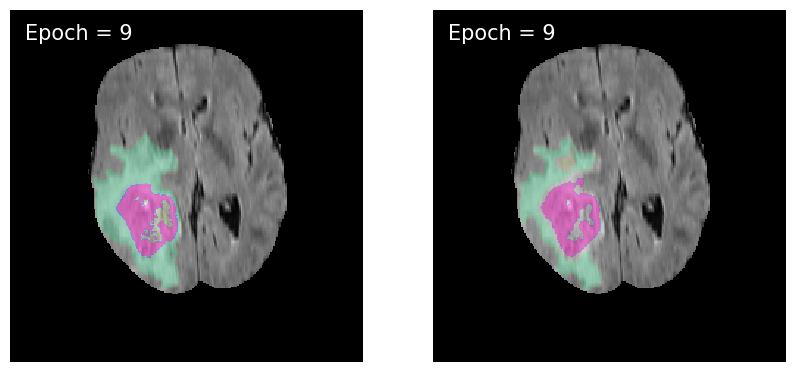

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 2 : train_loss : 0.28791078525101577, valid_loss : 0.28970837613107053


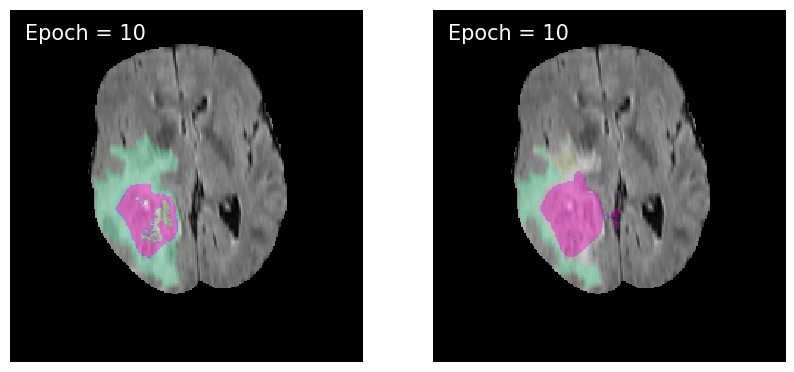

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 2 : train_loss : 0.28775990922712374, valid_loss : 0.289252864216925


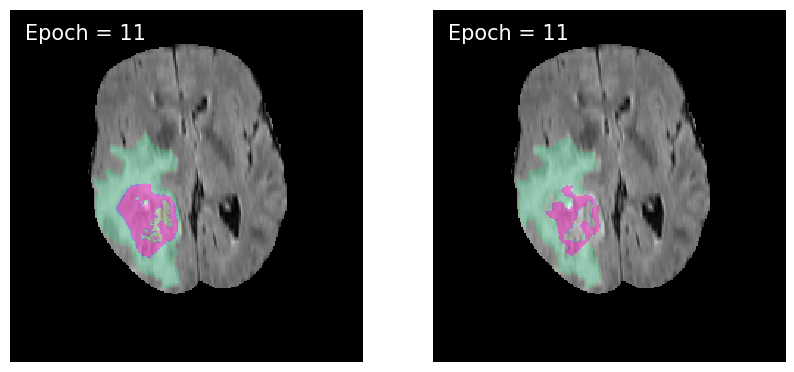

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 2 : train_loss : 0.28759608346077153, valid_loss : 0.28744837241147153


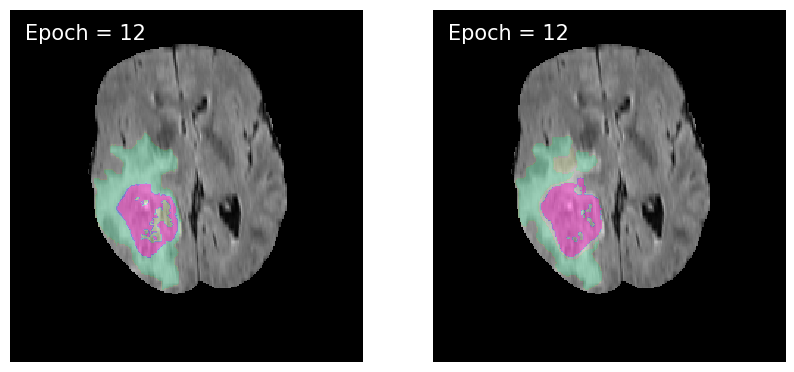

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 2 : train_loss : 0.28753985894606415, valid_loss : 0.2874311534788019


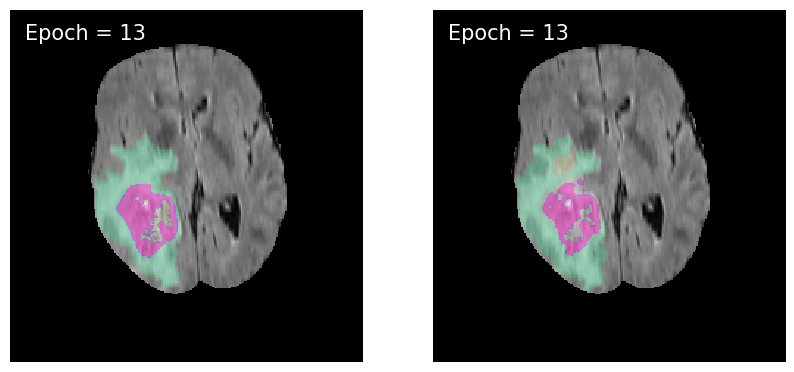

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 2 : train_loss : 0.2875162835089152, valid_loss : 0.2880423729538277


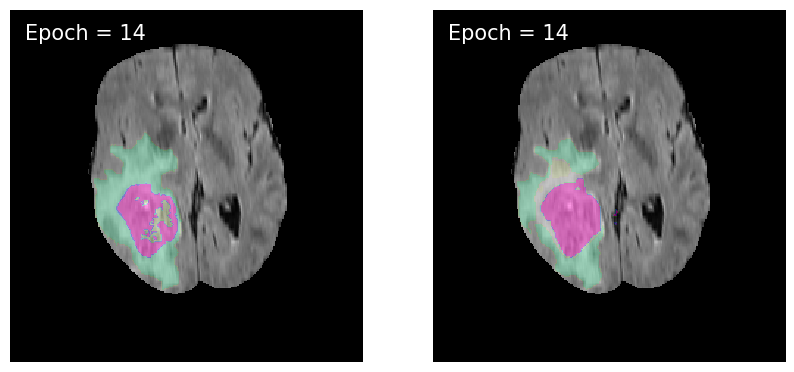

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 2 : train_loss : 0.2874133426204357, valid_loss : 0.2875348420873765


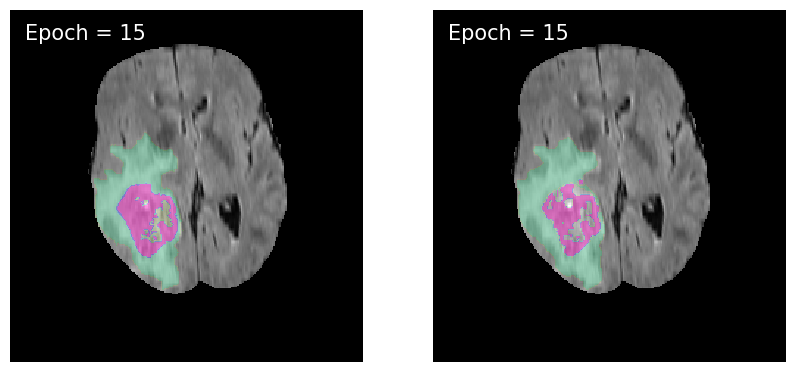

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 2 : train_loss : 0.28734716739697214, valid_loss : 0.2872775129733547


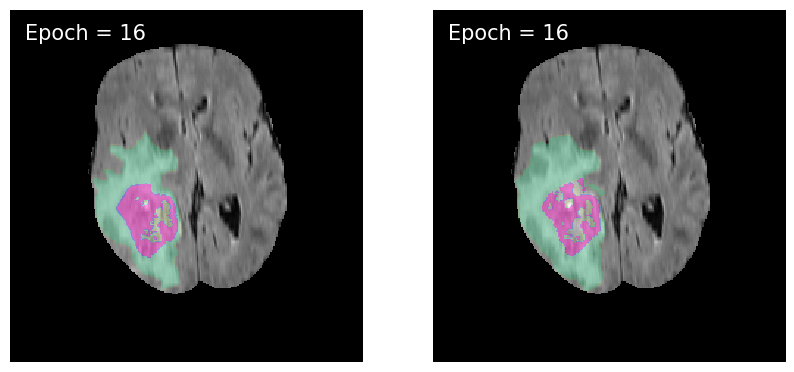

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 2 : train_loss : 0.2871346385020271, valid_loss : 0.2871414083707076


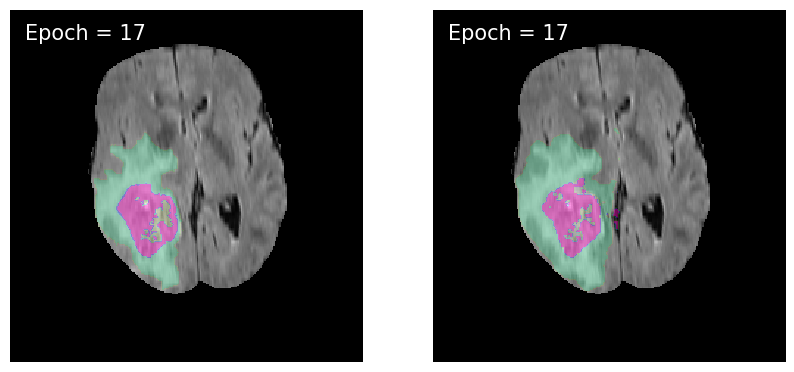

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 2 : train_loss : 0.28742977050060126, valid_loss : 0.2870388340245011


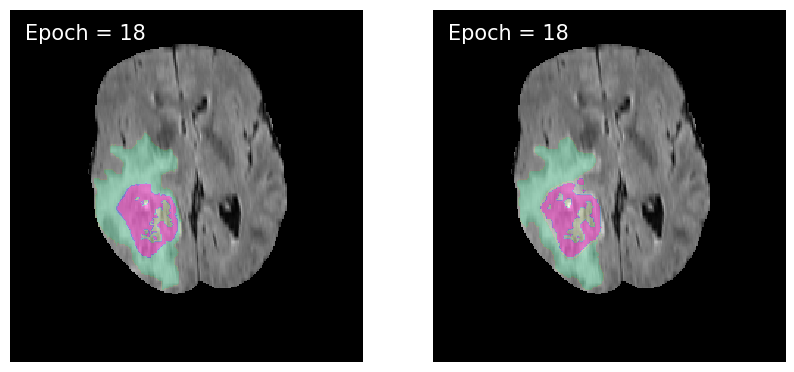

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 2 : train_loss : 0.28711743456138594, valid_loss : 0.2871364120353935


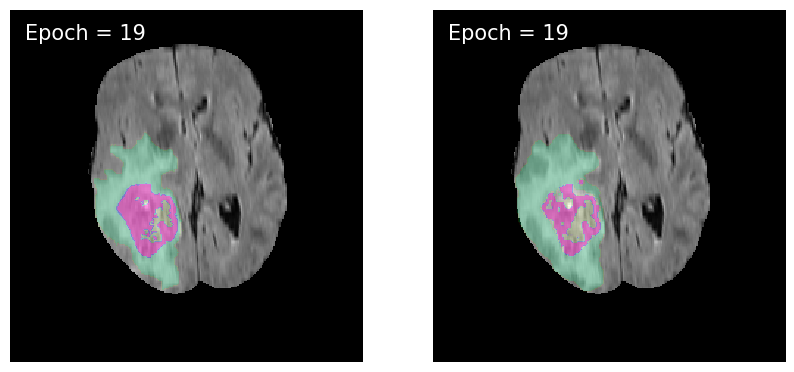

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 2 : train_loss : 0.28726907044449107, valid_loss : 0.28747572769881574


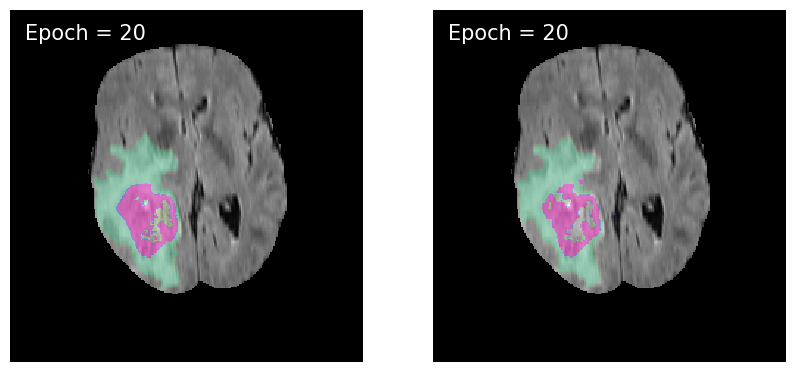

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 2 : train_loss : 0.2869864280858563, valid_loss : 0.2871867342581672


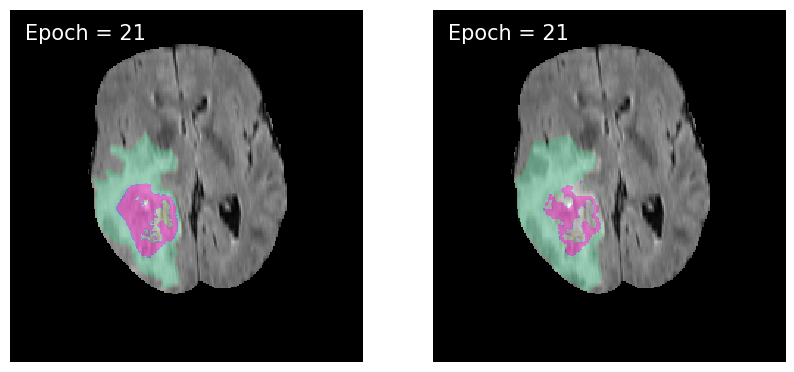

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 2 : train_loss : 0.28682598744996174, valid_loss : 0.2873994902737679


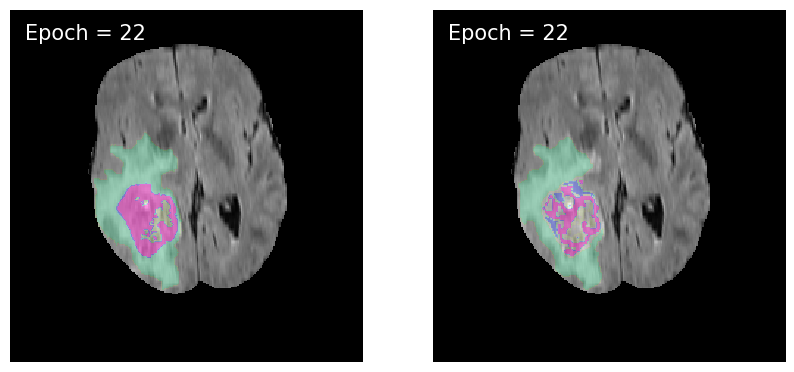

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 2 : train_loss : 0.2869752044779076, valid_loss : 0.28687418508593754


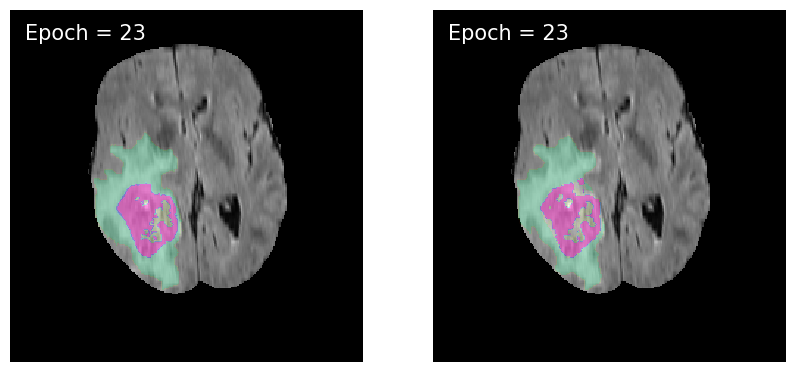

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 2 : train_loss : 0.2868359148902381, valid_loss : 0.28665764513675884


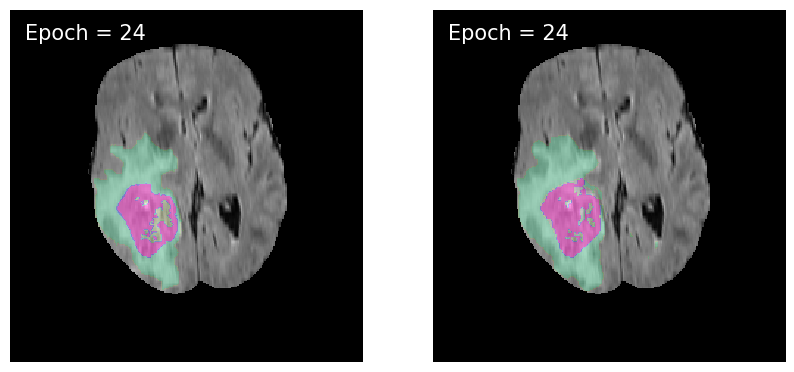

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 2 : train_loss : 0.28678656277773895, valid_loss : 0.2865047147998246


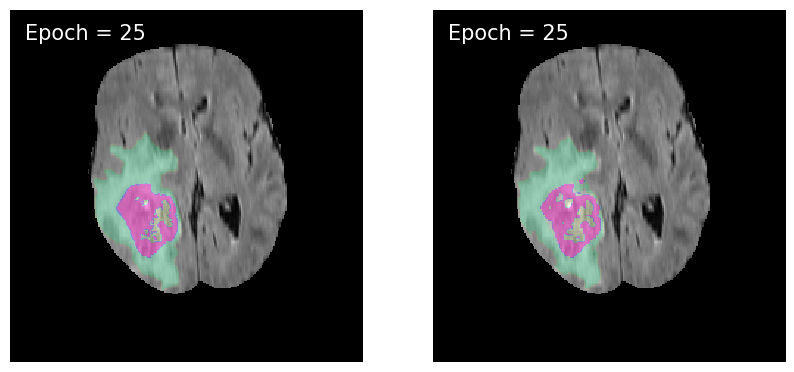

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 2 : train_loss : 0.28662297869688713, valid_loss : 0.2866919720445269


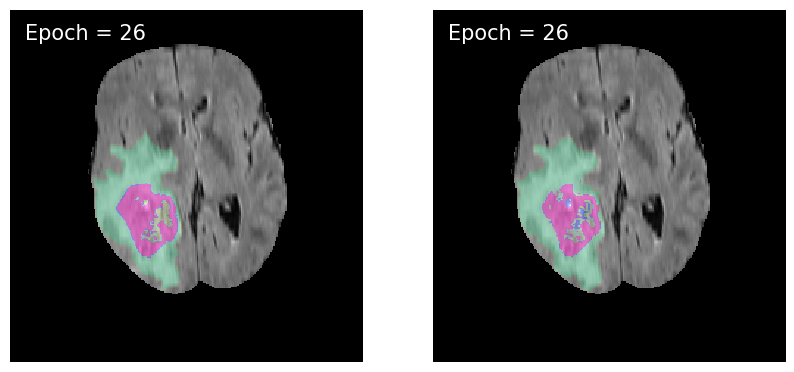

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 2 : train_loss : 0.2866145807091288, valid_loss : 0.2870697770468009


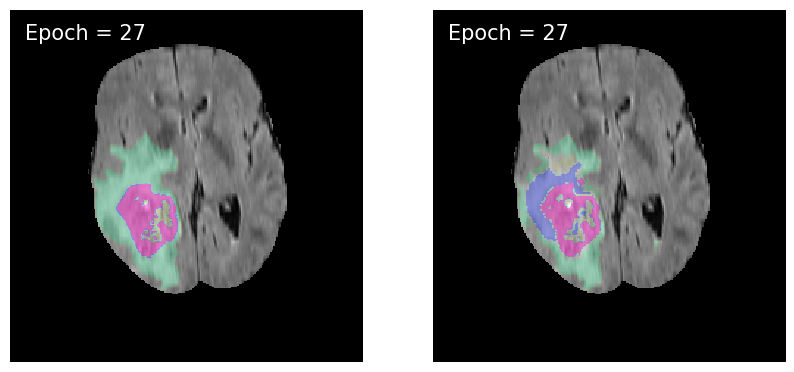

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 2 : train_loss : 0.2868101666171012, valid_loss : 0.2868495352806584


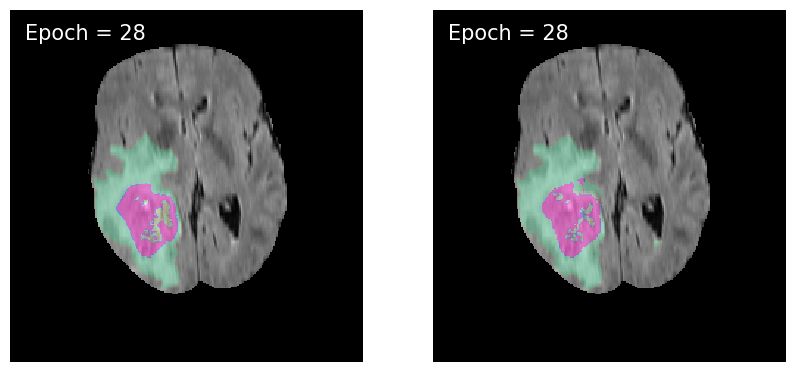

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 2 : train_loss : 0.286661985403206, valid_loss : 0.28655315242627616


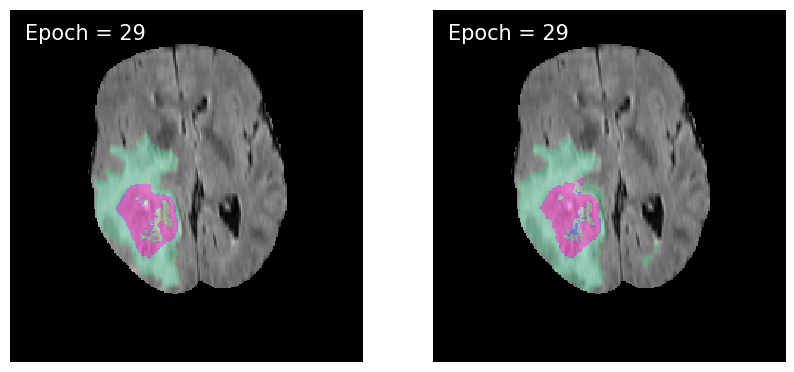

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 2 : train_loss : 0.2866058945655823, valid_loss : 0.2863825827596649


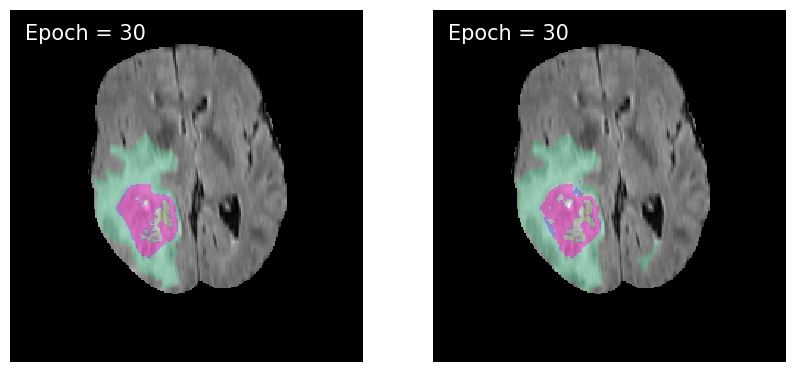

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 2 : train_loss : 0.2865036067946645, valid_loss : 0.2864942666824146


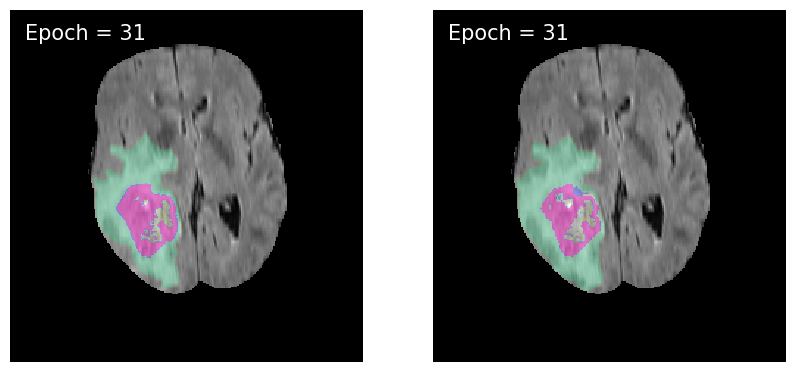

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 2 : train_loss : 0.286472775058725, valid_loss : 0.28673613904624856


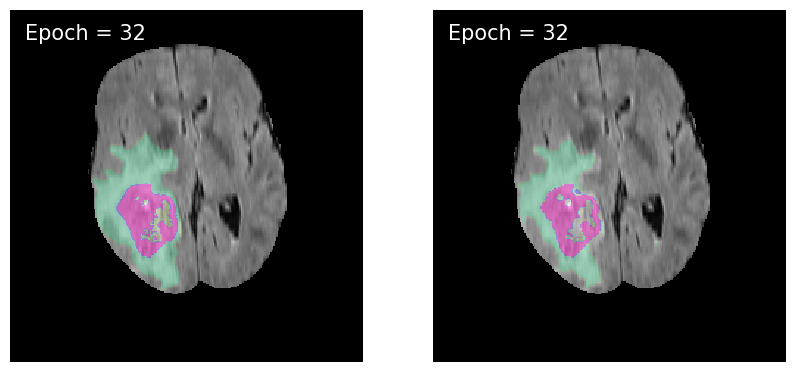

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 2 : train_loss : 0.28645580420291394, valid_loss : 0.28642665266349754


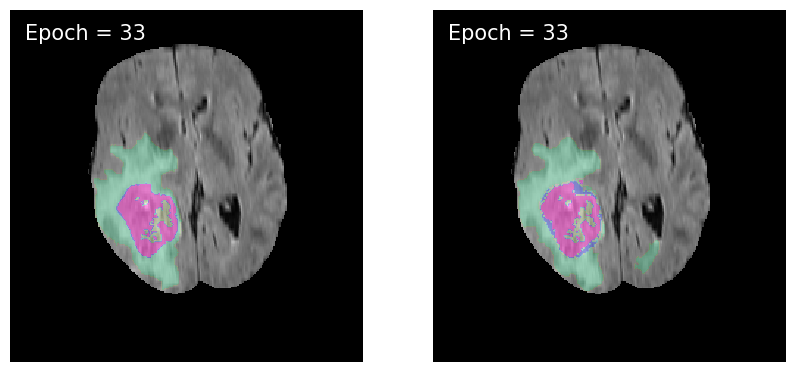

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 2 : train_loss : 0.2866951608551162, valid_loss : 0.28715141882659284


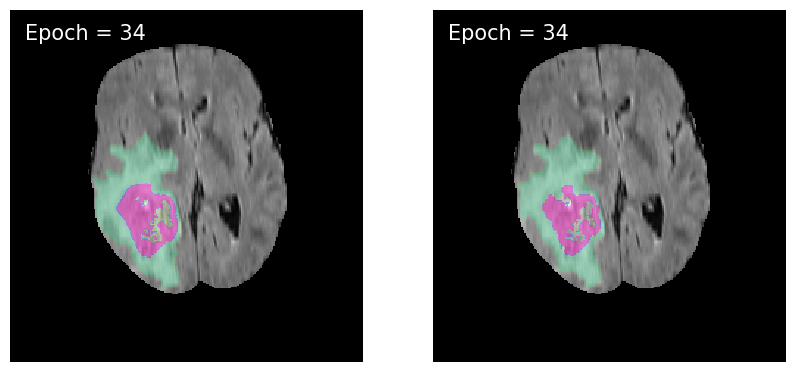

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 2 : train_loss : 0.28645991178967006, valid_loss : 0.28621897225578624


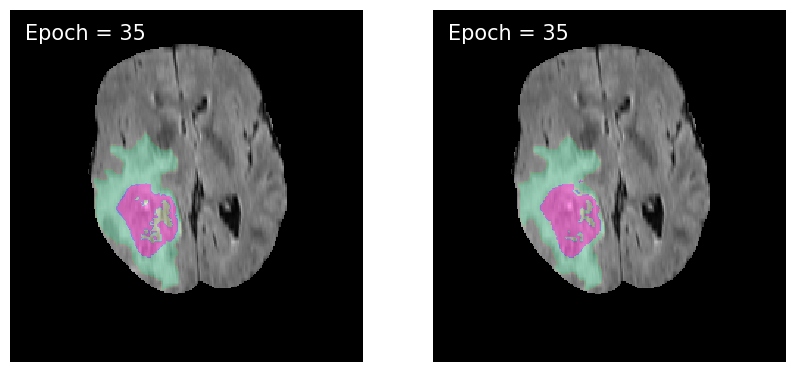

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 2 : train_loss : 0.2863055583614631, valid_loss : 0.28611143061550715


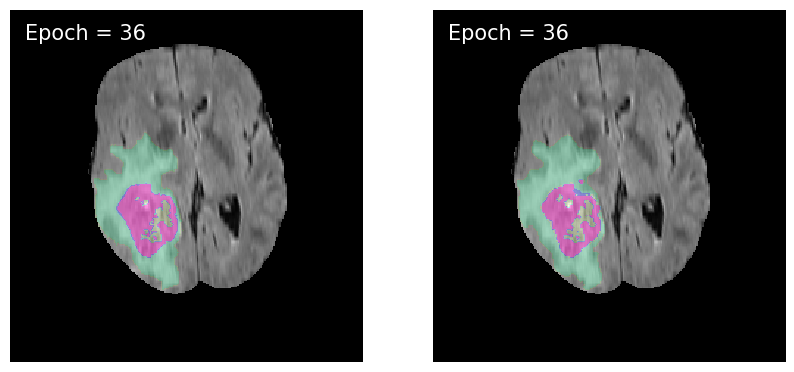

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 2 : train_loss : 0.28633137243972795, valid_loss : 0.2862943575907779


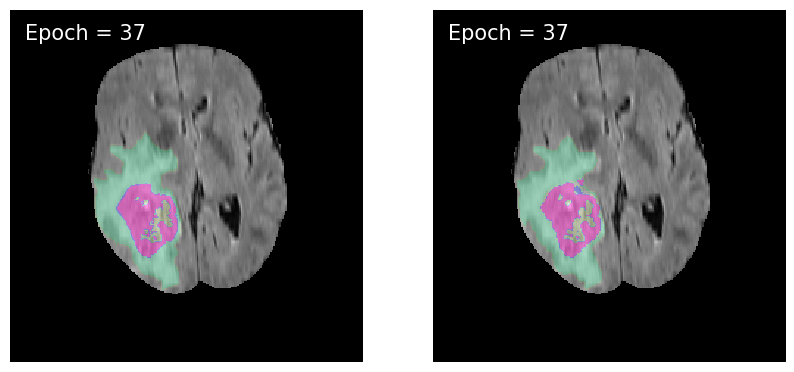

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 2 : train_loss : 0.2863490445501852, valid_loss : 0.2867225554361138


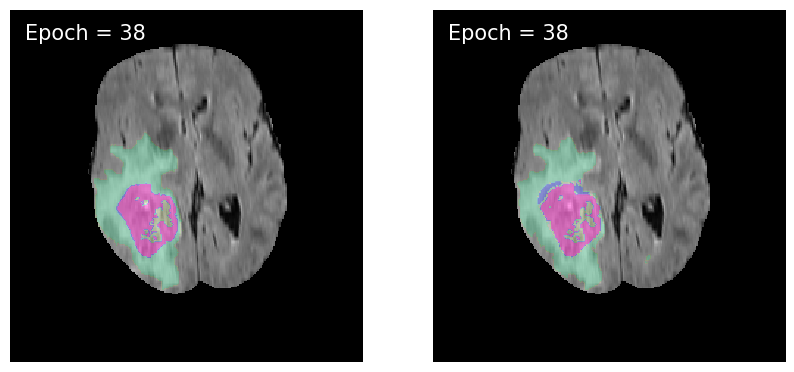

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 2 : train_loss : 0.2862350037967332, valid_loss : 0.2861249159260463


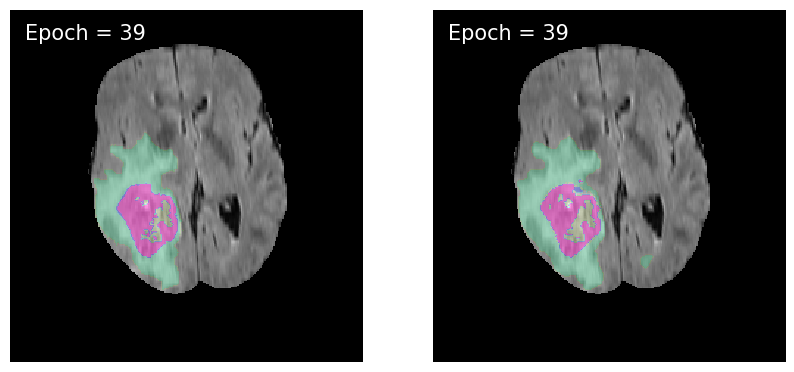

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 2 : train_loss : 0.2861928553122535, valid_loss : 0.2861364401716699


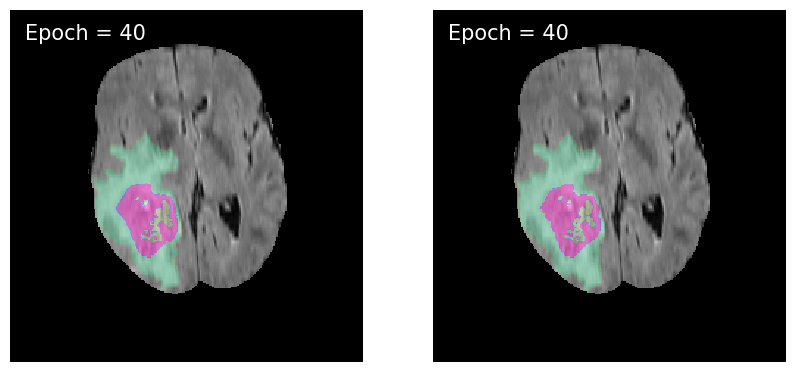

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 2 : train_loss : 0.28614205588697056, valid_loss : 0.2864876028991515


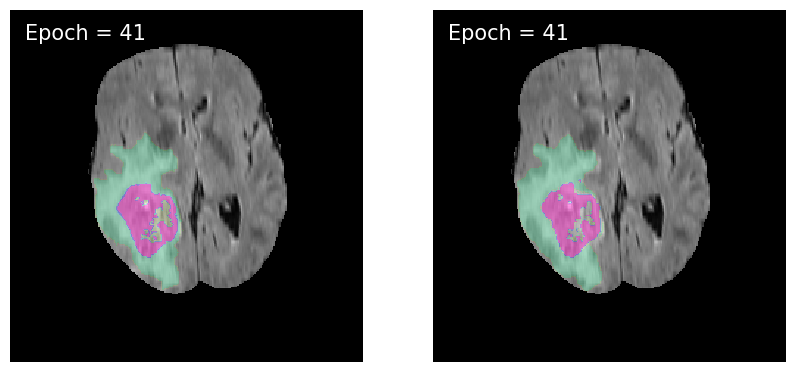

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 2 : train_loss : 0.2861578005138926, valid_loss : 0.2862213518750924


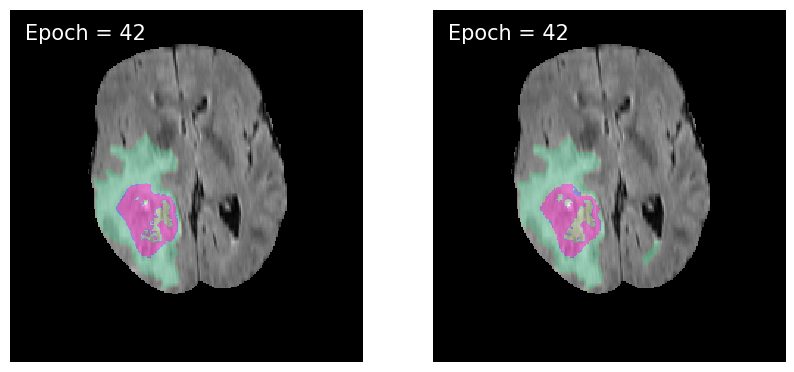

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 2 : train_loss : 0.28631155556213667, valid_loss : 0.28607207260304884


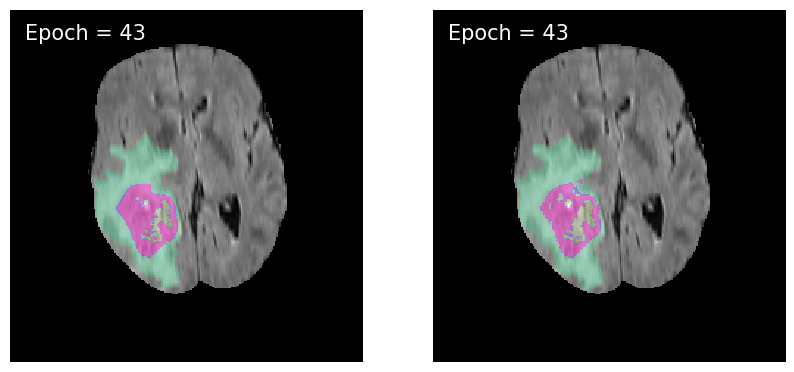

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 2 : train_loss : 0.2861014345214938, valid_loss : 0.2861207851399017


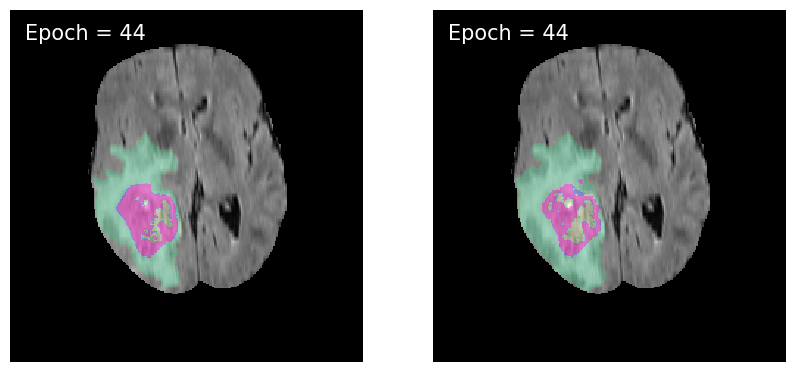

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 2 : train_loss : 0.28612157649108494, valid_loss : 0.286039094170255


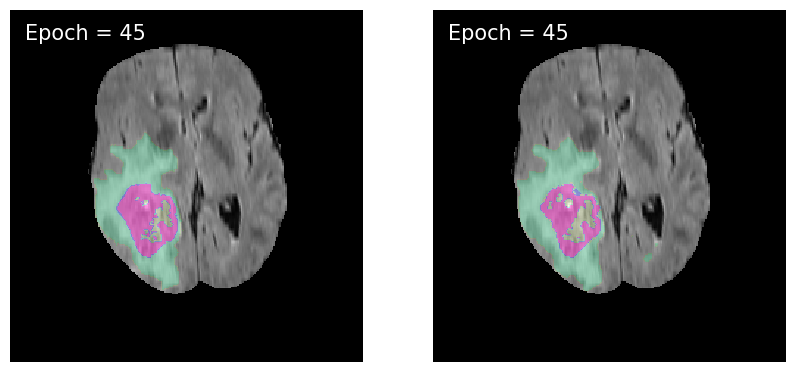

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 2 : train_loss : 0.28599945630803203, valid_loss : 0.285871869053251


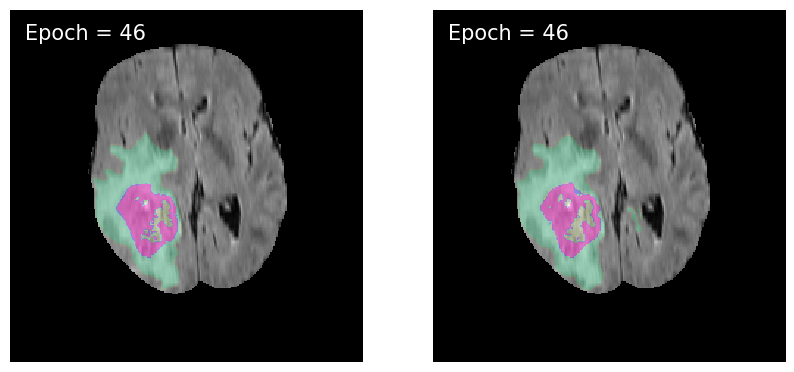

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 2 : train_loss : 0.2860464539037188, valid_loss : 0.28594452487204663


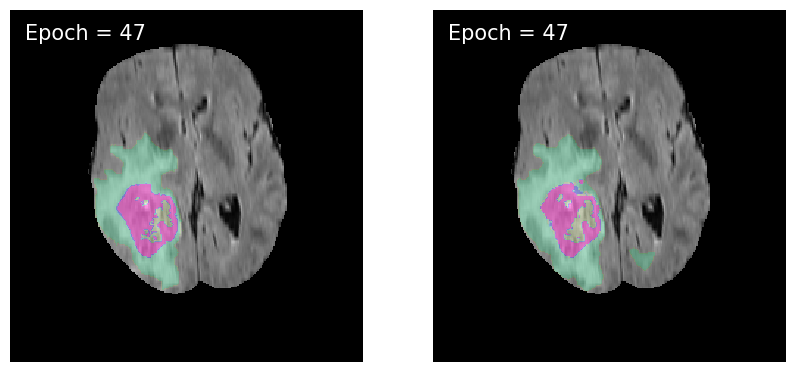

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 2 : train_loss : 0.28594596187273663, valid_loss : 0.2858640072486734


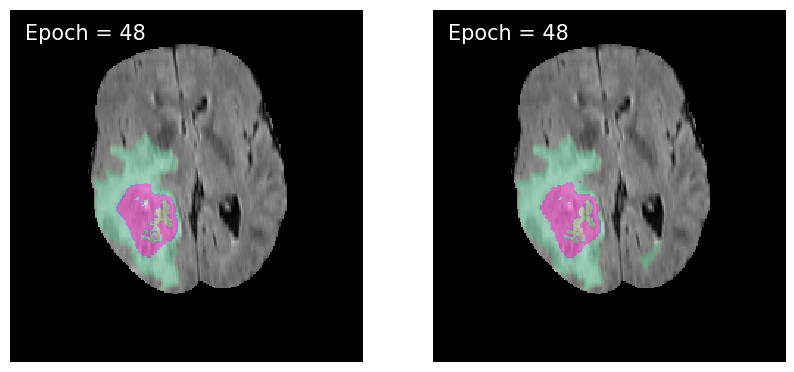

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 2 : train_loss : 0.28601013987389723, valid_loss : 0.28641175134207614


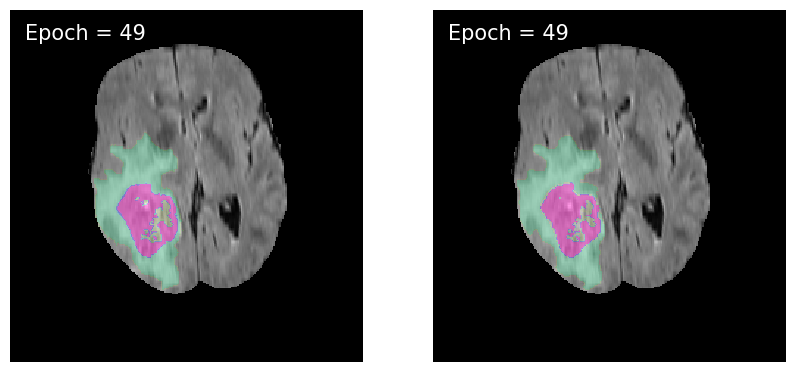

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 2 : train_loss : 0.28598851905573136, valid_loss : 0.28586420108393956


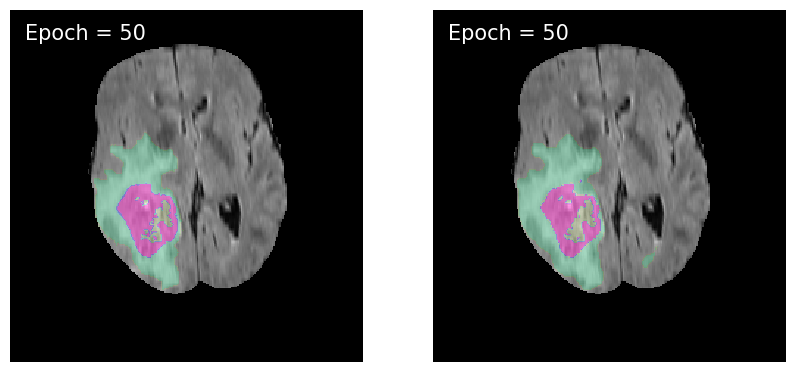

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 2 : train_loss : 0.28591603374054503, valid_loss : 0.28589352316433386


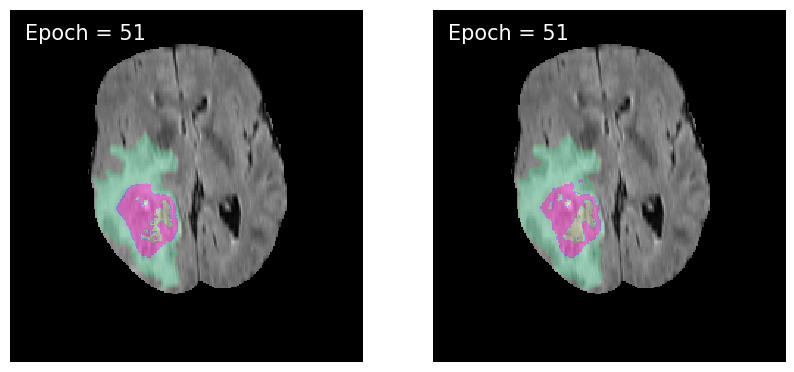

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 2 : train_loss : 0.2858472226450107, valid_loss : 0.2859259821795007


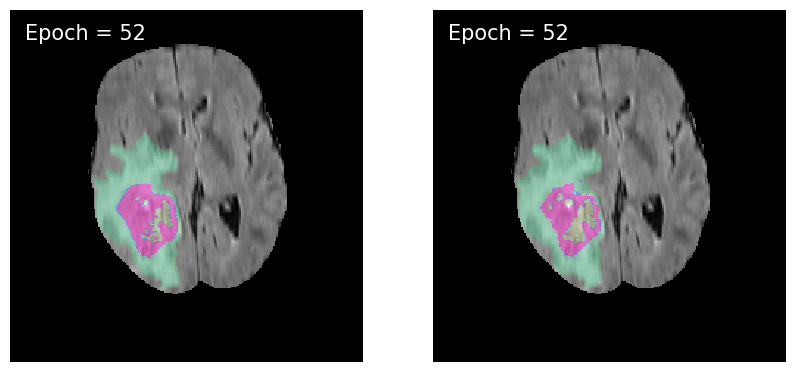

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 2 : train_loss : 0.28614190767542097, valid_loss : 0.28602693009600844


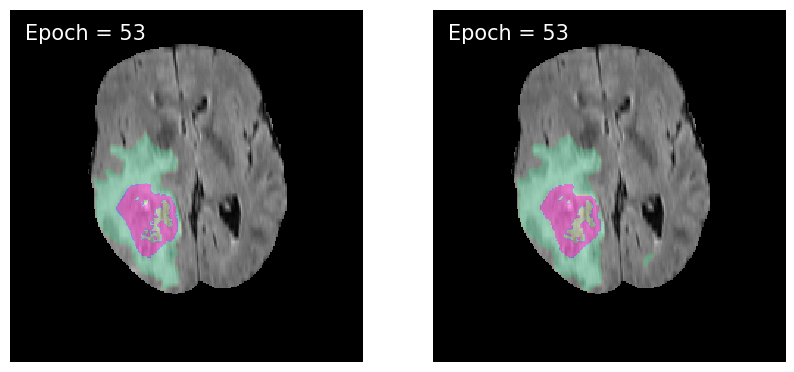

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 2 : train_loss : 0.2860887211974569, valid_loss : 0.2859197873822463


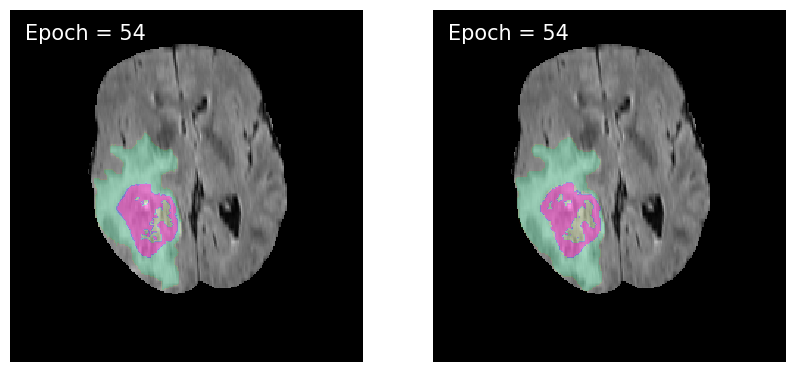

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 2 : train_loss : 0.2858308092993111, valid_loss : 0.2865542030382541


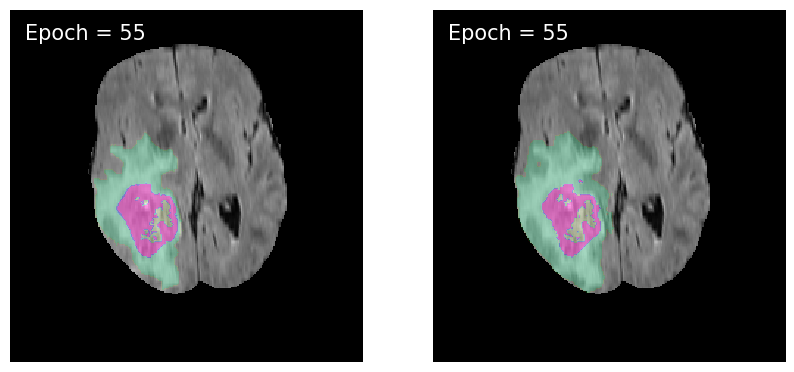

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 2 : train_loss : 0.2858693471024234, valid_loss : 0.2857935486301299


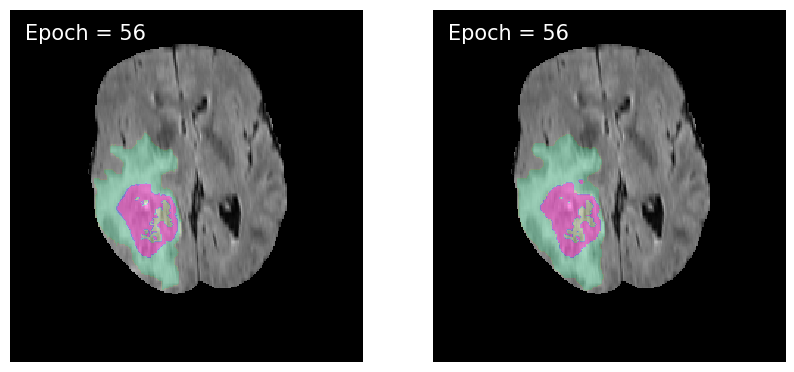

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 2 : train_loss : 0.2857877844798752, valid_loss : 0.28576645627617836


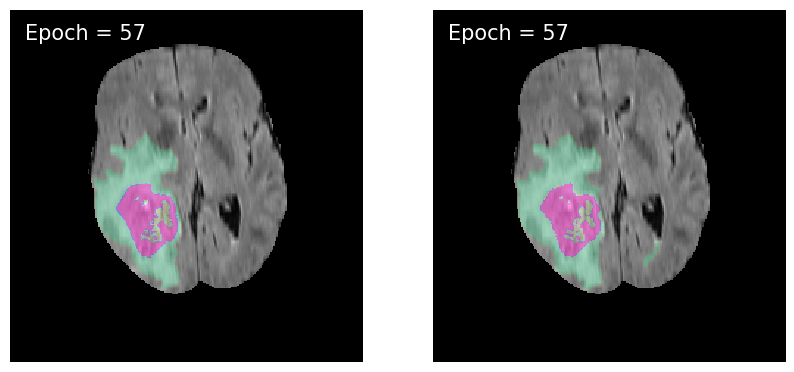

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 2 : train_loss : 0.285756752795021, valid_loss : 0.28575247986823


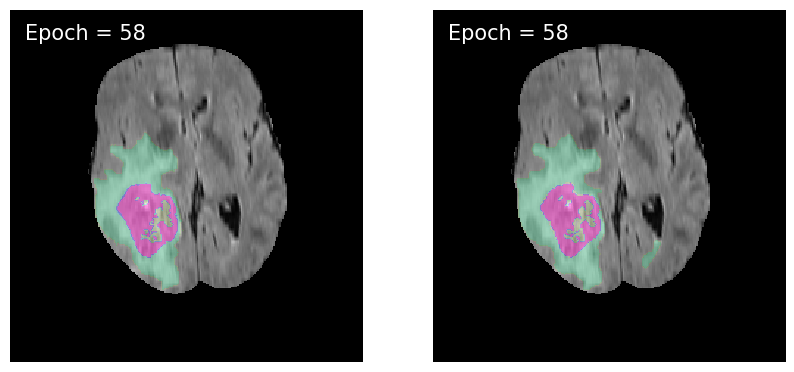

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 2 : train_loss : 0.28571788336606635, valid_loss : 0.2860349459593655


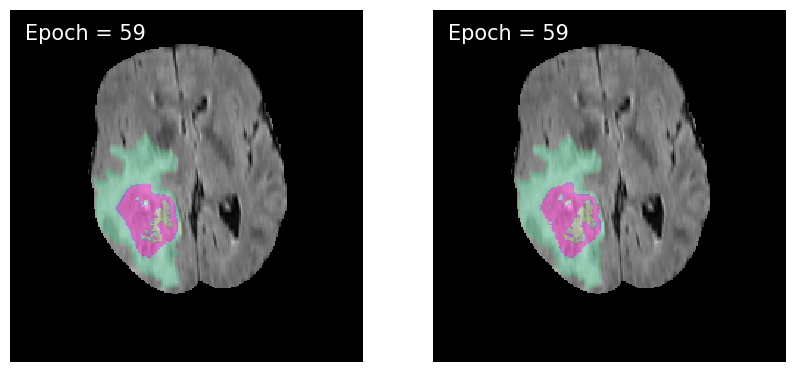

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 2 : train_loss : 0.28576139148983115, valid_loss : 0.285771400217087


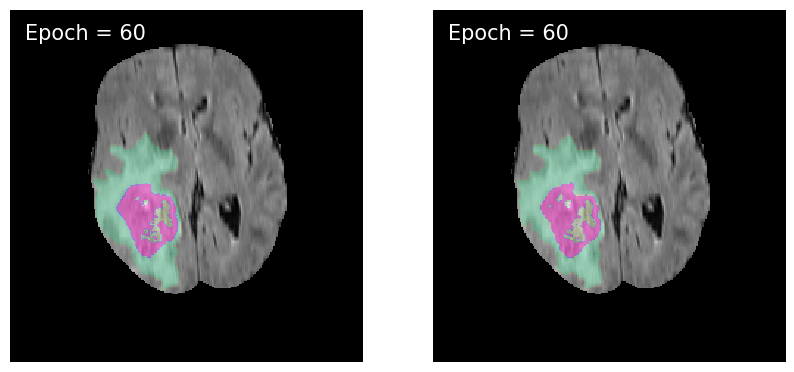

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 2 : train_loss : 0.2858036501162271, valid_loss : 0.28577983775927174


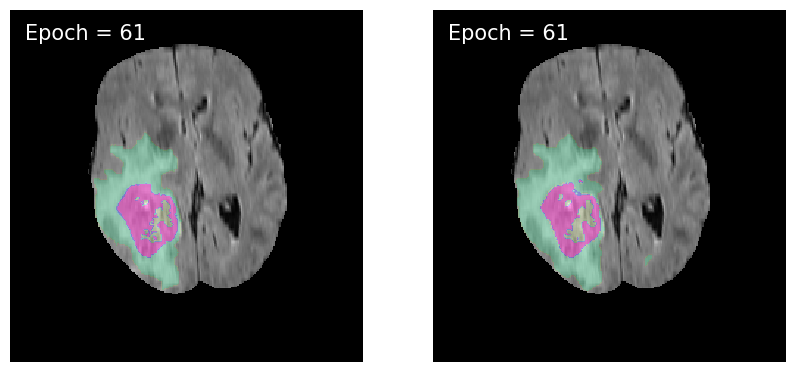

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 2 : train_loss : 0.2857123279998233, valid_loss : 0.2858315592892067


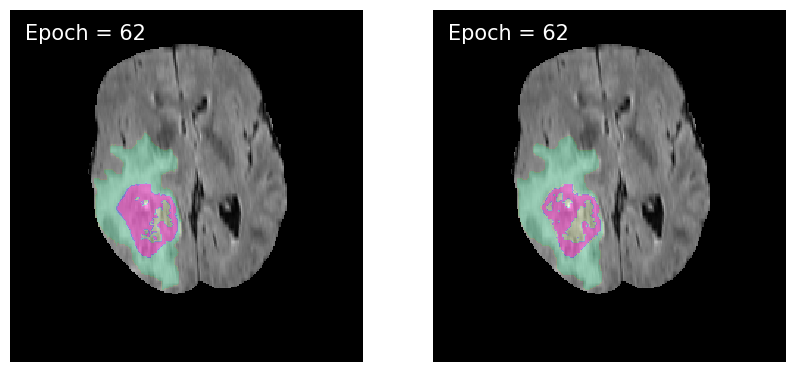

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 2 : train_loss : 0.28572143910981934, valid_loss : 0.28586754491252286


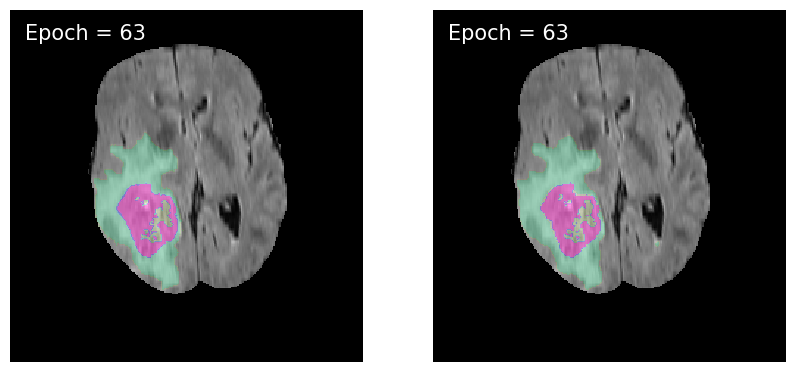

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 2 : train_loss : 0.285715071746967, valid_loss : 0.28569051579281846


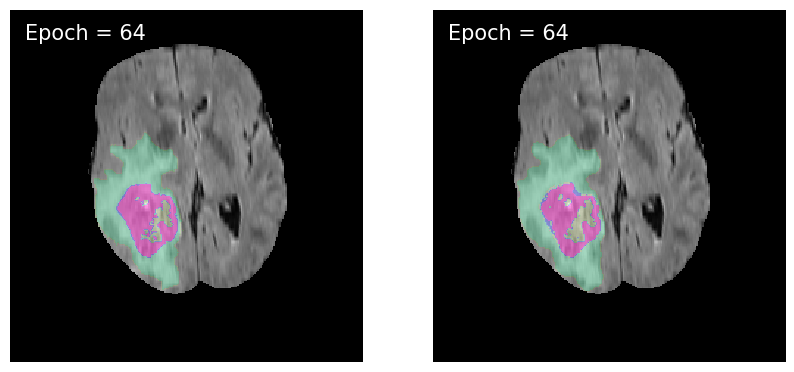

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 2 : train_loss : 0.28564312207352127, valid_loss : 0.2856319265900761


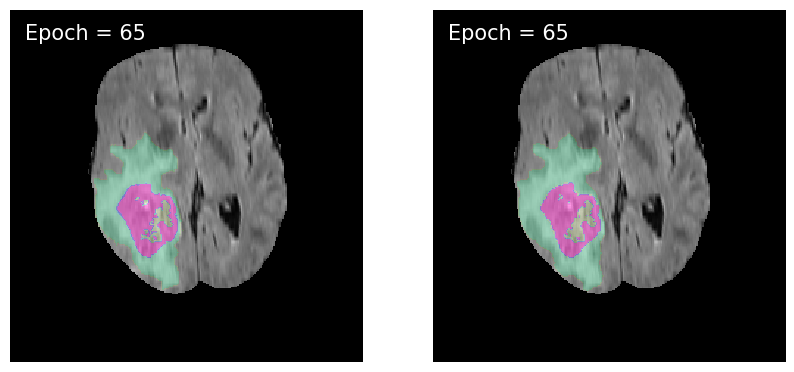

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 2 : train_loss : 0.2857248310408069, valid_loss : 0.28587597368224976


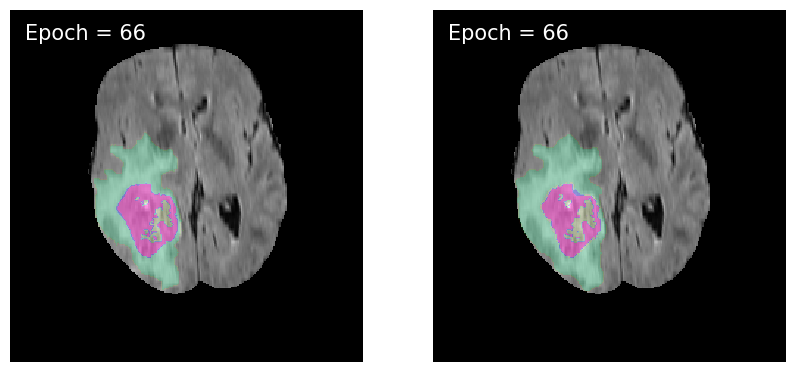

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 2 : train_loss : 0.2857861208168986, valid_loss : 0.2858485204958788


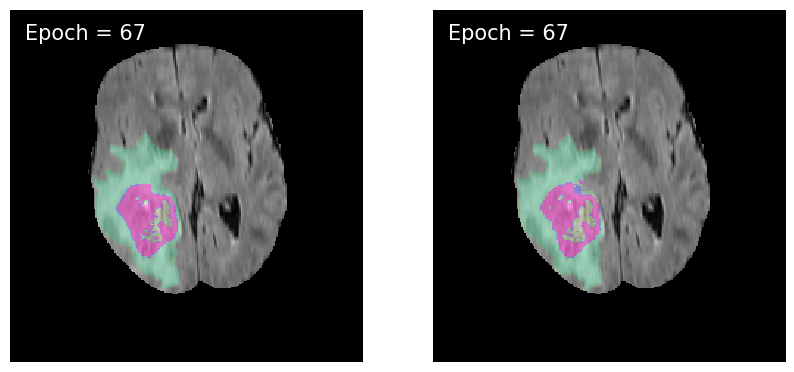

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 2 : train_loss : 0.2856771662597955, valid_loss : 0.2858902644966879


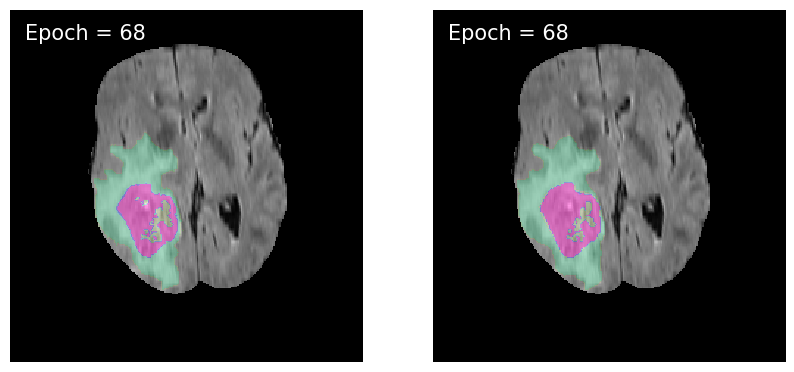

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 2 : train_loss : 0.2856840016591202, valid_loss : 0.2857331200152315


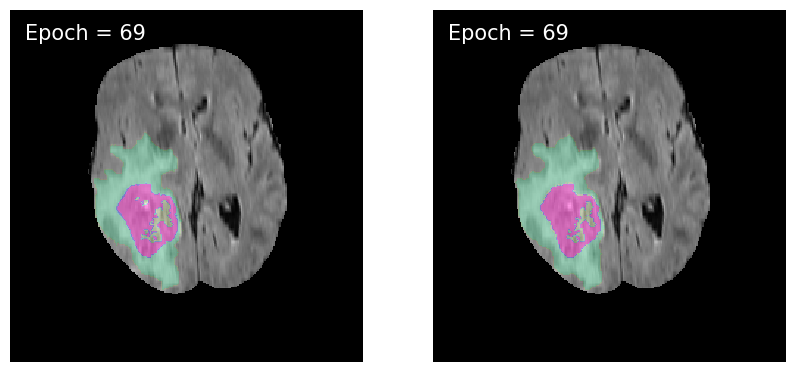

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 2 : train_loss : 0.2856792527557219, valid_loss : 0.28580589676576273


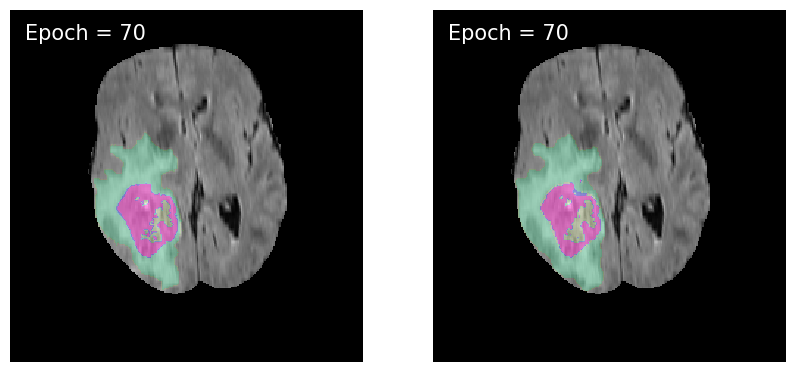

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 2 : train_loss : 0.28563527072836087, valid_loss : 0.2857222700471519


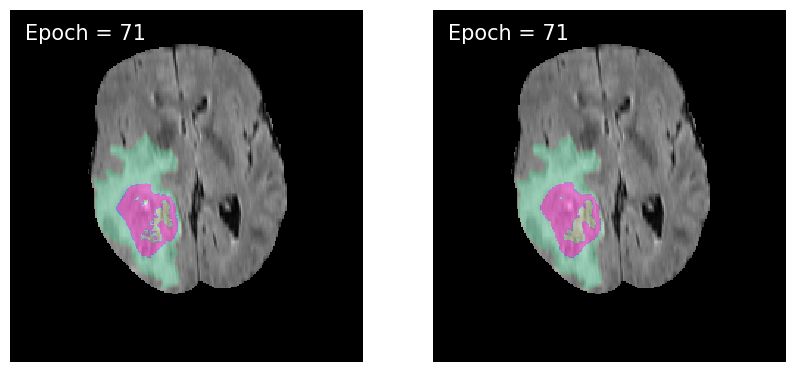

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 2 : train_loss : 0.28560331123787286, valid_loss : 0.28577211286912685


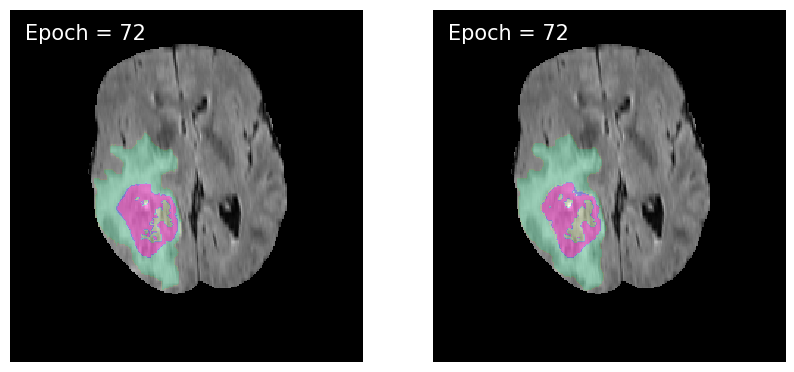

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 2 : train_loss : 0.28561638699015246, valid_loss : 0.28573908340386167


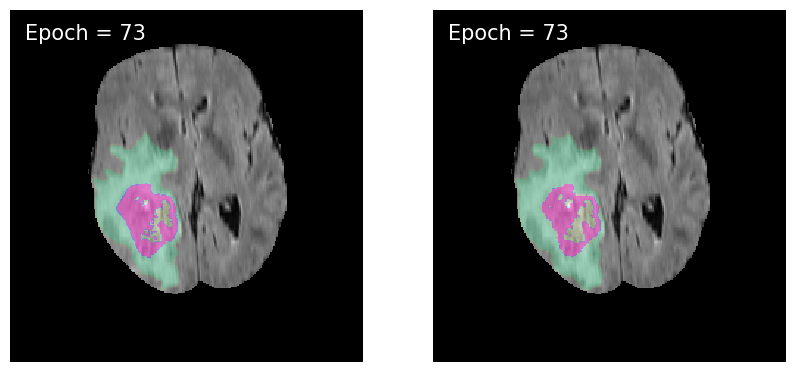

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 2 : train_loss : 0.2862493507147369, valid_loss : 0.2858387314744534


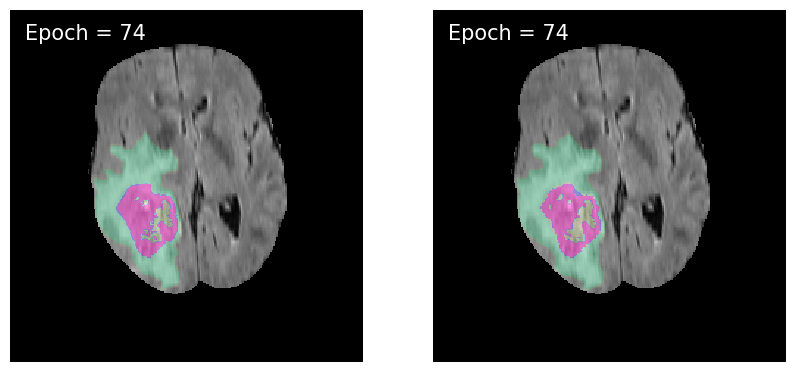

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 2 : train_loss : 0.28562902077465785, valid_loss : 0.28562758750812983


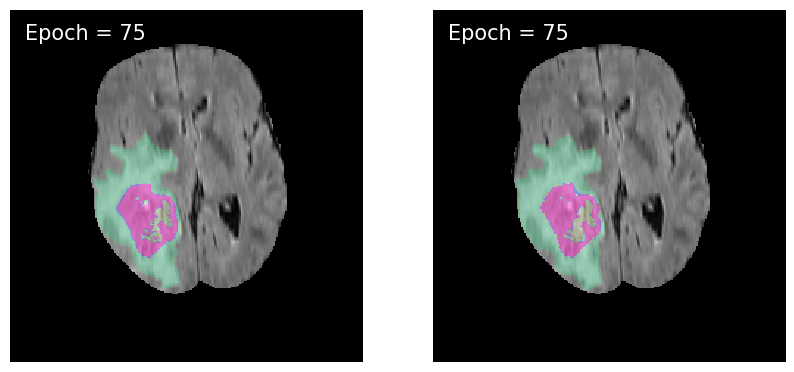

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 2 : train_loss : 0.2857228466195015, valid_loss : 0.2856279317569989


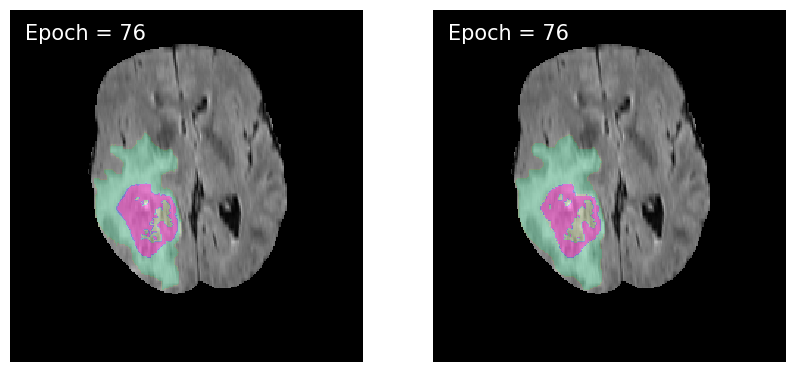

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 2 : train_loss : 0.2854423634291229, valid_loss : 0.2854914458528642


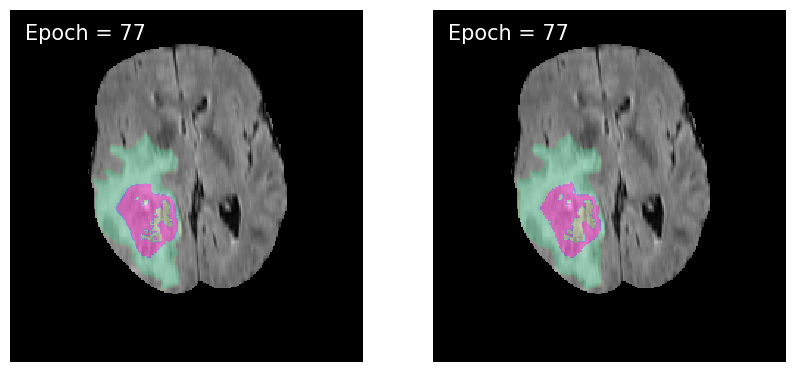

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 2 : train_loss : 0.28539362436439636, valid_loss : 0.2854757207215473


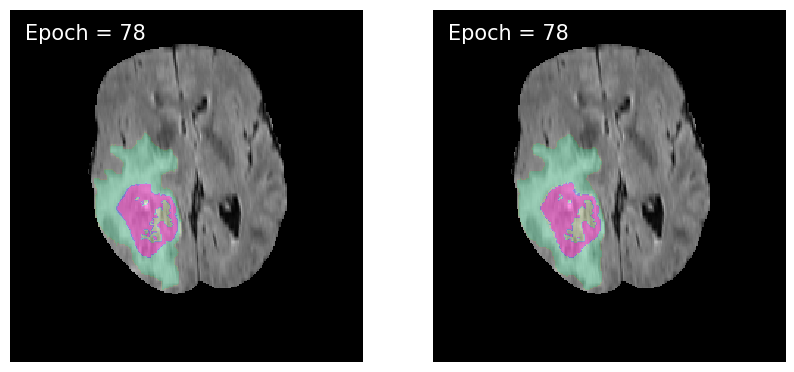

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 2 : train_loss : 0.28536538016342744, valid_loss : 0.2854658180987963


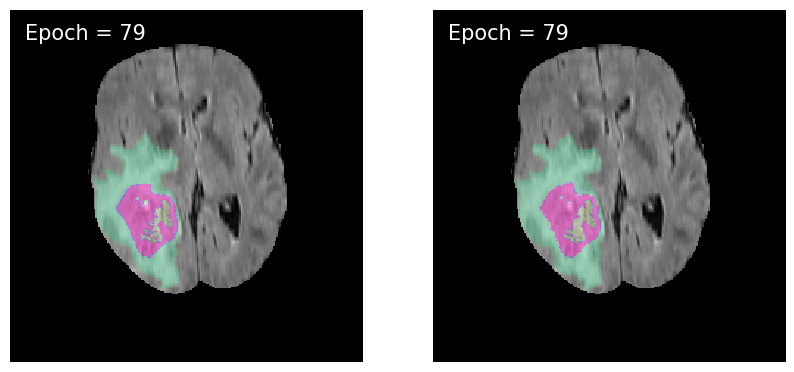

In [51]:
model_1.load_state_dict(torch.load(f"./model/2_case_unet_ver_1.pt"))
model_1.eval()

    
loss_2 =0.
min_valid_loss = np.inf
train_loss_list_2 = []
valid_loss_list_2 = []

for i in tqdm(range(num_epoch)):
    train_loss_2 = 0.0
    valid_loss_2 = 0.0
    model_2.train()
    
    for image,label in tqdm(train_loader, leave=False):
      
        optimizer_2.zero_grad()
        image,label= image.to(device), label.to(device)

        # output =model_1(image)
        # check = threshold_img(output)
        output_2 = model_2(image)
        # check = threshold_img(output)
        # check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()
        # output_2 = torch.concat((check,output_2),dim=1)       
        
        loss_2   = loss_func(output_2, label[:,1:])  #0:normal data 
        loss_2.backward()
        optimizer_2.step()
        train_loss_2 += loss_2.item()*image.size(0)#
    train_loss_2 = train_loss_2/len(train_loader.sampler)
        


    with torch.no_grad():
        model_2.eval()    
        for image, label in tqdm(valid_loader, leave=False):

            image,label = image.to(device),label.to(device)
            # output =model_1(image)
            # check = threshold_img(output)
            output_2 = model_2(image)
            
            # check = threshold_img(output)
            # check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
            # output_2 = torch.concat((check,output_2),dim=1)

            # loss_2 = loss_func(output_2, label)  #0:normal data 
            loss_2   = loss_func(output_2, label[:,1:])  #0:normal data 
            valid_loss_2 += loss_2.item()*image.size(0)
        
        scheduler_2.step(valid_loss_2)
    valid_loss_2 = valid_loss_2/len(valid_loader.sampler)
        
    if min_valid_loss>=valid_loss_2:
    # torch.save(model.module.state_dict(),'model_best_'+ str(fold) + '.pt')
    # torch.save(model.state_dict(), './model/3x3_model_{}.pt'.format(i+1))
        torch.save(model_2.state_dict(), f'./model/{save_3}.pt')
    
    
    print('Epoch {}: model 2 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_2, valid_loss_2))
    train_loss_list_2.append(train_loss_2)
    valid_loss_list_2.append(valid_loss_2)
    
    ##################show the image 
    pltimage = pltimage.to(device) # 4stack이미지를 
    output_1 = model_1(pltimage)     # 일단 넣고 
    pltout = model_2(pltimage)
    
    check = threshold_img(output_1) # 0.5 매핑
    check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
    pltout = torch.concat((check,pltout),dim=1)         
    pltout = threshold_img(pltout) #잘 나오는지 확인하기 위해서 수행하는 작업 
    # imshow1(plt1)
    pltout = pltout.squeeze().detach().cpu().numpy()
    param = pltout[1] + pltout[2]*2 +pltout[3]*3 +pltout[4]*4
    # Bimshow(param, i)    
    Bimshow_2(plt1,show_label,param,i)
    plt.savefig('./image/model_2_4to4/model_2case_4_4_{}th_result.png'.format(i), dpi=300, facecolor='None')
    plt.show()        
    

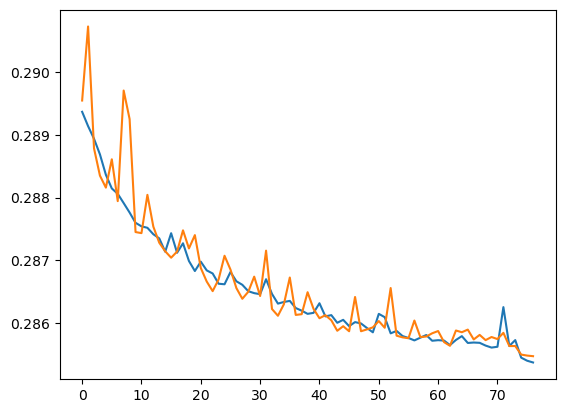

best epoch:  78


In [52]:
plt.style.use('default')

plt.plot(train_loss_list_2[3:])
plt.plot(valid_loss_list_2[3:])

plt.show()
print('best epoch: ',np.argmin(valid_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
# plt.savefig('fig1.png', dpi=300, facecolor='w')

(-0.5, 239.5, 239.5, -0.5)

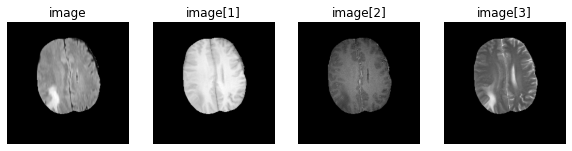

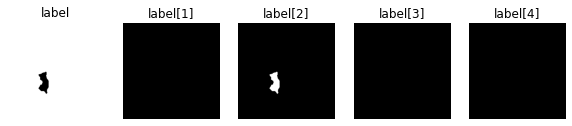

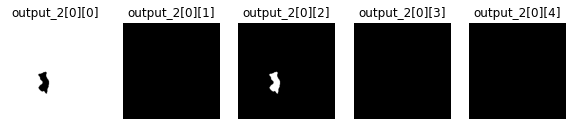

In [55]:
# image, label = next(iter(test_loader))
image, label = test_dataset.__getitem__(500)

image,label = image.unsqueeze(0).to(device),label.unsqueeze(0).to(device)

model_1= AttentionUNet_1(4,1).to(device)
model_1.load_state_dict(torch.load(f'./model/2_case_unet_ver_1.pt'))
model_2= AttentionUNet_1(4,5).to(device)
model_2.load_state_dict(torch.load(f'./model/2_case_unet_ver_2.pt'))
output =model_1(image)
output_2 = model_2(image)
check = threshold_img(output)
# check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
# output_2 = torch.concat((check,output_2),dim=1)
# check = threshold_img(output)
output_2 = output_2*check
output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()
output_2 = threshold_img(output_2)
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('image')
ax1.axis('off')
ax2.imshow(image[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('image[1]')
ax2.axis('off')
ax3.imshow(image[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('image[2]')
ax3.axis('off')

ax4.imshow(image[0][3].detach().cpu().numpy(),cmap='gray')
ax4.axis('off')

ax4.set_title('image[3]')

f, (ax1,ax2,ax3,ax4,ax5) = plt.subplots(1,5,figsize = (10,20))
ax1.imshow(label[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('label')
ax1.axis('off')

ax2.imshow(label[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('label[1]')
ax2.axis('off')

ax3.imshow(label[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('label[2]')
ax3.axis('off')

ax4.imshow(label[0][3].detach().cpu().numpy(),cmap='gray')
ax4.set_title('label[3]')
ax4.axis('off')

ax5.imshow(label[0][4].detach().cpu().numpy(),cmap='gray')
ax5.set_title('label[4]')
ax5.axis('off')

f, (ax1,ax2,ax3,ax4,ax5) = plt.subplots(1,5,figsize = (10,20))
ax1.imshow(output_2[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('output_2[0][0]')
ax1.axis('off')

ax2.imshow(output_2[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('output_2[0][1]')
ax2.axis('off')

ax3.imshow(output_2[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('output_2[0][2]')
ax3.axis('off')

ax4.imshow(output_2[0][3].detach().cpu().numpy(),cmap='gray')
ax4.set_title('output_2[0][3]')
ax4.axis('off')


ax5.imshow(output_2[0][4].detach().cpu().numpy(),cmap='gray')
ax5.set_title('output_2[0][4]')
ax5.axis('off')

# imshow2((label[0][1]+label[0][2]*2+label[0][3]*3+label[0][4]*4))
# loss_func(output_2, label)

Text(0.5, 1.0, 'label[0] reshape')

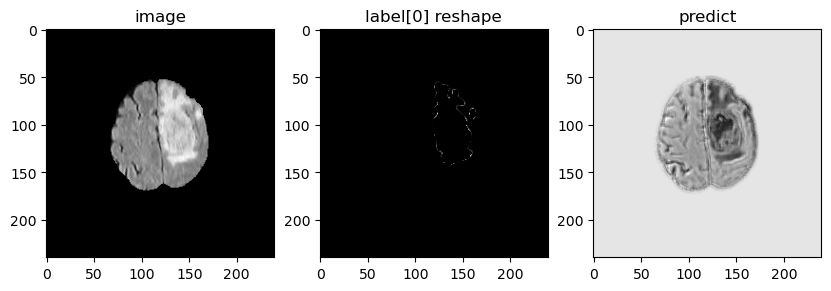

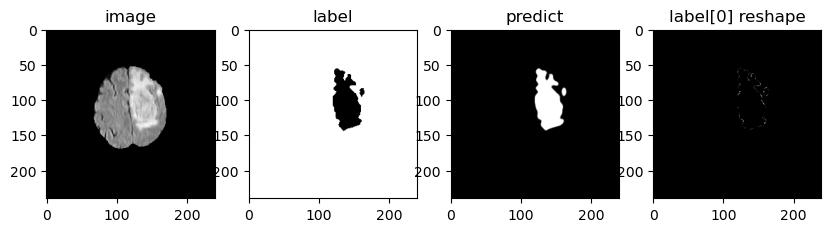

In [66]:
image , label = train_dataset.__getitem__(1200)
image, label = image.unsqueeze(0).cuda() , label.unsqueeze(0).cuda()
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_2.load_state_dict(torch.load(f'./model/{save_3}.pt'))
model_1.eval()
model_2.eval()
output = model_1(image)
la = label.clone()
l = output*label
la[:,0] = l[:,0]
output_2 = model_2(image)

##############
f, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap = 'gray')
ax1.set_title('image')
ax2.imshow(la[0][0].detach().cpu().numpy(),cmap = 'gray')
ax2.set_title('label[0] reshape')
ax3.imshow(output_2[0,0].detach().cpu().numpy(),cmap = 'gray')
ax3.set_title('predict')


# image.shape, label.shape
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap = 'gray')
ax1.set_title('image')
ax2.imshow(label[0,0].detach().cpu().numpy(),cmap = 'gray')
ax2.set_title('label')
ax3.imshow(output[0,0].detach().cpu().numpy(),cmap = 'gray')
ax3.set_title('predict')
ax4.imshow(la[0][0].detach().cpu().numpy(),cmap = 'gray')
ax4.set_title('label[0] reshape')


## Dice, Specificity, Sensitivity

In [53]:
def test_2(model_1,model_2, test_loader, loss_func,string, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label necrosis
        [1] label edema
        [2] label non-enhancing tumor
        [3] label enhancing tumor
    '''
    enhancing = 0.0 # necrosis[1] + enhanced tumor[4]
    core = 0.0      # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = 0.0  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    enhancing_real_seg = 0.0
    core_real_seg = 0.0     
    complete_real_seg = 0.0 
    
    model_1 = model_1.to(device)
    model_2 = model_2.to(device)
    model_1.load_state_dict(torch.load(f"./model/2_case_unet_ver_1.pt"))
    
    model_2.load_state_dict(torch.load(f"./model/2_case_unet_ver_4_to_4.pt"))

    model_1.eval()
    model_2.eval()
    with torch.no_grad():
        for image, label in tqdm(test_loader, leave=False):
            image,label = image.to(device),label.to(device)
            output =model_1(image)
            output_2 = model_2(image)
            check = threshold_img(output)
            check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
            output_2 = torch.concat((check,output_2),dim=1)
            output_2 = threshold_img(output_2)
        # pred = torch.topk(output_2, 1, dim=1).indices
        # target = torch.topk(label, 1, dim=1).indices
        
        en, co, com, en_real_seg, co_real_seg, com_real_seg  = loss_func(output_2.detach().cpu().numpy(), label.detach().cpu().numpy())
        
        enhancing += en
        core += co
        complete += com
        enhancing_real_seg += en_real_seg
        core_real_seg += co_real_seg
        complete_real_seg += com_real_seg
        
        
        
    enhancing, core, complete = enhancing/enhancing_real_seg, core/core_real_seg, complete/complete_real_seg
    
    return  complete, core, enhancing

In [124]:
# def calc(prediction, GT, tool = 'DICE'): 
#     # 잘 예측된 정상/실제 정상
#     pred_seg = 0.
#     real_seg = 0.
#     if tool == 'DICE':
#         pred_seg=np.sum(prediction*GT, axis=(2,3))*2
#         real_seg=np.sum(prediction, axis=(2,3)) + np.sum(GT, axis=(2,3))
#     elif tool =="Specificity":
#         pred_seg=np.sum(prediction*GT, axis=(2,3))
#         real_seg=np.sum(GT, axis=(2,3))
#     elif tool == "Sensitivity":
#         pred_seg=np.sum((prediction==0)*(GT==0), axis=(2,3))
#         real_seg=np.sum(GT==0, axis=(2,3))        
#     else: return
    
#     enhancing = np.sum(pred_seg[:, 0] + pred_seg[:, 3])                                              # necrosis[1] + enhanced tumor[4]
#     core = np.sum(pred_seg[:, 0] + pred_seg[:, 3] + pred_seg[:, 2])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
#     complete = np.sum(pred_seg[:, 0] + pred_seg[:, 1] + pred_seg[:, 2] + pred_seg[:, 3])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
#     enhancing_real_seg = np.sum(real_seg[:, 0] + real_seg[:, 3])
#     core_real_seg = np.sum(real_seg[:, 0] + real_seg[:, 2] + real_seg[:, 3])
#     complete_real_seg = np.sum(real_seg[:, 0] + real_seg[:, 1] + real_seg[:, 2] + real_seg[:, 3])

#     return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg
        

In [54]:
model_1 = AttentionUNet_1(4, 1).to(device)
model_2 = AttentionUNet_2(4,4).to(device)
dice  =dice
sen=sensitivity
spec=specificity

In [55]:
print('DICE : ', test_2(model_1,model_2, test_loader, dice,'DICE', device))
print('Specificity : ', test_2(model_1,model_2, test_loader, sen,'Specificity', device))
print('Sensitivity : ', test_2(model_1,model_2, test_loader, spec,'Sensitivity', device))

  0%|          | 0/149 [00:00<?, ?it/s]

DICE :  (0.9151627113826915, 0.80370942812983, 0.8504983388704319)


  0%|          | 0/149 [00:00<?, ?it/s]

Specificity :  (0.9435056746532157, 0.9390402075226978, 0.9798270893371758)


  0%|          | 0/149 [00:00<?, ?it/s]

Sensitivity :  (0.9995766395634683, 0.999847041646388, 0.9997895604596277)


In [17]:
def confusion_matrix(pred, target, class_name):
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    
    for i in range(len(class_name)):
        mask = target == i
        pred_mask = pred[mask]
        for j in range(len(class_name)):
            cm_pred[i, j] = torch.sum(pred_mask==j)
            cm_target[i, j] = torch.sum(mask)
            
    return cm_pred, cm_target

In [18]:
def test_confusion_matrix_2(model,model_2, test_loader, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label normal
        [1] label necrosis
        [2] label edema
        [3] label non-enhancing tumor
        [4] label enhancing tumor
    '''
    # class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']
    model = model.to(device)
    model_2 = model_2.to(device)
    model.eval()
    model_2.eval()
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output =model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
        output_2 = torch.concat((check,output_2),dim=1)
        output_2 = threshold_img(output_2)
        
        pred = torch.topk(output_2, 1, dim=1).indices
        target = torch.topk(label, 1, dim=1).indices
        
        cm_p, cm_t  = confusion_matrix(pred, target, class_name)
        cm_pred += cm_p
        cm_target += cm_t
        
    cm = np.round(cm_pred/cm_target, 2)

    return  cm

  0%|          | 0/149 [00:00<?, ?it/s]

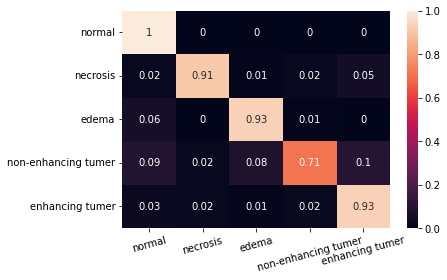

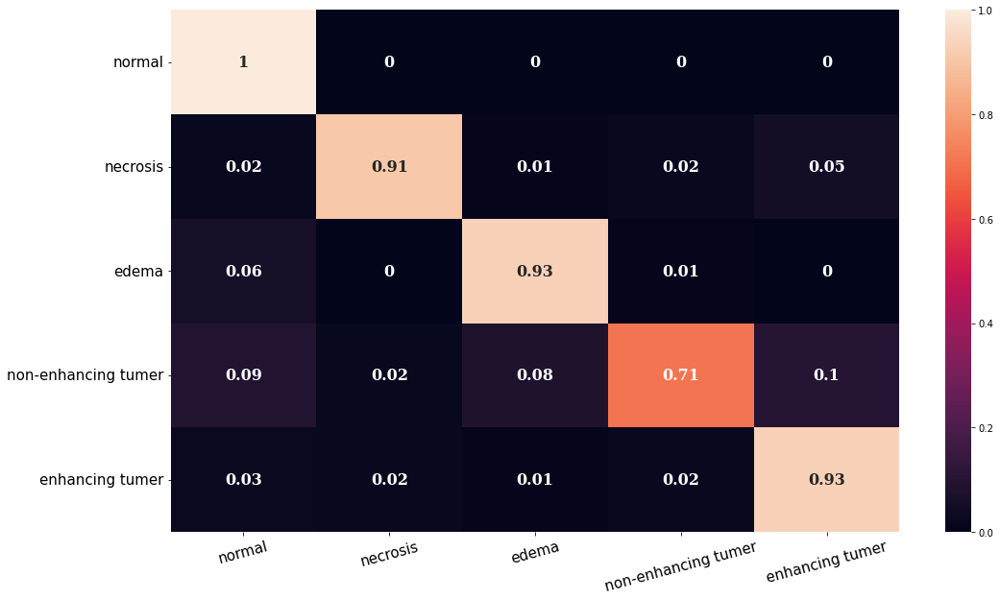

In [19]:
model_1 = AttentionUNet_1(4,1)
model_2 = AttentionUNet_2(4,4)
model_1.load_state_dict(torch.load('./model/2_case_unet_ver_1.pt'))
model_2.load_state_dict(torch.load(f"./model/2_case_unet_ver_4_to_4.pt"))


class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

cm = test_confusion_matrix(model_1,model_2, test_loader, device)

fig,ax = plt.subplots(1,1,figsize = (15,10))
ax = sns.heatmap(cm, annot=True,linewidths=0.1,fmt=".2f",annot_kws={"fontsize":25})
ax.set_yticklabels(class_name, rotation=0,fontsize =20,)
ax.set_xticklabels(class_name, rotation=10,fontsize =20)
plt.savefig('./best_confusion_matrix_2.png', dpi=200, facecolor='w',bbox_inches = 'tight')
plt.show()
# plt.show()

# 전체 데이터를 모델에 넣었을때의 결과 

In [ ]:
def Bimshowhot(img):
    plt.imshow(img, cmap=map_object, alpha=0.3) 

def Bimshow(img):
    plt.imshow(img, cmap='gray') 

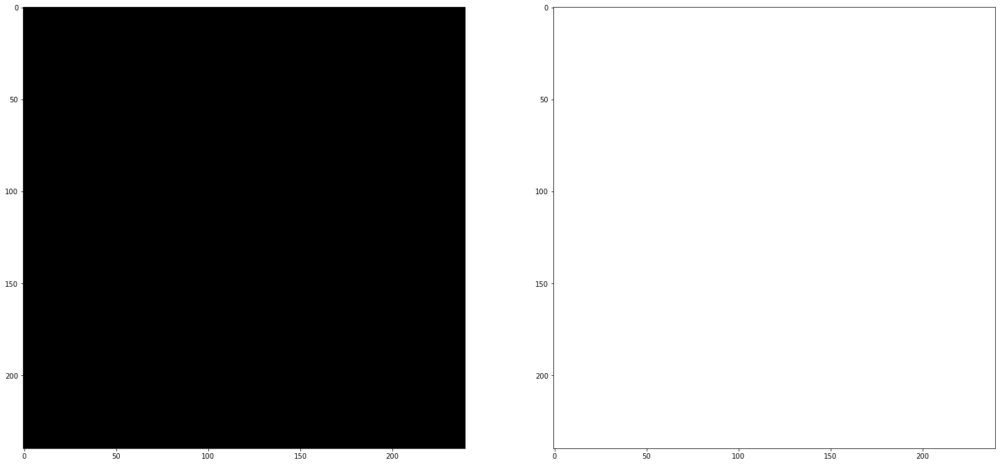

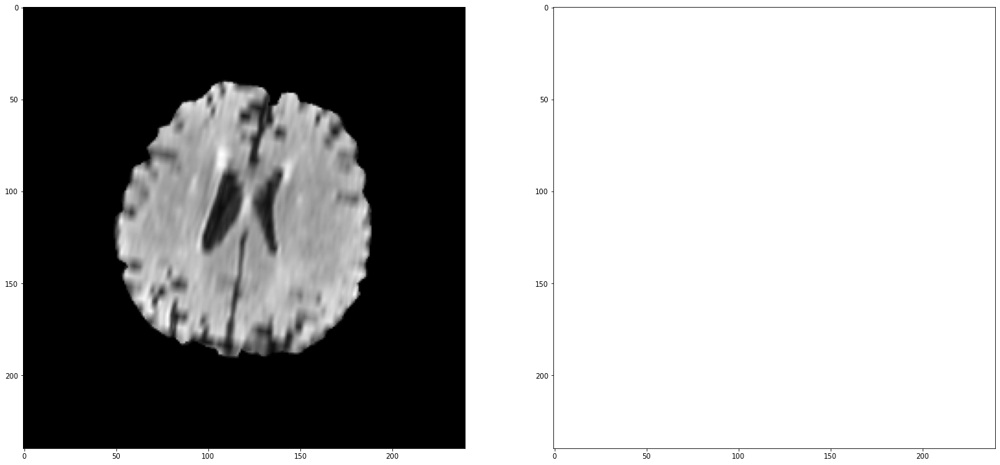

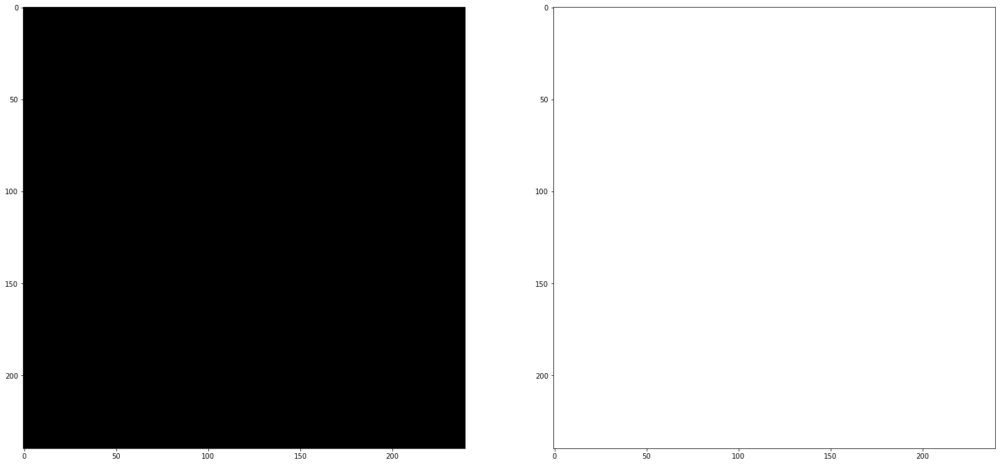

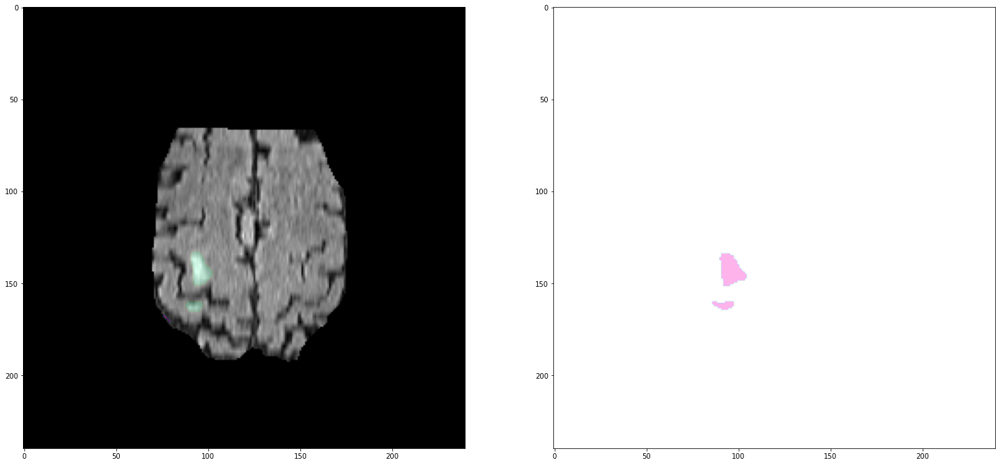

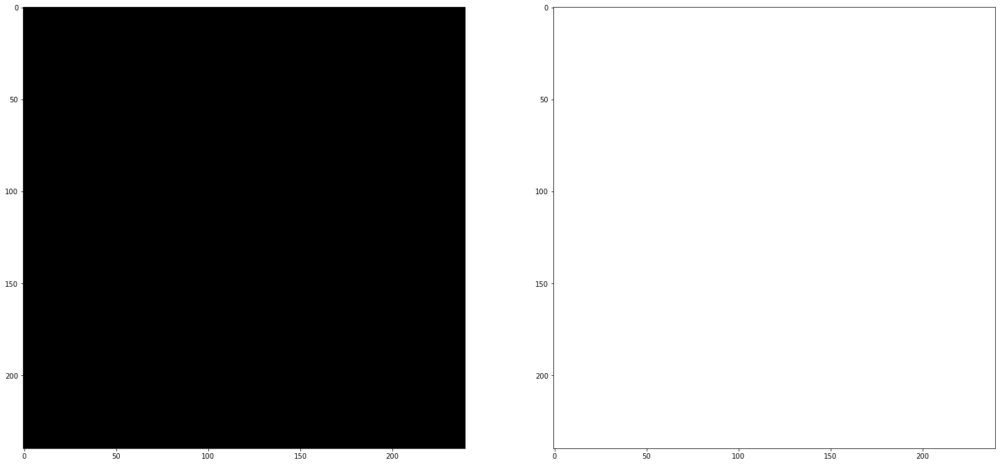

In [23]:
data, label = next(iter(test_loader))
data, label = data.to(device), label.to(device)
out = model(data)
pred = torch.topk(out, 1, dim=1).indices
target = torch.topk(label, 1, dim=1).indices

for i in range(5):
    plt.figure(figsize=(25, 25))
    plt.subplot(1,2,1)
    Bimshow(data[i][0].detach().cpu().numpy())
    Bimshowhot(pred[i][0].detach().cpu().numpy())
    plt.subplot(1,2,2)
    Bimshowhot(target[i][0].detach().cpu().numpy())
    plt.show()